
# Explainer Notebook: 
____________________________
# Exploring the Wizarding World with Network Science
### [Link to website](https://social-complexity.herokuapp.com/)
### [Data and data cleaning notebook](https://www.dropbox.com/sh/k75pd7lmcksa0m1/AABzaScsTj8tQUBVu9fBisEOa?dl=0)
<i>  <center> 
by:

Cecilia Rosdahl Lund, s174309  
Johan Møgelvang, s174328   
Siv Cartland Hansen, s174316
</i>

![HogwartsURL](https://i.gifer.com/KwJg.gif "hogwarts") 

                                                                                     


# Table of Content
1. [Motivation](#motivation)
2. [Basic statistics](#basic)
    1. [Data cleaning](#cleaning)
    2. [Exploratory analysis](#exploratory)
    3. [Network statistics](#network-stats)
3. [Tools, theory and analysis](#analysis)
    1. [Network analysis](#network-analysis)
    2. [Text analysis and wordclouds](#text-analysis)
    3. [Community detection](#communities)
    4. [Sentiment analysis](#sentiment-analysis)
    5. [Topic modelling](#topic-modelling)
4. [Discussion](#discussion)
5. [Contributions](#contributions)

### Load packages

In [55]:
# Basic libary
import pandas as pd
import numpy as np
import urllib.request
import json
import pickle
import regex as re
import random

# Network
import networkx as nx
import powerlaw
import community 
from fa2 import ForceAtlas2

# Plotting and displaying
from skimage import io
from IPython.display import IFrame, display

import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'

# nltk
import nltk
from nltk.corpus import PlaintextCorpusReader
from nltk.corpus import stopwords
from nltk import FreqDist
from nltk.stem import WordNetLemmatizer 
from nltk.tokenize import WordPunctTokenizer
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.tokenize import RegexpTokenizer
lemmatizer = WordNetLemmatizer()
nltk.download('stopwords')

# vader
import vaderSentiment
nltk.download('vader_lexicon')
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# wordclouds
from wordcloud import WordCloud
from collections import Counter

# Gensim
import gensim
from gensim.models import CoherenceModel
from gensim.models.coherencemodel import CoherenceModel
from gensim.models.ldamodel import LdaModel
from gensim.corpora.dictionary import Dictionary
from gensim.models import Phrases

# pyvis
import pyLDAvis.gensim_models
pyLDAvis.enable_notebook()
from pyvis.network import Network

# plotly
import plotly.express as px
import plotly.graph_objects as go

# warnings
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

# other
import itertools
from collections import defaultdict

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Johan\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\Johan\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


## 1. Motivation <a class="anchor" id="motivation"></a>

This project is about understanding the Wizarding World of J.K. Rowling through network science. To obtain information about the characters and their interactions, the character-pages have been downloaded from the [Harry Potter Fandom Wiki](https://harrypotter.fandom.com/wiki/Main_Page). The Harry Potter Wiki Fandom is a sprawling encyclopaedic resource that contains many details about both the characters and the books and movies themselves. In total our dataset consists of 3896 characters from both movies, books and games associated with this universe. From the character-pages we obtained attributes for each character including their <i>school-house, gender, species</i> and <i>blood-status</i>. These were chosen as they give important information about the characters and could be used to identify characteristics for different groups of characters. The main dataset can be seen below. Furthermore, a dataset with the links between all characters was created, by searching each character-page for links to other characters. Information about familial ties were also extracted from each character page.

In [2]:
df = pd.read_csv("Data_files/Data/HP_enriched_character_df.csv")
df.head(5)

,name,species,gender,house,blood
0,1992 Gryffindor vs Slytherin Quidditch match s...,unknown,unknown,unknown,unknown
1,Hannah Abbott,Human,Female,Hufflepuff,Half-blood
2,Hannah Abbott's mother,Human,Female,unknown,unknown
3,Edith Abernathy,Human,Female,unknown,unknown
4,Ernestina Abutor,Human,Female,unknown,unknown


As a secondary datasource, the dialogue for the Harry Potter movies (8 in total) and the text from the Harry Potter books (7 in total) was also collected. Using the text and movie data allows us analyse the sentiment of both books/movies and characters. These datasources were included as the wiki-pages are written in a more neutral language. Hereby, the books and movies can also better be compared in terms of both sentiment and topics. 

These dataset were chosen for two main reasons. Firstly, it allows us to explore the relationships in the wizarding world and identify central characters by examining the dataset as a social network. Secondly, the textual data allows us to dive more into the characteristics and sentiment for specific groups and characters. We can also compare the sentiment of the Harry Potter books and movies and look for temporal development as the stories progress.

The goal is allow the user to explore the network themselves and find their own insights regarding both the network and the text analysis. The website is a guide to the Wizarding World where the complexity increases step-by-step. At the end, we hope that the reader has gained a deeper understanding about the characters that inhabit the wizarding the world and how they interact with each other. The user will also have the tools to explore how the Harry Potter movies and books differ, and how both the story and the characters themselves develop.

## 2. Basic stats <a class="anchor" id="basic"></a>

This sections is split into three parts. First, our choices in data cleaning and preprocessing are explained. Then the features of the dataset are explored and lastly, the network is visualized and the statistics and characteristics of the network examined.  

### 2.1 Data cleaning and preprocessing <a class="anchor" id="cleaning"></a>

The Harry Potter Wiki-pages are edited by fans, and the data is therefore inconsistent in some areas. The character-attributes were processed to have consistent naming and remove irrelevant values. For each attribute a few examples are given below: 

* <b> Species </b>: The number of unique species was reduced from 115 to 96 by for instance renaming all plural forms to singular, e.g. <i> Owls </i> to <i> Owl </i>, and combining several dragon species into just a single species  <i> Dragon </i>. 
* <b> Blood-status </b>: There were many different ways of describing a character as non-magic (e.g. Muggle, No-Maj etc.) or pure-blood (e.g. pure, pureblood, pure-blood), so these values were all cleaned so we could easily group characters into e.g. muggles or pure-bloods. In total this reduced the unique blood-statuses from 28 to 6 (Muggle,half-blood, pure-blood, muggle-born, Squib, unknown). 
* <b> Gender </b>: This attribute was corrected by simply replacing plural forms with singular, so we only had the genders Female, Male and unknown.  

The links from the character-pages were identified by using the following regex pattern 
* ```r'\[\[(.*?)(?:\|.*?|#.*?)?\]\]'```. 
This captures all words within two square brackets ```[[]]``` and words within ```[[]]``` that are followed by ```|```, e.g. for ```[[Tom Riddle|Lord Voldemort]]``` the pattern returns *Tom Riddle*. 
Similar regex patterns were also used to collect the attributes mentioned above. 

* Species: ``` r'species\s*=\s*\[\[(.*?)(?:\|.*?)?\]\]' ```
* Gender: ``` r'gender\s*=\s*(.*?)[^\w]'```
* School house: ``` r'house\s*=\s*\[\[(.*?)[^\w]'```
* Blood status: ``` r'blood\s*=\s*\[\[(.*?)\]\]'```

The attributes and links for each character are saved as dictionaries that can be used to construct our network. The full process of collecting the character-names and extracring the links and attributes can be seen in the notebook *Data Cleaning.ipynb*.

There were also some characters in the dataset that had very vague descriptions and did not have an actual name, but was only described as e.g. <i> Aged witch </i>, <i> 1992 Gryffindor vs Slytherin Quidditch match spectators </i> or <i>Unidentified Obliviator</i>. They are clearly people who fans have identified in the movies or books, but which have only been mentioned briefly in the source material. These characters could have been removed to only have more interesting characters with more details, but it was chosen to keep them in our dataset. These characters still had their own character-page and had links to some of the major characters, so removing might delete interesting links in the network. It would also be difficult to draw the line regarding which characters to keep, i.e. when is a character 'important' enough to remain in our dataset. Due to these reasons, only very few characters were removed as there were issues with the data (e.g. two character had either *Hogwarts* or *Snatchers* as a school-house).  


### 2.2 Exploratory analysis <a class="anchor" id="exploratory"></a>
To get an overview of our main dataset, some basic statistics about our dataset are examined. It can be seen that the dataset consists of 3916 different characters that belong to 96 different species. There are more male characters than female in our dataset, and approximately 3/4 of our characters do not have any known blood-status or school-house associated with them. This is as expected, as only characters that play are larger role in either books, movies or games are described thouroughly enough to have these characteristics listed on the wiki-pages. However, there are still many valuable insights to be learned from these features. 



In [3]:
df.describe()

,name,species,gender,house,blood
count,3916,3916,3916,3916,3916
unique,3916,96,3,9,6
top,Zelda Hum,Human,Male,unknown,unknown
freq,1,3370,2271,3026,2839


The features can be examined further by calculating the distribution for each feature. Hereby, it can be seen e.g. which are the most common species in the wizarding world and how many characters that belong to each school-house. 

Note that only the top 10 most common species are shown below. 

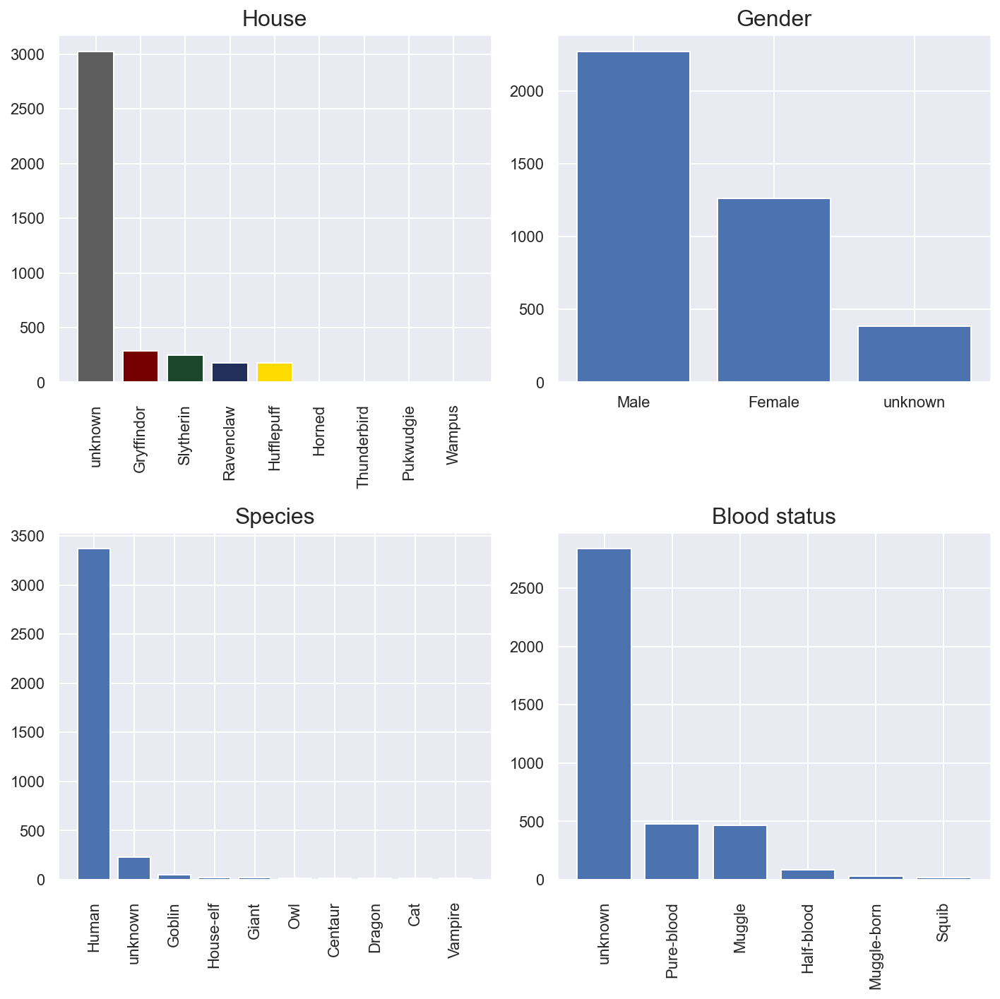

In [21]:
# Calculate distribution for features 
gender_freq = df.gender.value_counts()
species_freq = df.species.value_counts()
house_freq = df.house.value_counts()
blood_freq = df.blood.value_counts()

# For species only display the top 10 species
species_freq = species_freq[0:10]

# Visualize
import seaborn as sns
sns.set()
fig, axs = plt.subplots(2, 2, figsize=(10,10))
clrs = ['#5D5D5D', '#740001','#1A472A',"#222F5B","#FFDB00", "#C0C0C0"]
axs[0, 0].bar(house_freq.index,house_freq, color = clrs)
axs[0, 0].set_title("House", size = 16)
axs[0, 0].tick_params(axis = 'x', rotation = 90, size = 12)
axs[1, 0].bar(species_freq.index,species_freq)
axs[1, 0].set_title("Species", size = 16)
axs[1, 0].tick_params(axis = 'x', rotation = 90, size = 12)
axs[0, 1].bar(gender_freq.index, gender_freq)
axs[0, 1].set_title("Gender", size = 16)
axs[1, 1].bar(blood_freq.index,blood_freq)
axs[1, 1].set_title("Blood status", size = 16)
axs[1, 1].tick_params(axis = 'x', rotation = 90, size = 12)
fig.tight_layout()

It can be seen that Gryffindor is the most frequent house (disregarding the characters with no house). This is closely followed by the other Hogwarts houses, Slytherin, Ravenclaw and Hufflepuff. This makes sense as the main characters of the Harry Potter series are all Gryffindors (Ron, Hermione and Harry) while the main antagonist is Slytherin (Voldemort). There are also many important characters from Ravenclaw and Hufflepuff, the latter including the protagonist of the Fantastic Beasts movies, Newt Scamander. It can also be seen that the Wizarding World is a quite male-dominated universe with only around 1/3 of characters being female. Furthermore, the Wizarding World mostly focuses on the wizards and muggles, so it makes sense that the most frequent species is *human* folllowed by *Goblin* and *House-elf*. There are also some major characters from these last two species, for example Dobby the house-elf who plays a large role in both the Harry Potter books and movies, and the Goblin Griphook, who helps Harry Potter find a horcrux in the last book. In the Fantastic Beast movies many new species are introduced through the protagonist's (Newt Scamander) interest in magical beasts. This results in a very long list of species in this universe.  

Surprisingly, there are almost as many *muggles* (non-magic characters) as pure-bloods (wizards coming from two wizarding parents) in the dataset. However, there are quite a few non-magic characters in the Harry Potter series such as Harry Potter's uncle and aunt, and especially in the Fantastic Beasts movies there are several muggles in central positions. There are very few *Muggle-borns* (wizard born to non-magic parents) and *squibs* (character born from a wizard family but with no magical ability of their own), but these are quite rare, so this makes sense. 

### 2.3. Network statistics <a class="anchor" id="network-stats"></a>

The network can now be created from the dataset. Each character is represented as a node and the links between characters are determined by finding the links between the characters' wiki-pages. 

#### Create network 
The links and attributes for all characters have been saved in json-files, which can be used to construct the full network. 

In [5]:
with open('Data_files/Data/Network/attributes.json') as json_file:
    attributes = json.load(json_file)

with open('Data_files/Data/Network/links.json') as json_file:
    links = json.load(json_file)

# add nodes and edges from dictionary 
G = nx.DiGraph(links)

# add node attributes
nx.set_node_attributes(G, attributes)

It can be seen that the full network has 18918 connections in total, and that each character on average has around 10 connections to other characaters. However, it can be seen that almost 1/5 of the characters in the network do not have any connections to other characters as they are isolated nodes. 

In [6]:
pd.DataFrame({"Nodes":[G.number_of_nodes()], 
              "Edges": [G.number_of_edges()], 
              "Isolated nodes": [len(list(nx.isolates(G)))],
              "Average degree": [np.round(np.mean(list(dict(G.degree).values())),2)],
              "Average clustering coefficient": [np.round(nx.average_clustering(G),2)]
              }, index = ["Full network"])

,Nodes,Edges,Isolated nodes,Average degree,Average clustering coefficient
Full network,3916,18918,822,9.66,0.32


##### Extracting the Giant Connected Component (GCC)
The GCC is extracted for further analysis. It can be seen in the table below that this network only consists of 2765 characters, but that almost all edges from the full network have been retained in the GCC. This indicates that there are only few, quite sparse components other than the GCC. In this subgraph the average number of connections per character is naturally higher and the clustering coefficient larger as well. 

In [7]:
# Find largest connected component in graph 
gcc = max(nx.weakly_connected_components(G), key = len)

# Define the largest connected component (gcc) as a graph 
GCC = G.subgraph(gcc)

# Show stats
pd.DataFrame({"Nodes":[GCC.number_of_nodes()], 
              "Edges": [GCC.number_of_edges()], 
              "Isolated nodes": [len(list(nx.isolates(GCC)))],
              "Average degree": [np.round(np.mean(list(dict(GCC.degree).values())),2)],
              "Average clustering coefficient": [np.round(nx.average_clustering(GCC),2)]
              }, index = ["GCC"])

,Nodes,Edges,Isolated nodes,Average degree,Average clustering coefficient
GCC,2765,18476,0,13.36,0.43


##### Examining the most connected characters
By examining the number of edges for the different characters, we can get an indication of who are the most central character in the Wizarding World. Below the top 10 characters by in- and out-degree are shown. 

In [8]:
# get the in and out degrees
in_degrees = sorted([(i, GCC.in_degree(i)) for i in GCC.nodes()], key=lambda x: x[1], reverse=True)
out_degrees = sorted([(i, GCC.out_degree(i)) for i in GCC.nodes()], key=lambda x: x[1], reverse=True)

# Visualize top 10
pd.DataFrame({"In-degree":[str(tup[0])+": "+str(tup[1]) for tup in in_degrees[0:10]],
            "Out-degree": [str(tup[0])+": "+str(tup[1]) for tup in out_degrees[0:10]]} 
            , columns = ["In-degree", "Out-degree"], index = range(1,11))

,In-degree,Out-degree
1,Harry Potter: 802,Harry Potter: 196
2,Tom Riddle: 451,Albus Dumbledore: 191
3,Ronald Weasley: 360,Ronald Weasley: 150
4,Hermione Granger: 346,Jacob's sibling: 147
5,Albus Dumbledore: 322,Hermione Granger: 135
6,Rubeus Hagrid: 199,Tom Riddle: 134
7,Severus Snape: 192,Ginevra Weasley: 106
8,Sirius Black: 191,Minerva McGonagall: 104
9,Minerva McGonagall: 169,Severus Snape: 101
10,Draco Malfoy: 168,Draco Malfoy: 93


Not surprisingly, the most connected characters are the characters central to the Harry Potter series. The main character Harry Potter has the highest number of connections by both in- and out-degree. The most evil wizard, Tom Riddle (Voldemort) has the second-highest in-degree. A lot of other characters clearly references him, which makes sense as many characters either serve him or try to defeat him. 

The only 'outlier' here is the character *Jacob's sibling*. This is not a character from the Harry Potter series, but from the video game *Hary Potter: Hogwarts Mystery* which takes place at Hogwarts before the time of Harry Potter. The player can choose the name, gender and house of their character who has a sibling at Hogwarts called Jacob, and is therefore just referred to as *Jacob's sibling*. This is an interesting discovery as it shows that this game is also big in the Harry Potter fandom, since the wiki-page is so well-developed. 

##### Visualize networks
To visualize the graph, the nodes are assigned a color based on which Hogwarts-house they are part of. Characters who do not have a house associated with them or belong to one of the American houses (<i>Thunderbird, Pukwudgie, Horned</i> and <i>Wampus</i>) are all colored grey. 

In [9]:
# Colormaps
house_col_map = {'Hufflepuff': "#FFDB00",
           'Slytherin': '#1A472A',
           'Gryffindor': '#AE0001',
           'Ravenclaw':'#222F5B',
           'Thunderbird':'grey',
           'Pukwudgie':'grey',
           'Horned':'grey',
           'Wampus':'grey'}

house_secondary_col_map = {'Hufflepuff': '#60605C',
           'Slytherin': '#AAAAAA',
           'Gryffindor': '#EEBA30',
           'Ravenclaw':'#946B2D',
           'Thunderbird':'darkgrey',
           'Pukwudgie':'darkgrey',
           'Horned':'darkgrey',
           'Wampus':'darkgrey'}

# get node colours
def get_house_colours(G):
    '''
    Input: networkx graph
    Output: dictionaries with node colour and edge colours
    
    The function takes a graph as input and it assignes the node colour based on the house-feature'
    '''
    node_att = {}

    for u, a in list(G.nodes(data = True)):
        if (a['house'] == 'Hufflepuff'): 
            node_col = house_col_map['Hufflepuff']
        
        elif (a['house'] == 'Slytherin'):
            node_col = house_col_map['Slytherin']
                
        elif (a['house'] == 'Ravenclaw'):
            node_col = house_col_map['Ravenclaw']
        
        elif (a['house'] == 'Gryffindor'):
            node_col = house_col_map['Gryffindor']

        else:
            node_col = 'grey'

        node_att[u] = {'color': node_col}  
    
    return node_att 

# Set attribute for both full network and GCC
nx.set_node_attributes(G, get_house_colours(G))
nx.set_node_attributes(GCC, get_house_colours(GCC))

The full network and the GCC are plotted using ```Pyvis```. The size of the nodes indicate the degree (i.e. the number of connections) for the character. This is scaled as the difference between the characters is so large. The visualizations can be seen below. By clicking on a node, the connection are highlighted and it is possible to see the features for that character. 

In [103]:
# normalise the size of the nodes
def normalize(x, min_, max_, a, b):
    return (b-a)*((x-min_)/(max_-min_))+a

def format_nx_graph_to_pyvis(graph):
    # Scale node size based on degree
    a = 20
    b = 300
    degrees = dict(graph.degree)
    min_ = np.min(list(degrees.values()))
    max_ = np.max(list(degrees.values()))
    degrees.update((key, normalize(value, min_,max_,a,b)) for key, value in degrees.items())
    nx.set_node_attributes(graph, degrees, 'size')


    # Set edge colors 
    edge_color = {edge:'lightgrey' for edge in graph.edges}
    nx.set_edge_attributes(graph, edge_color, "color")

    # Set titles (this is the label displayed when chosing a node) 
    titles = {}
    for name, data in graph.nodes(data = True):
        title = "<b>" + name + "</b>" +' </br>House: ' + data['house'] +' </br>Gender: ' + data['gender'] + ' </br>Species: ' + data['species'] + ' </br>Bloodstatus: ' + data['blood']
        titles[name] = title
    nx.set_node_attributes(graph, titles, 'title')

    return graph 

GCC = format_nx_graph_to_pyvis(GCC)
G = format_nx_graph_to_pyvis(G)


In [11]:
# plot the network
G_nt = Network(notebook = True,
            height='800px',
            width='100%', 
            bgcolor='white', 
            font_color='black',  
            heading='Full network containing {} nodes and {} edges'.format(G.number_of_nodes(), G.number_of_edges())
            )

G_nt.from_nx(G)

G_nt.force_atlas_2based(overlap = 0,
                     gravity = -120, 
                     central_gravity = 0.01,
                     damping = 1, 
                    spring_length = 600, 
                    spring_strength = 0.02
                     )

G_nt.set_edge_smooth('curvedCW') # Curve edges 

# Save graph (already done)
#G_nt.save_graph('Data_files/Data/Network/G.html')

# As pyvis does not display the graph offline, the graph is saved and displayed using python's IFrame
# G_nt.show('G.html' )

In [12]:
# Display figure
display(IFrame('Data_files/Data/Network/G.html', 600, 650))

In [13]:
GCC_nt = Network(notebook = True,
            height='800px',
            width='100%', 
            bgcolor='white',    
            font_color='black',   
            heading='GCC containing {} nodes and {} edges'.format(G.number_of_nodes(), G.number_of_edges())
            )

GCC_nt.from_nx(GCC)

GCC_nt.force_atlas_2based(overlap = 0,
                     gravity = -111, 
                     central_gravity = 0.02,
                      spring_length =75,
                      spring_strength =0.025, 
                     damping = 1, 
                     )

GCC_nt.set_edge_smooth('curvedCW') # Curve edges 

# Save graph (already done)
#GCC_nt.save_graph('Data_files/Data/Network/GCC.html')

# As pyvis does not display the graph offline, the graph is saved and displayed using python's IFrame
# GCC_nt.show('GCC.html' )

In [14]:
# Display
display(IFrame('Data_files/Data/Network/GCC.html', 600,650))

From the graph above it can be seen that the central red node is <i>Harry Potter</i>, the main character of the Harry Potter series. Around Harry there are three large red nodes: <i>Albus Dumbledore, Ron Weasley</i> and <i> Hermione Granger</i>. These characters are also the people closest to Harry through the series with many sidestories of themselves, and it therefore makes sense that they have a large node size and are located close to Harry. Furthermore, there is a green node next to Harry Potter. This node represents <i> Voldemort/ Tom Riddle </i>. As Voldemort is the antagonist in the Harry Potter series, it makes sense that he has a large and central node in the network. 

Furthermore, it can be seen that the largest yellow node (Hufflepuff house) is Newt Scamader, who is one of the main characters in the Fantastic Beasts series. He has a less central position in the graph as he has few ties to the Harry Potter universe, and no connection to Harry Potter. 

##### Degree distribution
The degree distribution is a central characteristic of the network and shows the probability distribution of the degrees over the network. Here we calculate it for the GCC as the full network will have many observations with degree 0. 

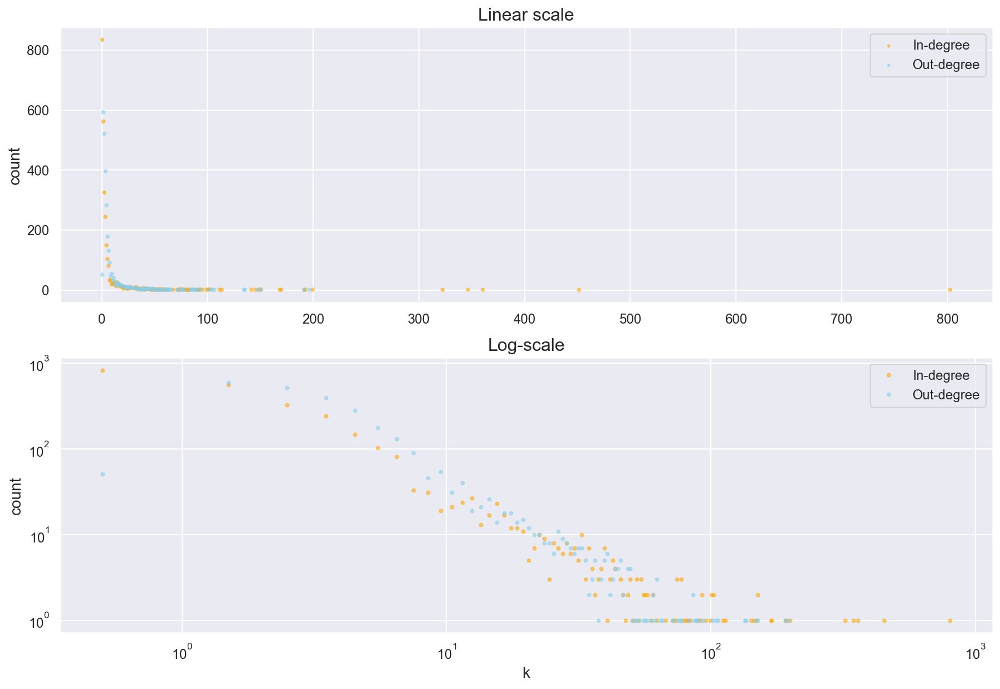

In [22]:
# Define function to create integer bins 
def binning_distribution(values):
    '''
    Input: An array of the values which should be binned
    Output: histogram (frequency) values, centered bin edges 
    '''
    hist, bins = np.histogram(values, bins = np.arange(np.min(values), np.max(values) + 2))
    centered_bins = (bins[:-1] + bins[1:]) / 2

    return hist, centered_bins

# Compute histogram values and bins for the in- and out-degrees
in_degree_vals = [val for n,val in in_degrees]
out_degree_vals = [val for n,val in out_degrees]
hist_in, centered_in = binning_distribution(in_degree_vals)
hist_out, centered_out = binning_distribution(out_degree_vals)

# Adjust size of nodes (set it to zero if the hist-value is 0 i.e. there is no observation here)
marker_size_in = [8 if val>0 else 0 for val in hist_in]
marker_size_out = [8 if val>0 else 0 for val in hist_out]

# Visualize
plt.figure(figsize = (15, 10))
plt.subplot(211)
plt.scatter(centered_in, hist_in, s = marker_size_in, color = 'orange', alpha = 0.5, label = 'In-degree')
plt.scatter(centered_out, hist_out, s = marker_size_out, color = 'skyblue',alpha = 0.5, label = 'Out-degree')
plt.ylabel("count", fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)
plt.title("Linear scale", fontsize = 16)
plt.legend(fontsize = 12)
plt.subplot(212)
plt.loglog(centered_in, hist_in, '.', color = 'orange',alpha = 0.5, label = 'In-degree')
plt.loglog(centered_out, hist_out, '.', color = 'skyblue',alpha = 0.5, label = 'Out-degree')
plt.ylabel("count", fontsize = 14)
plt.xlabel("k", fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)
plt.legend(fontsize = 12)
plt.title("Log-scale", fontsize = 16)
plt.show()

The distributions of the in- and out-degree look very similar apart from the few nodes with very high in-degree, such as Harry Potter and Voldemort. 

The in- and out-degree distributions show that the network appears to have scale-free properties. To explore this further, the degree distribution for the GCC is visualized along side a random ER-network with the same number of nodes and probability *p* of connections. 

##### Comparison to random network
To create the appropriate random network the probability *p* is derived using equation 3.3 from Network Science. 

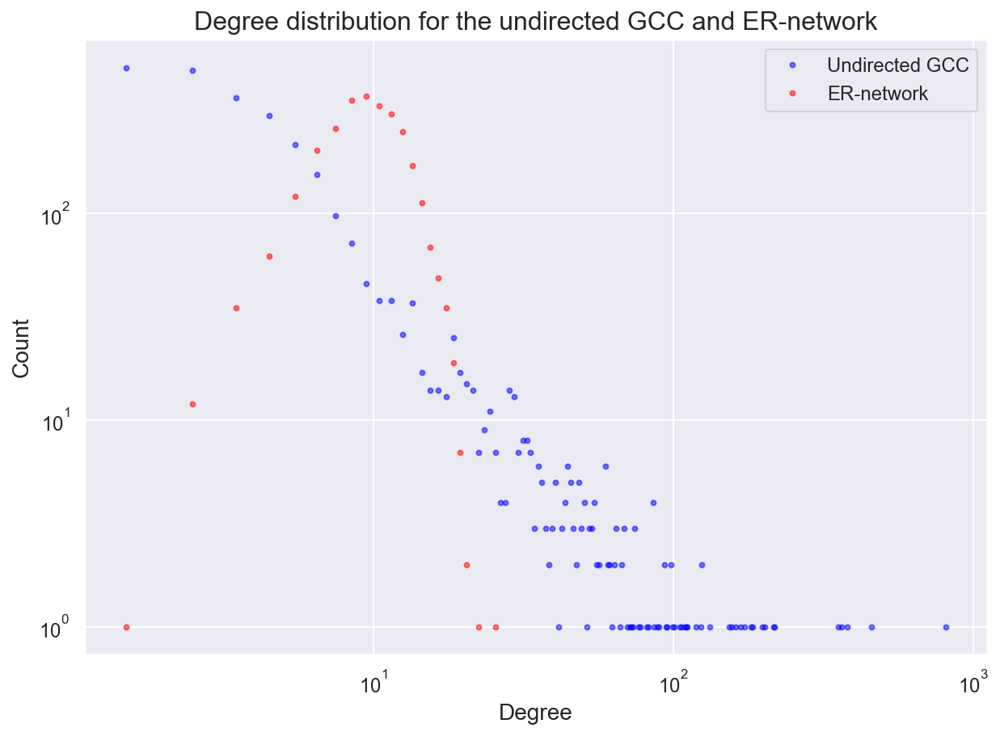

In [105]:
# Transform GCC to undirected graph and get the degrees for the nodes
GCC = GCC.to_undirected()
degrees = [GCC.degree(i) for i in GCC.nodes()]

# number of nodes
N = GCC.number_of_nodes()
# average degree
k = np.mean(degrees)
# probability connection
p = k/(N-1)

# create the ER network with the same N and p as the GCC
ER = nx.erdos_renyi_graph(N, p)
ER_degrees = [ER.degree(n) for n in ER.nodes()]

# Bin the degree distributions
hist_gcc, centered_gcc = binning_distribution(degrees)
hist_er, centered_er = binning_distribution(ER_degrees)

# Visualize
plt.figure(figsize = (10,7))
plt.loglog(centered_gcc, hist_gcc, '.', color = 'blue',alpha = 0.5)
plt.loglog(centered_er, hist_er, '.', color = 'red',alpha = 0.5)
plt.legend(["Undirected GCC","ER-network"], fontsize = 12)
plt.xlabel("Degree", fontsize = 14)
plt.ylabel("Count", fontsize = 14)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)
plt.title("Degree distribution for the undirected GCC and ER-network", fontsize = 16)
plt.show()

It can be seen that the GCC does not resemble a random network. The degree distribution of the ER-network is a Poisson distribution with the most frequent degree around 10. The GCC has more nodes with very low and very high degree, indicating that there are some hubs (like Harry Potter) with an extremely high number of connections.  

##### Examining the powerlaw
Both the in- and out-degree distributions seem to resemble a power-law distribution. The exponents of the degree distributions are therefore computed.


C:\Users\Johan\anaconda3\lib\site-packages\powerlaw.py:699: RuntimeWarning: invalid value encountered in true_divide
  (CDF_diff**2) /
C:\Users\Johan\anaconda3\lib\site-packages\powerlaw.py:699: RuntimeWarning: invalid value encountered in true_divide
  (CDF_diff**2) /


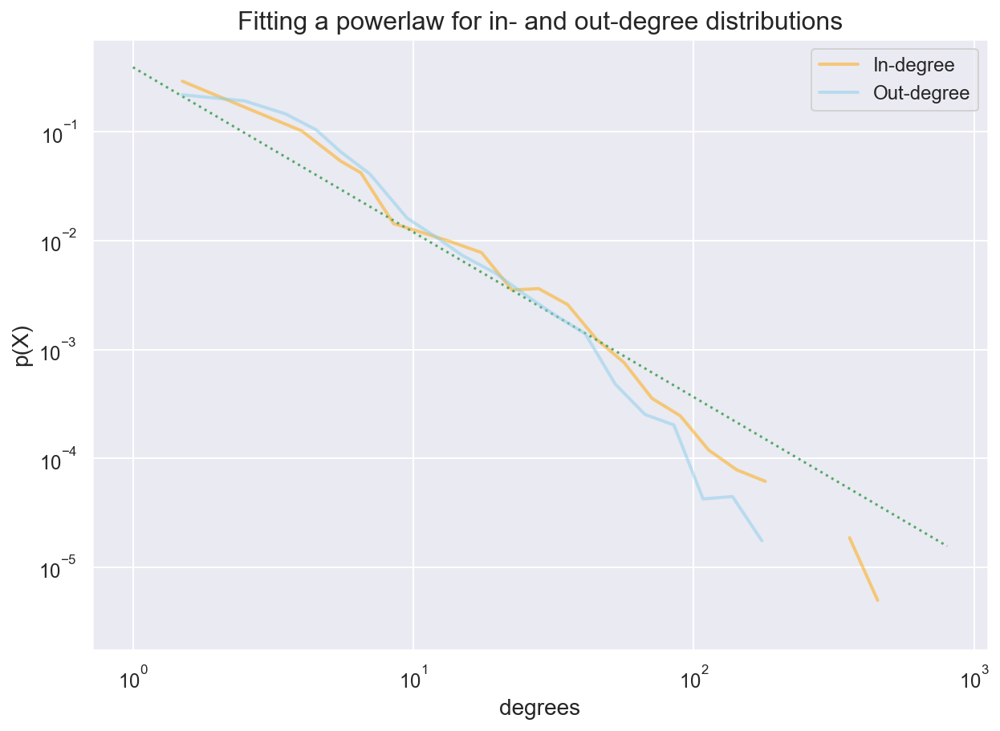

In [27]:
#Fit and visualize
plt.figure(figsize = (10, 7))

in_degree = [x for x in in_degree_vals if not x == 0]
out_degree = [x for x in out_degree_vals if not x == 0]
fig = powerlaw.plot_pdf(in_degree, color='orange', alpha = 0.5, linewidth=2, label="In-degree")
fit = powerlaw.Fit(in_degree, xmin=1, discrete=True)

fit.power_law.plot_pdf(linestyle=':', color='g')
powerlaw.plot_pdf(out_degree,  color='skyblue', alpha = 0.5, linewidth=2, label='Out-degree')
fit = powerlaw.Fit(out_degree, xmin=1, discrete=True)
plt.legend(loc="upper right", fontsize = 12)
fig.set_ylabel("p(X)", fontsize = 14)
fig.set_xlabel(r"degrees", fontsize = 14)
fig.set_title("Fitting a powerlaw for in- and out-degree distributions", fontsize = 16)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)
plt.show()

It can be seen that the distributions of the in- and out-degree follow the theoretical distribution of the powerlaw quite well with some deviation in the tails of the distribution. 

In [28]:
print("The exponent of the in-degrees:  {}".format(powerlaw.Fit(in_degree, discrete = True).alpha))
print("The exponent of the out-degrees: {}".format(powerlaw.Fit(out_degree, discrete = True).alpha))

The exponent of the in-degrees:  2.4916356798910826
The exponent of the out-degrees: 2.1049131485945898


Calculating best minimal value for power law fit
Calculating best minimal value for power law fit
C:\Users\Johan\anaconda3\lib\site-packages\powerlaw.py:699: RuntimeWarning: divide by zero encountered in true_divide
  (CDF_diff**2) /


The estimate for the exponent for the in-degrees is slightly higher than that of the out-degrees. But both exponents $\gamma_{in}$ and $\gamma_{out}$ are in the interval $2 < \gamma < 3$ which indicates that the network is in the scale-free regime (Network Science, section 4.7). Scale-free networks in this regime are ultra-small networks, meaning that the average distance grows quite slowly as there are many hubs linking to the low degree nodes thus reducing the distance (Network Science, section 4.6). 

This fits well with what we see in the visualization of the GCC. A few large nodes such as Harry Potter, Ron, Hermione, Voldemort and so on have a very high degree, and many of the small, low-degree nodes are connected to these hubs. 

##### Summary
Overall, it can be seen that the social network created for the Wizarding World resembles a real-world network with a few highly connected characters. By visualizing the network, it could be seen that the main characters in the Harry Potter universe are also the most connected characters in the network for the whole wizarding world. So even though we have included characters from side stories and video games related to the wizarding world, the Harry Potter universe is the most central part of the network. The only exception was a character from the videogame *Harry Potter: Hogwarts Mystery*, but examining the connections for this character, it could be seen that this person is connected to many of the characters from the Harry Potter series, that were at Hogwarts before the time of Harry Potter, e.g. Dumbledore and Hagrid.  

## 3. Tools, theory and analysis <a class="anchor" id="analysis"></a>

### 3.1 Network Analysis <a class="anchor" id="network-analysis"></a>

After the exploratory analysis, we want to dive even deeper into the social network of Harry Potter. 
We will do this in a number of different ways, starting by introducing a new way to link the nodes:

#### The family graph

The wizarding world puts a lot of emphasis on the families of the characters. Are they part of a proud pure-blood family, or do they come from a family that puts wizard and muggle blood on equal footing? No matter the stance of a character, the family they hail from shapes them in some capacity.

To analyze this further, we have created a new graph. The nodes are still representing each character, but the links are now found not by what characters reference each other, but by their family description.

The family relationships are found under each character on their wiki page, so a new regex pattern for scraping this information, has to be made. We have defined it as follows:


In [29]:
def get_family_links(text, name, names):
    links = []
    family_pattern = "(family = (.*?\\')\|)"
    family = re.finditer(family_pattern, text, re.MULTILINE)
    family = next(family).group()
    individual_pattern = '\[\[(.*?)(?:\|.*?|\#.*?)?\]\]'
    family_members = re.findall(individual_pattern, family)

    for member in family_members:
        if (member in names) & (member != name):
            links.append(member)

    # return unique links
    return list(np.unique(links))         

In [30]:
all_names = df.name.values
family_links = {}
mssin_cnt = 0
for name in all_names:
    try:
        name_ = name.replace(' ', '_')
        with open("Data_files/Characters/"+ name_ +".txt") as f:
            text = str(f.readlines())
        family_links[name] = get_family_links(text, name, all_names)
    except: 
        mssin_cnt += 1
print('{} entries with zero familial ties'.format(mssin_cnt))
print('{} entries left in the graph'.format(len(all_names) - mssin_cnt))

1700 entries with zero familial ties
2216 entries left in the graph


A new graph can now be created based on the links found above. Each character still has the same features as in the original network, but there are of course fewer nodes and links than in the full network as not all characters will have family ties registered in the wiki pages. 

In [31]:
G = nx.Graph(family_links)
nx.set_node_attributes(G, attributes)
nodes_w_family_links = [x for x in G.nodes if not x in nx.isolates(G)]
G_w_family_links = G.subgraph(nodes_w_family_links)

# Show number of nodes and edges and average degree
pd.DataFrame({"Nodes":[G_w_family_links.number_of_nodes()], 
              "Edges": [G_w_family_links.number_of_edges()], 
              "Average degree": [np.round(np.mean(list(dict(G_w_family_links.degree).values())),2)],
              }, index = ["Family network"])

,Nodes,Edges,Average degree
Family network,994,1384,2.78


Having created the new family graph, we can now begin to visualize the network in a whole new way.
We start by exploring what the house distribution of our new graph is, to see how this has changed. 

In [32]:
cyto_family_json = nx.cytoscape_data(G_w_family_links)['elements']

bar_list = []
for node in cyto_family_json['nodes']:
    bar_list.append(node['data']['house'])

### COUNT THE FREQUENCIES ###

frequency = {}
# iterating over the list
for item in bar_list:
   # checking the element in dictionary
    if item in frequency:
        frequency[item] += 1
    else:
        frequency[item] = 1

### HOUSE COLORS ###

colors = ['Grey'] * len(frequency.keys())
for i, color in enumerate(colors):
    house = list(frequency.keys())[i]
    if house == 'unknown':
        colors[i] = "#800080"
    elif house == 'Slytherin':
        colors[i] = "#1A472A"
    elif house == "Hufflepuff":
        colors[i] = "#FFDB00"
    elif house == "Ravenclaw":
        colors[i] = "#0E1A40"
    elif house == "Gryffindor":
        colors[i] = "#740001"

### PLOTTING ###
        
plt = px.bar(x=frequency.keys(),y=frequency, color=colors, color_discrete_map="identity", template='simple_white')


We see that the distribution is still somewhat the same, with the unkown category (primarily muggles) being the largest group, and the two houses Gryffindor and Slytherin making out to be about 10% the size of the unkown category. The two less encountered houses, Hufflepuff and Ravenclaw, also keep their proportion, being about 50% of the two other houses.

This begs the question, do families usually only contain the same house?

In [34]:

dic = {}
for item in ['unknown',
 'Hufflepuff',
 'Slytherin',
 'Gryffindor',
 'Ravenclaw',
 'Thunderbird',
 'Horned',
 'Wampus']:
    dic[item] = []

for node in G_w_family_links.nodes:
    node_distribution = []
    house_of_node = G_w_family_links.nodes(data=True)[node]['house']
    for target in G_w_family_links[node].keys():
        if house_of_node == G_w_family_links.nodes(data=True)[target]['house']:
            node_distribution += [1]
        else:
            node_distribution += [0]
    
    
    dic[house_of_node].append(sum(node_distribution)/len(node_distribution))

for item in dic:
    dic[item] = sum(dic[item]) / len(dic[item])

In [42]:
pd.DataFrame.from_dict({'houses':dic.keys(), 'Percentage of family from the same house':dic.values()})

,houses,Percentage of family from the same house
0,unknown,0.800443
1,Hufflepuff,0.283550
2,Slytherin,0.217532
3,Gryffindor,0.328036
4,Ravenclaw,0.024510
5,Thunderbird,0.000000
6,Horned,0.000000
7,Wampus,0.000000


If we do not count the unknown category, we unsupringly find that people from Slytherin are most likely to be in family with other Slytherins.
This aligns very well with the percieved idea, that Slytherins are more likely to be proud of keeping their blood line "clean". 
The house least likely to have individuals from the same family-house, is Ravenclaw. It is however also a house with fewer observation, so its statistics are more likely to be more extreme. 

Now we will take a quick look at the centrality of the graphs, using eigenvector centrality, and betweness centrality as meassures. Eigenvector centrality measures a node's importance and is high if a node is connected to many high-connected nodes (rather than just being connected to many nodes with few connections). Betweeness centrality is based on the shortest paths in the network, and is high for nodes that have more control over the flow in the network, i.e. connect many other nodes. 

In [43]:
bc = nx.betweenness_centrality(G_w_family_links)
ec = nx.eigenvector_centrality(G_w_family_links)
for node in cyto_family_json['nodes']:
    node.update({'classes': node['data']['house']})
    node['data']['ec'] = ec[node['data']['id']]
    node['data']['bc'] = bc[node['data']['id']]

ec = []
bc = []
names = []
for node in cyto_family_json['nodes']:
    ec.append(node['data']['ec'])
    bc.append(node['data']['bc'])
    names.append(node['data']['id'])

In [48]:
from plotly.subplots import make_subplots
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Bar(x=names,y=ec, name="Eigenvector centrality"),
    secondary_y=False,
)

fig.add_trace(
    go.Bar(x=names,y=bc, name="Betweenness centrality"),
    secondary_y=True,
)


fig.update_xaxes(showticklabels=False)
fig.update_yaxes(title_text="<b>Eigenvector centrality</b> ", secondary_y=False)
fig.update_yaxes(title_text="<b>Betweenness centrality</b>", secondary_y=True)
fig.update_layout(barmode='group')

As expected, it can be seen how most characters have correlating centrality meassures. 
The betweenness centrality is overall quite low, which makes sense in the family network, as there are a lot of disconnected graph components.
The eigenvector centrality is also on the lower side owing to the same reason.  

### Interactivity 


The website employs a lot of tools to allow the user to interact with the tools and visualizations. 
In this case we have used the dashboard tool of Dash to implement the interactive graph.

The family graph was made by listing the connected components of the graph, and allowing users to specify how many "families" i.e. connected components they want to see.

Below is shown quick documentation for the indexing of components, but the github page can be read for the full implementation with graphical elements.

In [50]:
cc = sorted(nx.connected_components(G_w_family_links), key=len, reverse=True)

# i = number of families to show
i = 5
x_families = set().union(*cc[:i])
G2 = G_w_family_links.subgraph(x_families) 

### Aggregated networks

We also want to show an aggregated overview of which houses share the most links in the original graph, that is: how many references the houses share in between their members. 

In [52]:
houses = ['Hufflepuff',
 'Slytherin',
 'Gryffindor',
 'Ravenclaw',
 'Thunderbird',
 'Pukwudgie',
 'Horned',
 'Wampus']

G_houses = nx.Graph()
G_houses.add_nodes_from(houses)

# add nodes and edges from dictionary 
G = nx.DiGraph(links)

# add node attributes
nx.set_node_attributes(G, attributes)

# Find largest connected component in graph 
gcc = max(nx.weakly_connected_components(G), key = len)

# Define the largest connected component (gcc) as a graph 
GCC_house = G.subgraph(gcc)
pos = nx.circular_layout(G_houses)

In [53]:
for edge in list(GCC_house.edges()):
    node1, node2 = edge[0],edge[1]
    house1, house2 = df[df['name']==node1].house.item(), df[df['name']==node2].house.item()

    if (house1 != 'unknown') & (house2 != 'unknown') & (house1 != house2):
        if G_houses.has_edge(house1, house2):
            G_houses[house1][house2]['weight'] += 1 
        else: 
            G_houses.add_edge(house1, house2, weight=1)

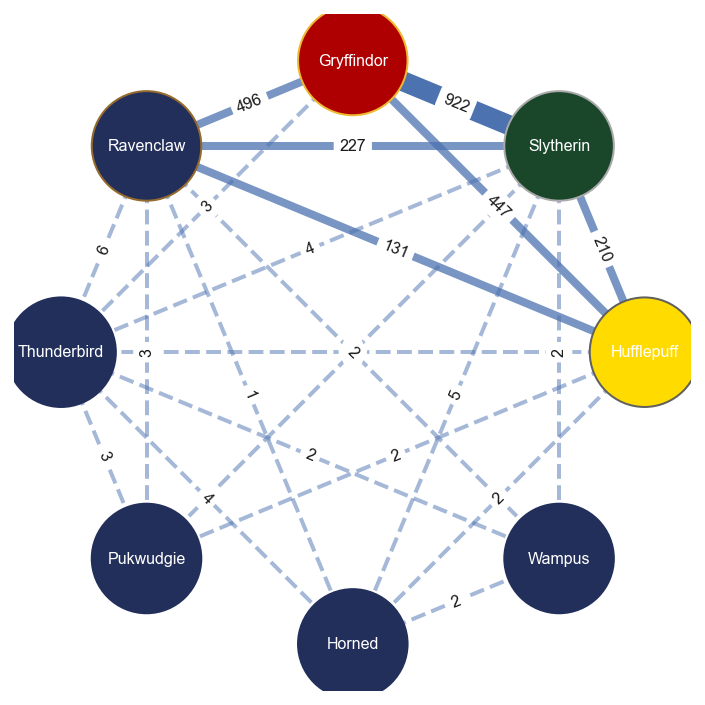

In [56]:
plt.figure(figsize=(5,5))

weights = [tup[2]['weight'] for tup in G_houses.edges(data=True)]

# Compute the weight when an edge should be categorized as large, medium, small
large = 500 #np.quantile(weights, 0.9) 
medium = 10 #np.quantile(weights, 0.1) 

#Divide the edges into different sets based on the weight
everylarge = [(u, v) for (u, v, d) in G_houses.edges(data=True) if d["weight"] >=large]
elarge = [(u, v) for (u, v, d) in G_houses.edges(data=True) if ((d["weight"] >medium) & (d["weight"] < large))]
esmall = [(u, v) for (u, v, d) in G_houses.edges(data=True) if d["weight"] <= medium]

pos = nx.circular_layout(G_houses)  # positions for all nodes - seed for reproducibility

# edges
nx.draw_networkx_edges(G_houses, pos, edgelist=everylarge, width=10, edge_color = 'b')
nx.draw_networkx_edges(G_houses, pos, edgelist=elarge, width=4, alpha = 0.75, edge_color = 'b')
nx.draw_networkx_edges(
    G_houses, pos, edgelist=esmall, width=2, alpha=0.5, edge_color="b", style="dashed")

# node-colors
house_col_map = {'Hufflepuff': "#FFDB00",
           'Slytherin': '#1A472A',
           'Gryffindor': '#AE0001',
           'Ravenclaw':'#222F5B',
           'Thunderbird':'#222F5B',
           'Pukwudgie':'#222F5B',
           'Horned':'#222F5B',
           'Wampus':'#222F5B'}

house_secondary_col_map = {'Hufflepuff': '#60605C',
           'Slytherin': '#AAAAAA',
           'Gryffindor': '#EEBA30',
           'Ravenclaw':'#946B2D',
           'Thunderbird':'#222F5B',
           'Pukwudgie':'#222F5B',
           'Horned':'#222F5B',
           'Wampus':'#222F5B'}

col_vals = [house_col_map.get(node, "#1A472A") for node in G_houses.nodes()]
limit_vals = [house_secondary_col_map.get(node, '#1A472A') for node in G_houses.nodes()]
# nodes
nx.draw_networkx_nodes(G_houses, pos, node_size=3000, node_color=col_vals,edgecolors=limit_vals, node_shape='o')

# labels
nx.draw_networkx_labels(G_houses, pos, font_size=8, font_color = 'white')
edge_labels = nx.get_edge_attributes(G_houses,'weight')
nx.draw_networkx_edge_labels(G_houses,pos, edge_labels = edge_labels, font_size=8)

ax = plt.gca()
ax.margins(0.08)
plt.axis("off")
plt.tight_layout()

plt.show()

As expected, Gryffindor is the most connected house, sharing the most edges with other houses. This is followed pretty closely by Slytherin, but with quite a drop off for the other two houses. Again we can really see how the central plot of the story revolves around the two Houses Gryffindor and Slytherin, the two houses that Harry Potter was split between. 

### 3.2 Determining word importance with TC-IDF and wordclouds <a class="anchor" id="text-analysis"></a>

The Wizarding World has many distinct groups of characters that are interesting to look more into. What sets the different school-houses apart? What are the differences in how muggle-borns and pure-bloods are described? And what are the defining features of the many species that inhabit the wizarding world? To determine the important characteristics for the different attributes, the most important words are computed using term count-inverse document frequency. 

This part of the analysis is based on the **character-description on the wiki-pages**. As the dataset contains many characters with quite lacking character descriptions, some of the characters were removed from the dataset, before creating the documents. This includes characters which had "Unidentified" as part of their name, were only named in relation to another character (e.g. Hannah Abbott's mother) or had a number in their name. The characters from the American school houses are also removed, as there were very few observations for each of these houses and the word-clouds were more indicative of the characters themselves than the house. 

The function below collects the relevant part of the wiki-page for each character and saves it as a txt-file. However, this has already been done, so it is not necessary to call the function. 

In [74]:
df_nltk = df.copy()

# remove characters with name crontaining 'unidentified'
mask_unidentified = df_nltk.name.str.contains('Unidentified')
df_nltk.drop(df_nltk.loc[mask_unidentified].index, inplace = True)

# drop all names containing 's
mask = df_nltk.name.str.contains('\'s')
df_nltk.drop(df_nltk.loc[mask].index, inplace = True)

# drop all names containing a number
mask_years = df_nltk.name.str.contains(r'\d+')
df_nltk.drop(df_nltk.loc[mask_years].index, inplace = True)

# drop the characters where there are less than 5 observations in a house
mask_houses = df_nltk.house.isin(df_nltk.house.value_counts()[df_nltk.house.value_counts() < 5].index)
df_nltk.drop(df_nltk.loc[mask_houses].index, inplace = True)

def get_data_nltk(df):
    '''
    This function collects the relevant part of the character-pages
    for all characters in the dataframe given as input. 
    
    The pages are saved as txt-files named after the character. 
    '''

    baseurl = "https://harrypotter.fandom.com/api.php?"
    action = "action=query"
    content = "prop=extracts&exlimit=1&explaintext"
    dataformat = "format=json"

    df['name_'] = df['name'].replace(" ", "_", regex = True)
    names = list(df['name_'])

    for name in names:
        title = "titles=" + urllib.parse.quote_plus(name)
        link = "{}{}&{}&{}&{}".format(baseurl, action, content, title, dataformat)

        wikiresponse = requests.get(link)
        wikitext = wikiresponse.text
        wikijson = json.loads(wikitext)

        page_id = list(wikijson["query"]["pages"].keys())[0]

        text = wikijson["query"]["pages"][page_id]['extract']
        with open('Data_files/Data_nltk/'+name+'.txt', 'w') as f:
            f.write(text)

#### Creating corpora for the attributes
The character-texts are then combined into different documents. As we want to examine the different attributes in our dataset, a set of documents are made for each attribute, e.g. a corpus for *House* is created where each document is the collection of texts for characters belonging to that house. The following function combines the character-files for a specific attribute. Note that the character-pages contain many sub-sections, where only some are relevant. For instance, the last sections are mostly *Behind the scenes* or *Apperances*, which are often about the actor playing that specific character or which movies, games of books the character appears in. We are only interested in the in-world descriptions of the characters, so these sections are removed. 

The documents are then cleaned by applying the following steps: 
* Headers in the form of ```== header ==``` are remove using the regex-pattern ```r'\=+[\w\s]+(\{\{)*(.*?)(\}\})*\=+'```. This removes all words between one or more equality-sign on both sides possibly with whitespaces before or after.  
* The text is tokenized 
* Punctuations, stopwords and non-alphabetic tokens are removed, and the tokens are set to lowercase
* The tokens are lemmatized
* Chosen tokens are also removed. This includes character-names and the values for the attribute given as input to the function (e.g. all species for the species-corpus). 


In [86]:
def get_content(att, type_):
    '''
    Combine the character-pages for the characters belonging to the specific group of the chosen attribute
    For example "House", "Hufflepuff"  
    '''
    characters = df_nltk[df_nltk[att]==type_].name
        
    contents = ""
    for name in characters:
        name = name.replace(" ", "_")
        name = name.replace("?", "_")
        with open('Data_files/Data_nltk/'+ name +'.txt', 'rb') as f:
            content = f.read().decode("UTF-8")
            # We only want the biography/description of the character
            try: 
                content = content.split("==Biography==")[1]
            except: 
                pass 

            # Remove behind the scenes and appearances (last sections in the texts)
            content = content.split("==Behind the scenes==")[0]
            content = content.split("== Behind the scenes ==")[0]
            content = content.split("== Appearances ==")[0]
            
            # append to contents 
            contents += content + ""
    return contents

def data_cleaning(text, tokens_to_remove):
    '''

    This function cleans the given text by applying the steps below.  

    '''
    tk = WordPunctTokenizer()
    stop = stopwords.words('english')
    lemmatizer = WordNetLemmatizer()

    # remove headers
    pattern_header = r'\=+[\w\s]+(\{\{)*(.*?)(\}\})*\=+'
    text = re.sub(pattern_header, ' ', text)

    # tokenize 
    tokens = tk.tokenize(text)

    # remove punctuation and stopwords and to lowercase
    tokenised = [t.lower() for t in tokens if t.lower() not in stop if t not in ['n'] if t.isalpha()]

    # lemmatize words
    lemmatised = [lemmatizer.lemmatize(w) for w in tokenised]
    
    #  remove chosen tokens
    cleaned_text = [t for t in lemmatised if t not in tokens_to_remove]

    return cleaned_text

We remove the names (as many as possible) from the texts as we do not want character-names to be the defining words for each group. This does not carry very much information as we already know the features for the characters. 

For the house documents, we also remove the names of the houses and likewise for the other features. 

In [87]:
# save all names in a list
names = []

for name in list(df_nltk.name):
    temp_string = name.split(' ')

    # if a person has a family name then also append the family name in plural form 
    if len(temp_string) == 2:
        temp_string.append(temp_string[1] + 's')
    names += temp_string

# convert to lower case
names_lower = [name.lower() for name in names]
# some characters have nicknames, so these are manually added to the list of names to remove 
names_lower += ['ron', 'ginny', 'voldemort','ernie','barty','queenie','delphi','warwick', 'davy', 'ludo', 'isolt','newt']

The corpus for each attribute can now be created. Note that for each attribute, we remove different tokens. This is based on examinations of the character-pages and experiments with the wordclouds. 

In [88]:
nltk.download('wordnet')

# House
houses = pd.unique(df_nltk.house)
remove_tokens_house = names_lower + [h.lower() for h in houses] + ['overdue']
house_dict = {house: data_cleaning(get_content('house', house), remove_tokens_house) 
                for house in houses}

# Species
species = pd.unique(df_nltk.species)
remove_tokens_species = names_lower + [h.lower() for h in species] + ['elf']
species_dict = {s: data_cleaning(get_content('species', s), remove_tokens_species) 
                for s in species}

# Blood-status
blood_status = pd.unique(df_nltk.blood)
remove_tokens_blood = names_lower + [h.lower() for h in blood_status]+['nd','n','w']
blood_dict = {blood: data_cleaning(get_content('blood', blood), remove_tokens_blood) 
                for blood in blood_status}

# Gender
genders = pd.unique(df_nltk.gender)
remove_tokens_genders = names_lower + [h.lower() for h in genders]
gender_dict = {gender: data_cleaning(get_content('gender', gender), remove_tokens_genders) 
                for gender in genders}

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Johan\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


#### Examining word count
One way to determine the important words for each attribute is to simply count the word-occurences. The most frequent words for each attribute are hereby scored highest. However, there are some issues with this approach as can be seen in the visualization below. The word *year* is very frequent for the Hogwarts houses. This is because the characters are often described in terms of what they did each year at Hogwarts. This method clearly does not find the words, unique to each attribute. 

Instead the term count-inverse document-frequency is used, as this takes into account how relevant a word is for a specific document. The TC-IDF score takes two metrics into account: 
1. How often the word occurs in a document (TC)
2. The inverse document frequent of the word across all documents (IDF). This metric measures how rare or common the word is in the corpus, and it will be low for words which occur in many of the documents and high for rare words.  

It is calculated as follows, where N is the number of documents in the corpus. 

$TC\text{-}IDF(term, document) = \text{count of term in document} \cdot \log(\frac{N} {\text{occurrence of term in N documents}})$

Note that we only calculate this metric on words we *know* are in the corpus. Otherwise we should add +1 to the denominator in the calculation of IDF.  

Gryffindor


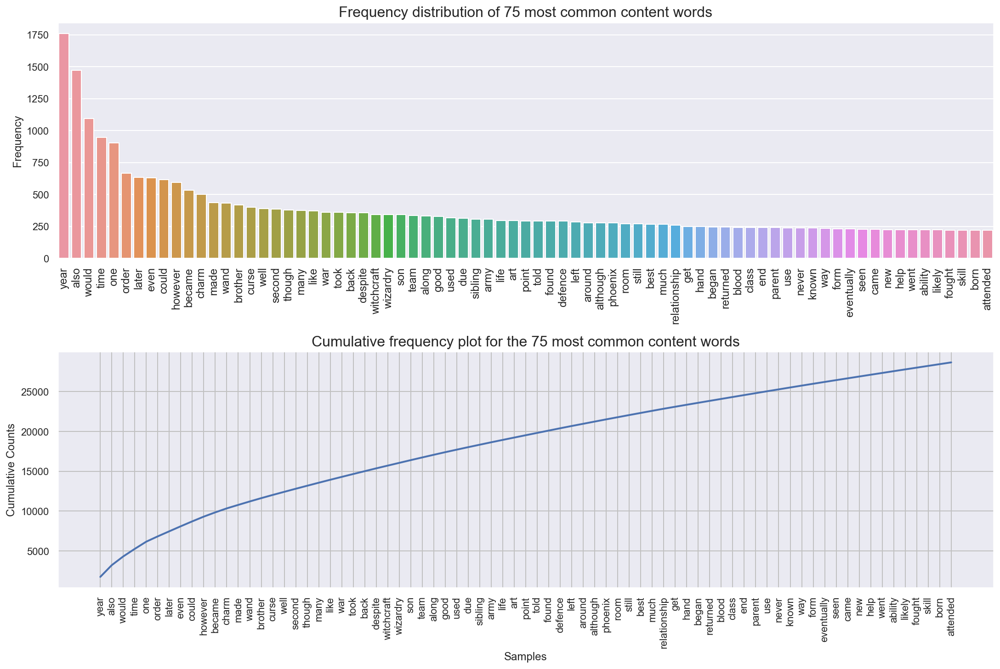

Slytherin


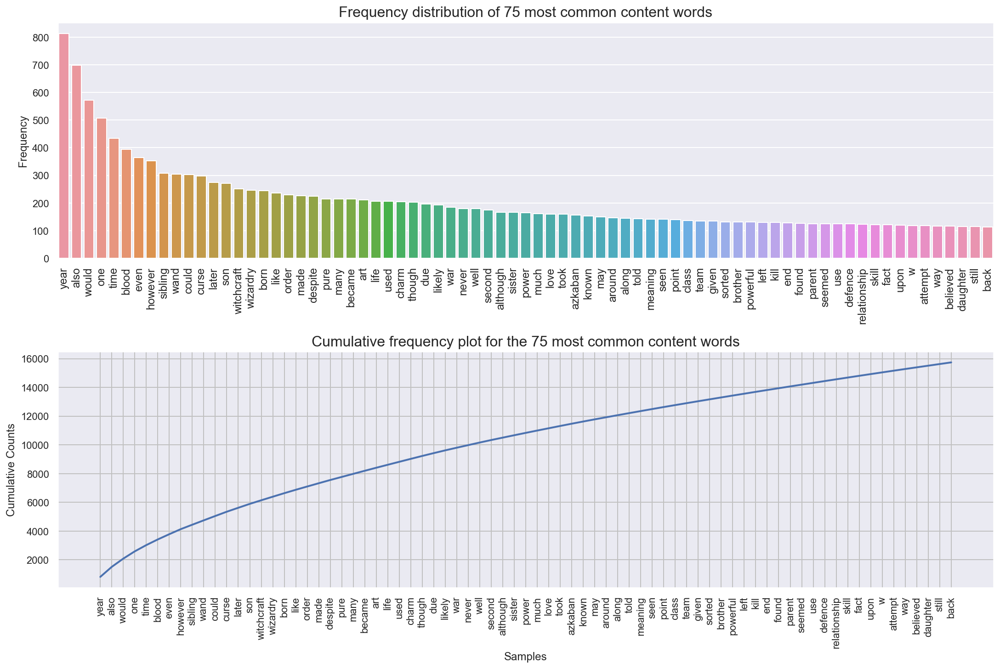

In [89]:
def plotFreq(n, fdist, freq):
    '''
    Function for plotting the frequency distribution including the cumulative frequerncy plot for the n most common words
    '''

    fig, (ax1, ax2) = plt.subplots(2, 1, figsize = (15, 10), constrained_layout = True)

    # Seaborn plotting using Pandas attributes + xtick rotation for ease of viewing
    all_plot = sns.barplot(x = fdist.index, y = fdist.values, ax = ax1)
    ax1.set_title("Frequency distribution of {} most common content words".format(n), fontsize = 16)
    ax1.set_ylabel('Frequency', fontsize = 12)
    ax1.set_xticklabels(fdist.index, rotation = 90, fontsize = 12);

    plt.title("Cumulative frequency plot for the {} most common content words".format(n), fontsize = 16)
    freq.plot(n, cumulative=True)

    plt.show()
    
for house in ['Gryffindor', 'Slytherin']:
    corpus = nltk.Text(house_dict[house])

    # create a frequency distribution
    n = 75

    freq = FreqDist(corpus)

    # find the 75 most coomon words
    fdist = pd.Series(dict(freq.most_common(n)))

    # plot the frequency distirbution
    print(house)
    plotFreq(n, fdist, freq)

As noted it can be seen that for Gryffindor and Slytherin many of the same words occur most frequently. 

#### Calculating TC-IDF
The word score can now be calculated for each document (i.e. each type of school-house, each type of species and so on) using the following functions. 


In [90]:
def getTC(doc):
    '''
    This function computes TC for each word in the document 
    
    Input: A list of cleaned tokens
    Output: The count of each token in the document (returned as a dictionary)
    '''
    
    TC = Counter(doc)
    return TC

def getIDF(docs):
    '''
    This function computes IDF for each term in the documents 
    
    Input: A dictionary with the cleaned tokens for each document 
    Output: The IDF-score for each term (returned as a dictionary) 
    '''
    IDFs = {}
    
    # Number of documents 
    N = len(docs) 
    
    # Vocabulary to compute the idf for 
    vocab = []
    for tokens in docs.values():
        vocab = vocab + tokens
    vocab = set(vocab)
    
    # Compute idf 
    for term in vocab: 
        # count occurences in N docs
        df = 0 
        for doc, tokens in docs.items(): 
            if term in tokens:
                df += 1
        if df == 0: 
            print(term)
        # get idf
        IDFs[term] = np.log(N/df)
    return IDFs

def getTC_IDF(docs):
    
    '''
    This function computes the TC-IDF-scores for each document 
    
    Input: A dictionary with the cleaned tokens for each document 
    Output: The TC-IDF-score for each term for each document (returned as a dict in a dict)
    '''
    
    # Results 
    TC_IDFs_dict = dict()
    
    # Compute the idf for all terms in the documents 
    IDFs = getIDF(docs)
    
    for doc in docs:  
        TC_IDFs = dict()
        
        # Get term frequency for document
        TC = getTC(docs[doc])
        
        # Get tf-idf scores for document 
        for term, TC_score in TC.items():
            TC_IDFs[term] = TC_score * IDFs[term]
        
        # Save the scores in dict
        TC_IDFs_dict[doc] = TC_IDFs
        
    return TC_IDFs_dict

In [91]:
# Calculate TC-IDF-scores for each attribute
TC_IDFs_house = getTC_IDF(house_dict)

TC_IDFs_species = getTC_IDF(species_dict)

TC_IDFs_blood = getTC_IDF(blood_dict)

TC_IDFs_gender = getTC_IDF(gender_dict)

#### Visualizing wordclouds
The 50 most important words based on TC-IDF-score are visualized as wordclouds. Note that only the top 5 values for each attribute are shown here. The remanining can be seen on our website under *Text Analysis*. 

In [92]:
def makeWordCloud(tc_idf, attribute, title):
    # make text string 
    text = ""
    for key, val in tc_idf.items():
        key = key+" "
        repetitions = int(np.ceil(val))
        text += key*repetitions 

    # Make word cloud
    wordcloud = WordCloud(collocations = False, 
                          max_words=50, 
                          background_color="white",
                          width=1600, 
                          height=800).generate(text)
    
    # Display the generated image:
    plt.figure(figsize=(10,5))
    plt.imshow(wordcloud)
    plt.title(title, fontsize = 40, pad=30)
    plt.axis("off")
    plt.tight_layout(pad=0)
    
    plt.show()

##### School-house

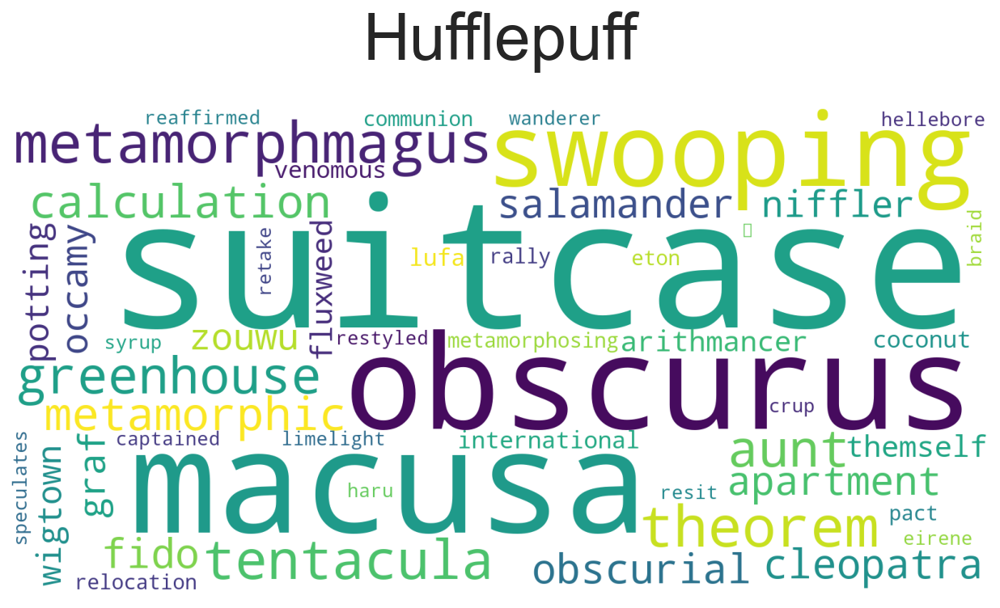

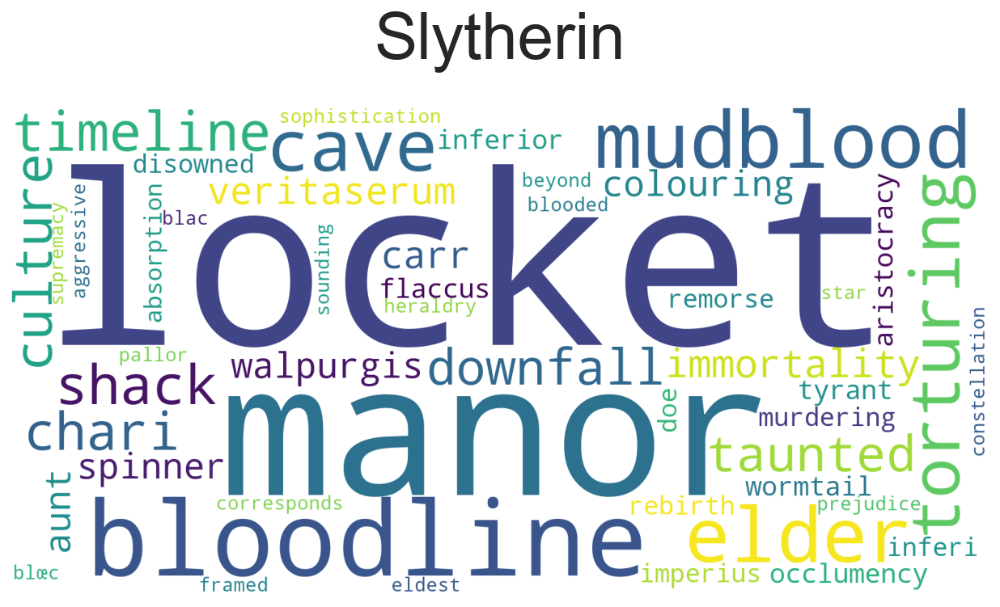

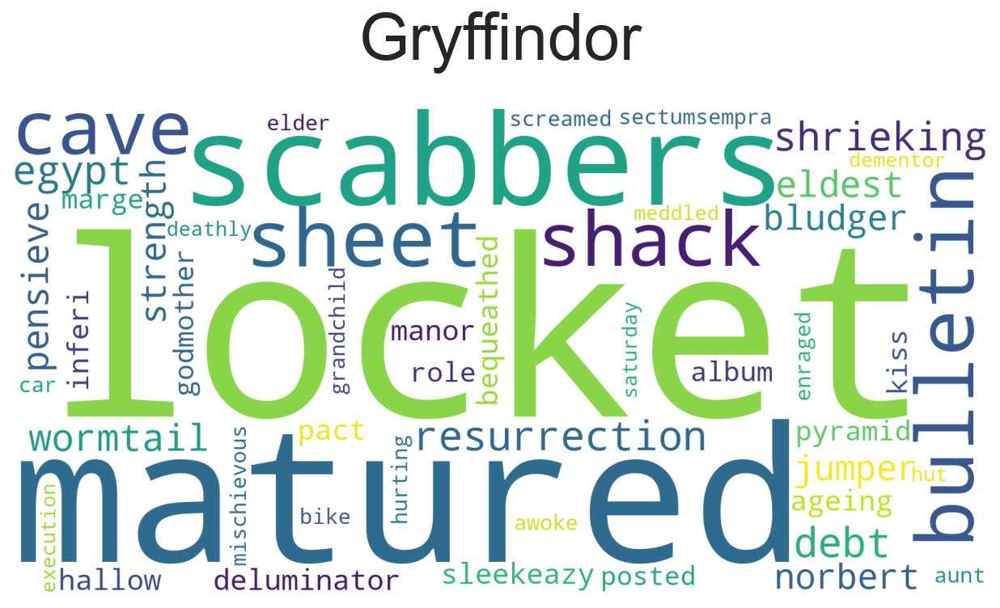

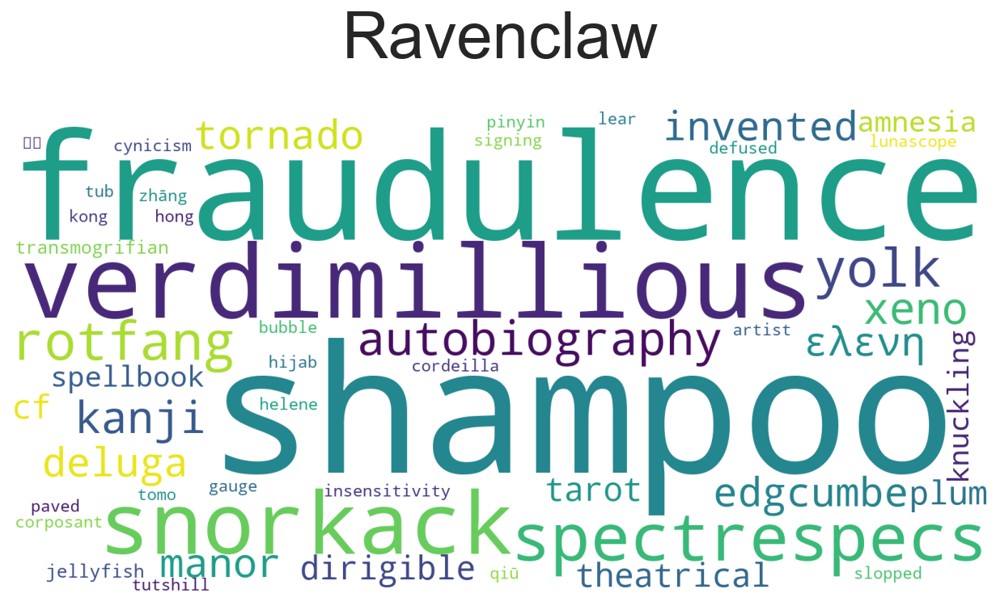

In [93]:
houses = list(houses)
houses.remove('unknown')
for house in houses: 
    makeWordCloud(TC_IDFs_house[house], "house", house)

It can be seen that the house-wordclouds have captured some of the significant traits for some of the houses. In the Slytherin wordcloud the words *mudblood*, *bloodline* and *aristocracy* can be found, which could suggest that Slytherins mostly come from old, pure-blood families and have a very prejudiced approach to muggle-borns (as mudblood is a very degoratory expression for muggle-borns). If you look closer, there are also words such as murdering, taunted, torturing, disowned and aristocracy, which overall give a negative impression of Slytherin as a house. The other wordclouds seem to mostly refer to important characters and events associated with this house. Especially the Hufflepuff wordcloud is very influenced by the most famous Hufflepuff, Newton Scamander, who has a magically-expanded suitcase where he among other things has a obscurus and a wide variety of magical beasts. The Ravenclaw wordcloud also seems to reference Gilderoy Lockhart, a former fraudulent Ravenclaw who was very absorbed by his own looks and fame (see the words *fraudulence, autobiography* and *shampoo*). 

##### Species

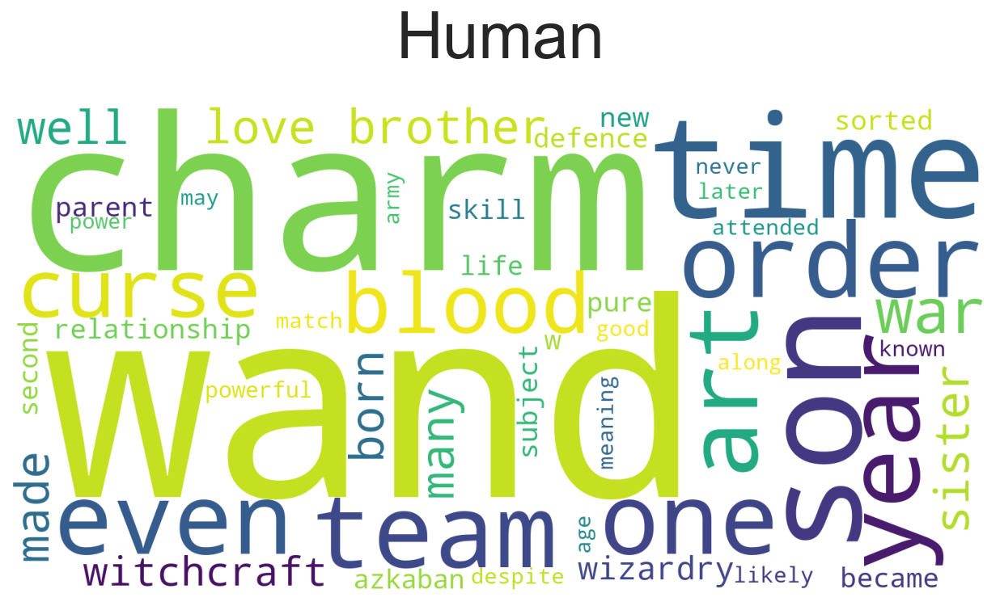

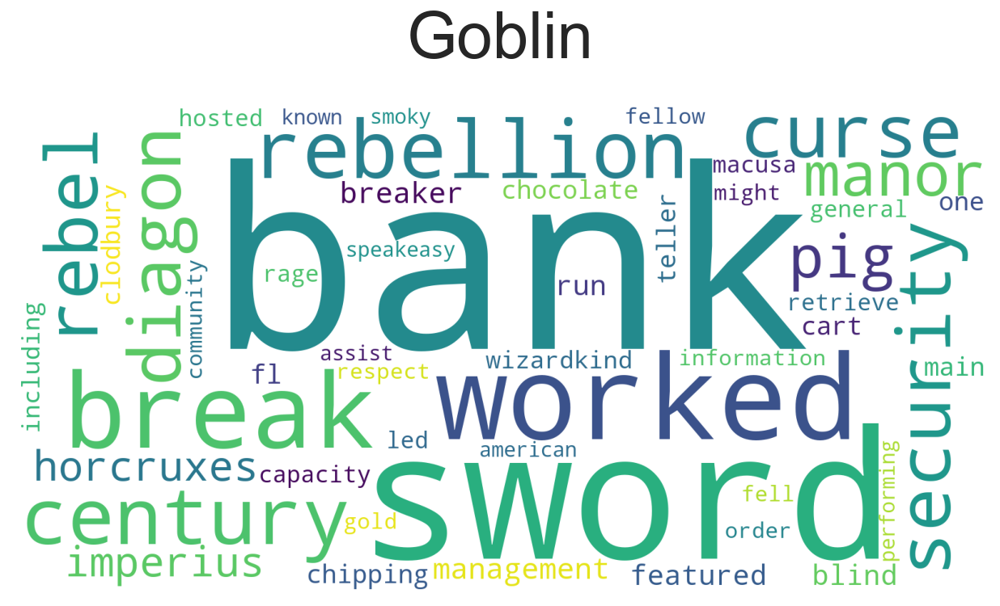

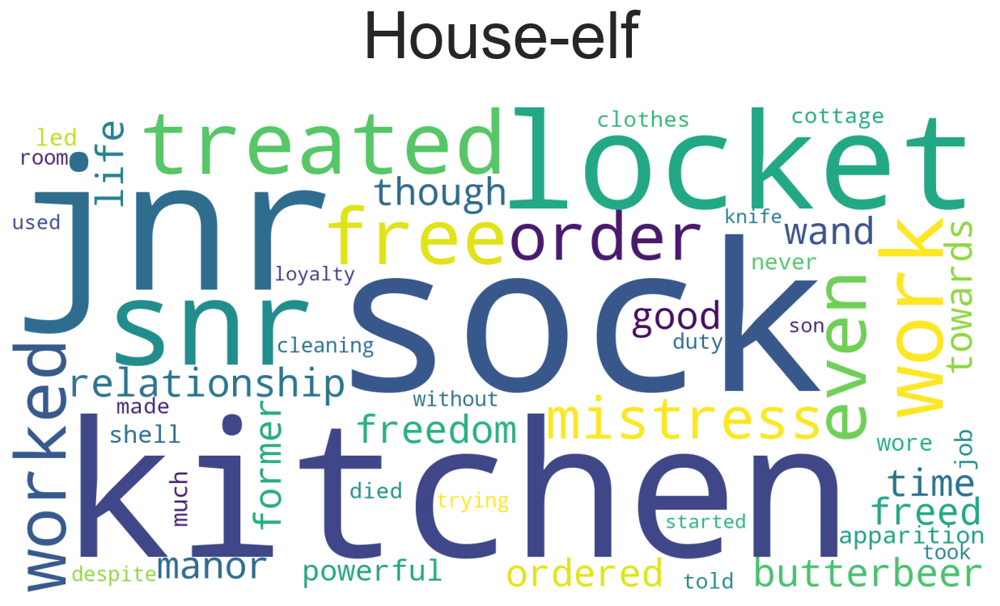

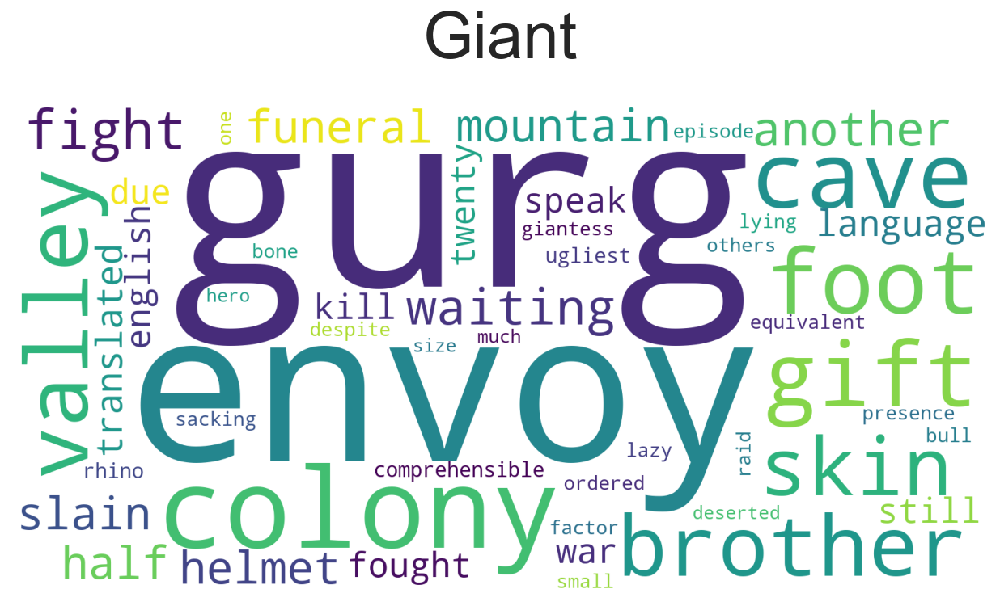

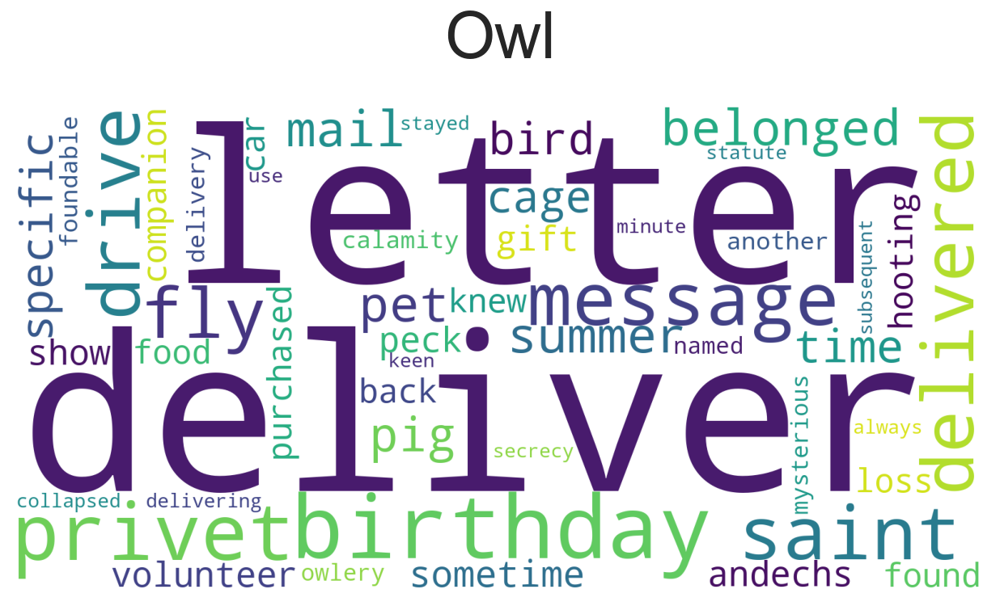

In [94]:
top_5_species = list(df.species.value_counts()[0:6].index)
top_5_species.remove('unknown')
for spec in top_5_species: 
    makeWordCloud(TC_IDFs_species[spec],"species", spec)

The wordclouds for each species are very different and can be used both to examine the features of each species and what part the species play in the wizarding world. 

What sets **Humans** apart from the other species in the Wizarding World is mainly the right to bear a wand, which is why this is the most important word for humans. Another important word is charm which is a group of spells, thus also referincing the magical abilities of the humans.

**Goblins** are skilled metalsmiths and bankers, who to some extent control the wizarding economy. This is clearly referenced in the wordcloud where top-words are bank, sword and security.

**House-elfs** are servants (or slaves) to wizarding families, which is referenced by words such as worked, kitchen, job, cleaning and clothes. Dobby becoming a free elf is also clearly referenced. It is also possible to find titles that the house elves address their masters by such as snr (senior), jnr (junior) and mistress.

**Giants** are rather violent creatures living in the mountains. One exception is Hagrid's half-brother Grawp who he attempts to teach English (see the word brother and English in the wordcloud). The chief of the giants is called the Gurg, which explains why this is such an important word.

##### Blood-status

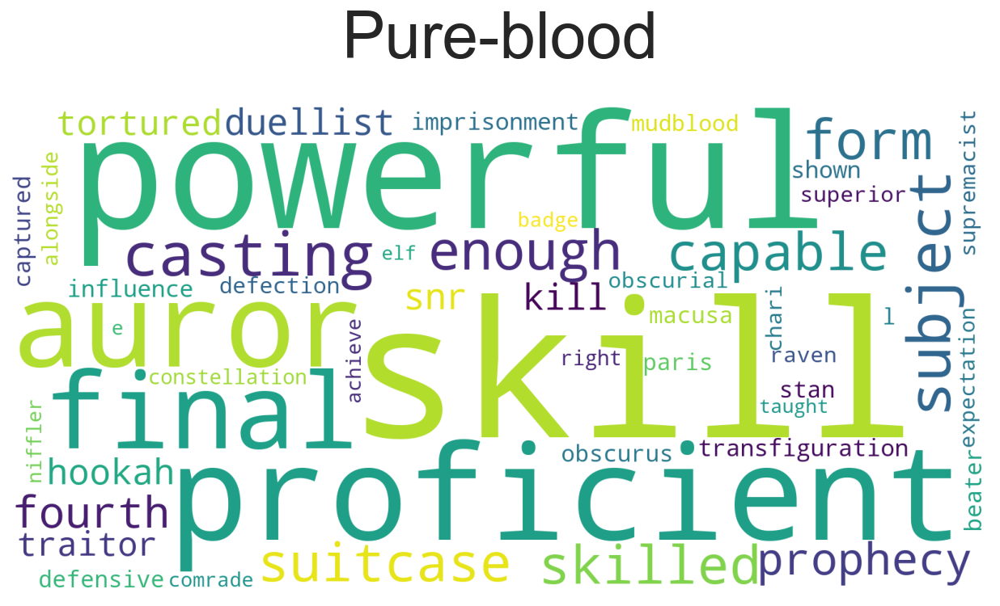

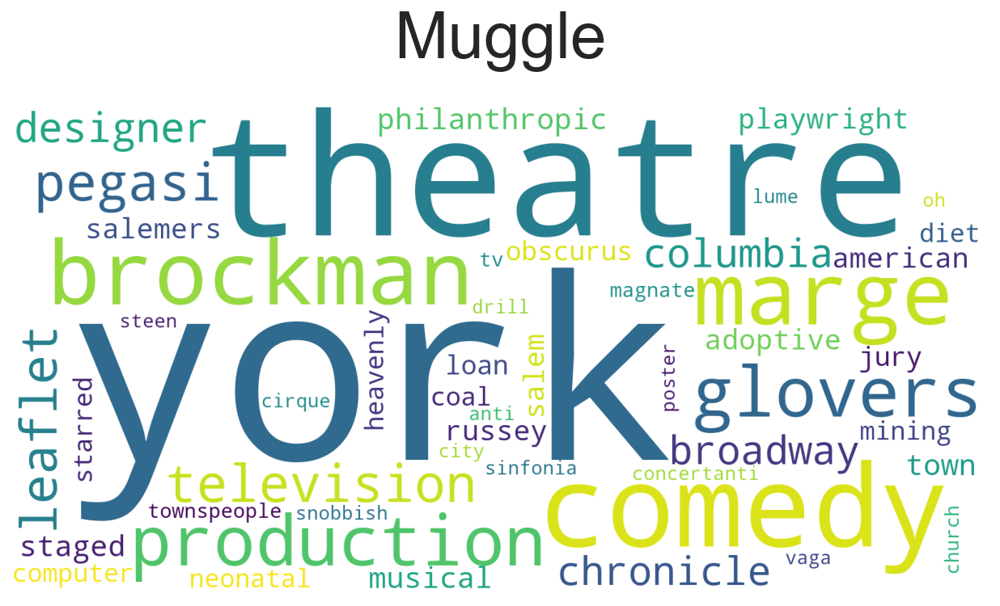

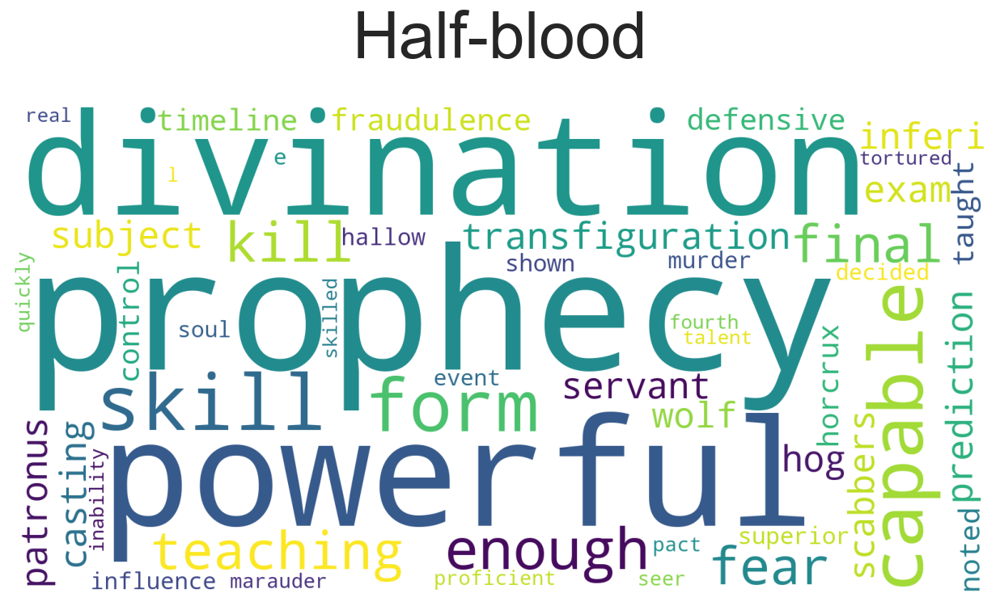

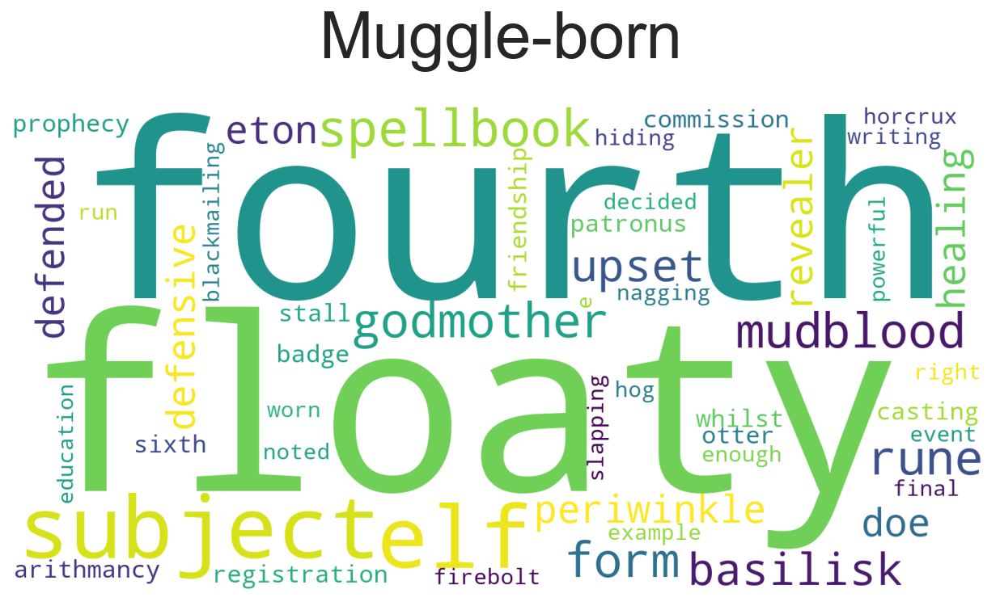

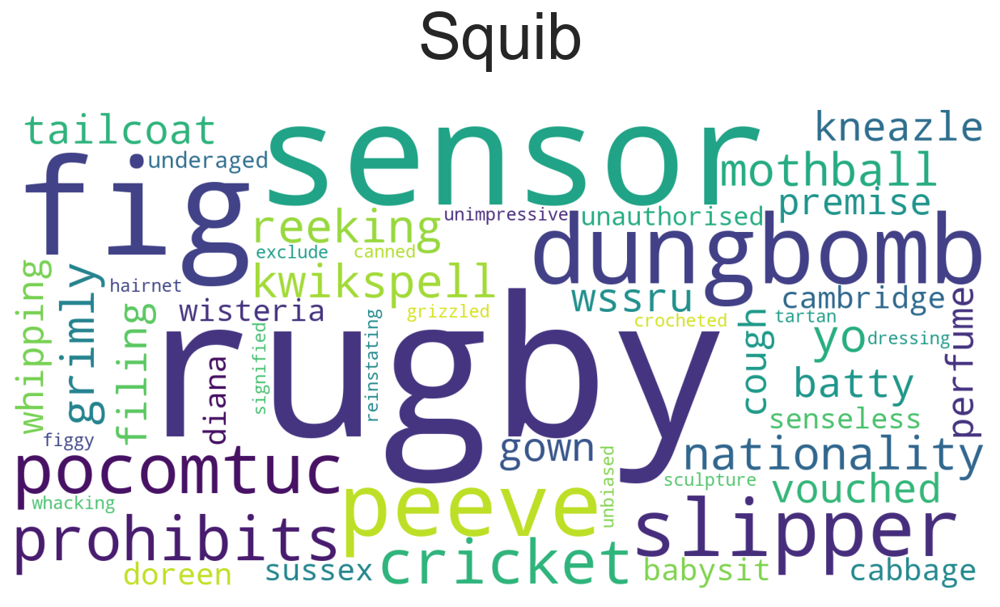

In [95]:
top_5_blood = list(df.blood.value_counts()[0:6].index)
top_5_blood.remove('unknown')
for blood in top_5_blood: 
    makeWordCloud(TC_IDFs_blood[blood],"blood", blood)

The blood-status of a character plays an important role in the Harry Potter series. Overall, there is a lot of prejudice in the wizarding world about blood-status. However, since the wiki-pages are written in (mostly) neutral language, this is not very clear from the wordclouds. One exception is the word mudblood in the Muggle-born wordcloud, which clearly references some of the discramination they face.

Instead, the wordclouds seem to reference traits about the characters of that specific blood-type, e.g. there are many words in the Muggle-born category, which can be connected with Hermione. Voldemort and Harry Potter are both half-bloods, which might explain why powerfull, kill and skill are important words here. Words such as prophecy, prediction and divination also reference the prophecy there exists between these two characters.

##### Gender

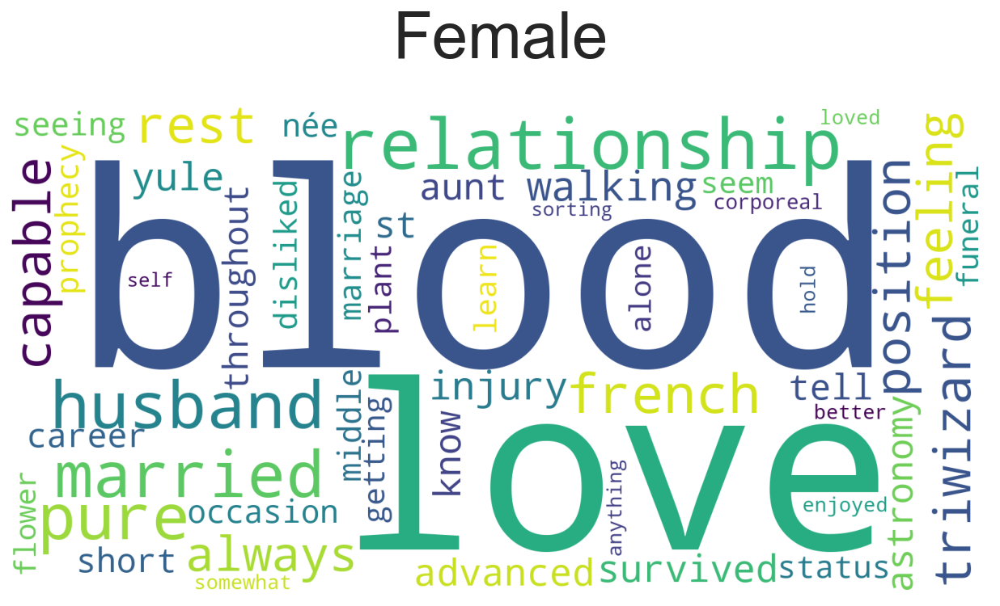

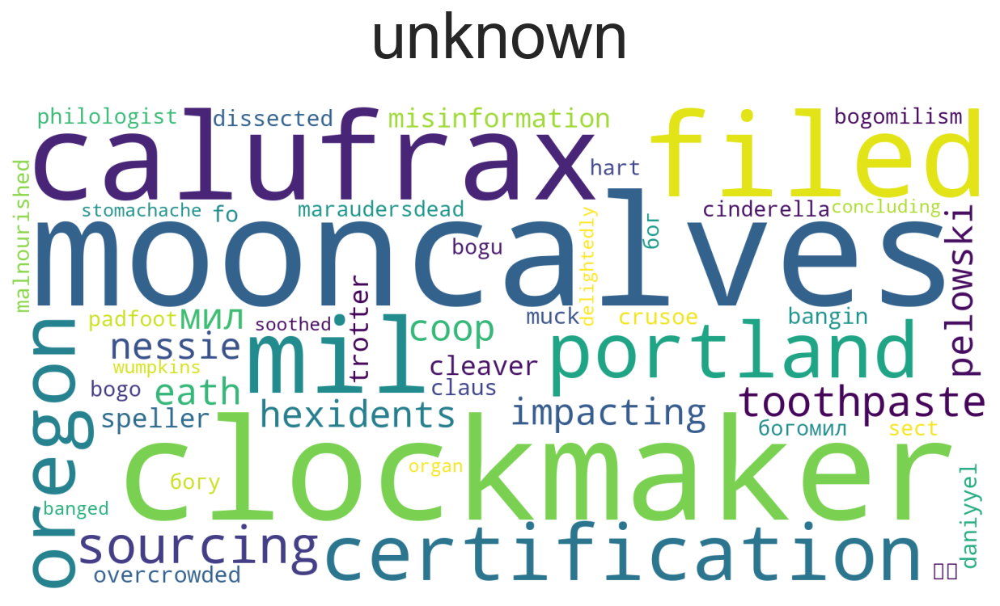

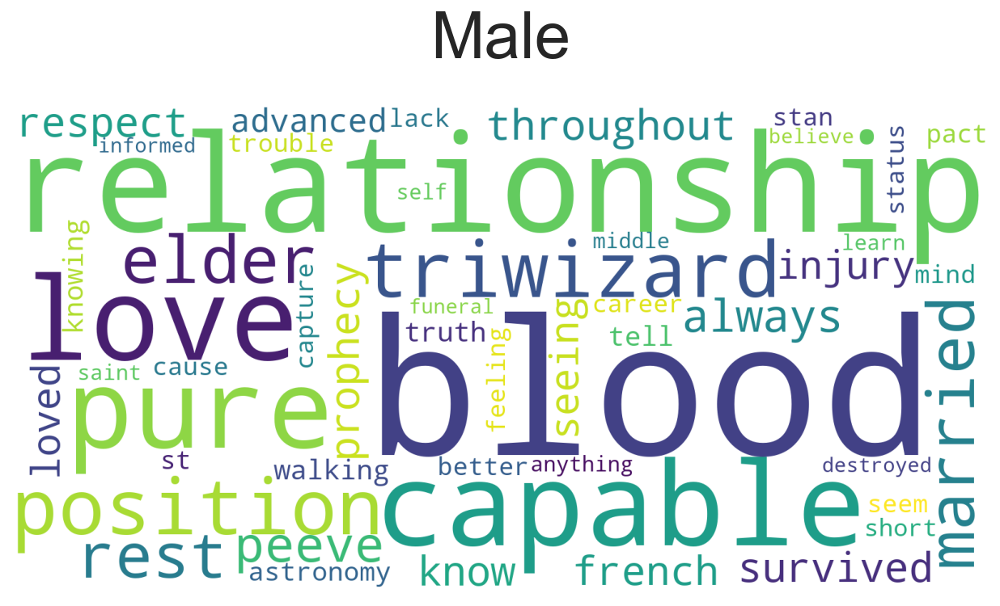

In [96]:
for gender in TC_IDFs_gender.keys(): 
    makeWordCloud(TC_IDFs_gender[gender], "gender", gender)

The male and female wordclouds are quite similar, as some of the most important words for both are e.g. relationship and love. This indicated that this is perhaps not the most interesting partitioning of the characters as the characters are described quite similar regardless if they are male or female. However, one thing to note is that husband is an important word in the female wordcloud - a female character's spouse is clearly often mentioned in relation to them!

We have included the "unknown" wordcloud as there were a few highly-connected characters of unknown or undetermined gender, including Jacob's sibling (as the player can choose the gender). 

### 3.3 Community detection <a class="anchor" id="communities"></a>

The Wizarding World is a large network of many different characters connected across different families, school houses etc. It is interesting to examine what the best way to split the network of the Wizarding World into communities is. When thinking about the <i>Harry Potter Universe </i> the best way to partition the network might be by splitting the network into community of school houses? However, when thinking about the whole Wizarding World, this might not be the best partition as there are many characters where the attribute <i> school house </i> is unknown (see <b>Network Statistics </b> section). Will the partition on blood status be more informative? Or something entirely different? This section will analyse this, where we will examine partitions based on school houses, species, blood status and the Louvian partition. The partitions are evaluated on their modularity.

Modularity is a concept that tries to capture the systematic deviation from the random structure that is assumed to be in community-structured networks (Network Science, chapter 9). It can be calculated using equation 9.12 in Network Science chapter 9: 

$
M = \sum_{c=1}^{n_c} [  \frac{L_c}{L} - (\frac{k_c}{2L})^2  ]
$

where $n_c$ is number of communities, $L$ is the total number of links, $L_c$ is the total number of links within the community $C_c$ and $k_c$ is the total degree of the nodes in this community. 

In other words, modularity measures the quality of a partition: The higher modularity for a partition, the better the partition is. The modularity can be either negative or positive (up to 1). 

##### Define functions called for creating and plotting the partitions

The functions used for getting the partitions, colouring nodes according to community and plotting the network graph are defined below. These functions are called for all the examined partitions.   

In [97]:
# get the node partition
def get_partition(G, attribute, att_list):
    '''
    This function partitions the network based on a keyword
    Input: networkx graph, attribute to make the partition on, and list of groups (communities)
    Output: partition of nodes as a dictionary
    '''
    node_partition = {}
    for att in att_list:
        # select nodes with attribute equal to att
        selected_nodes = [n for n,v in G.nodes(data = True) if v[attribute] == att]
        node_partition[att] = selected_nodes
        
    return node_partition

In [98]:
# get the node color for the different communities
def get_community_colors(communities):
    '''
    This function finds the colours for each community
    Input: list of community names
    Output: colour map 
    '''
    # chekc if the communities consist of school houses
    if "Gryffindor" in communities: 
        houses = True
    else:
        houses = False

    # if the partition is not according to school houses the assign random colours to the communities
    if houses == False: 
        col_map = {}
        for com in communities:
            col_map[com] = '#%06X' % random.randint(0, 0xFFFFFF) 
        return col_map
    # if the communities are school houses, then assign the house colours to the communities
    else:
        house_col_map = {
           'Hufflepuff': "#FFDB00",
           'Slytherin': '#1A472A',
           'Gryffindor': '#AE0001',
           'Ravenclaw':'#222F5B',
           'Thunderbird':'grey',
           'Pukwudgie':'lightgrey',
           'Horned':'black',
           'Wampus':'darkgrey', 
           'unknown': 'whitesmoke'}
        return house_col_map

In [99]:
# define positions based on the ForceAtlas algorithm
forceatlas2 = ForceAtlas2(
                        # Behavior alternatives
                        outboundAttractionDistribution=False,  # Dissuade hubs
                        linLogMode = False,  
                        adjustSizes = False,
                        #edgeWeightInfluence = 0.1,

                        # Performance
                        jitterTolerance = 1.0,  # Tolerance
                        barnesHutOptimize = True,
                        barnesHutTheta = 1.2,
                        multiThreaded = False,

                        # Tuning
                        scalingRatio=0.0001,
                        strongGravityMode=False,
                        gravity=2, # attracts nodes to the center

                        # Log
                        verbose=True)
# plot the network 
def plot_communities_network(G, communities, partition, colors):
    '''
    This function plots the network coloured according to communities
    Input: networkx graph, list of community names, partition and colours
    Output: plot showing the wizarding world network with nodes coloured according to community 
    '''
    count = 0
    fig = plt.figure(figsize = (15,15))
    fig.patch.set_facecolor('silver')

    # get positions
    positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)
    # color and plot communities
    for com in communities:
        count = count + 1.
        list_nodes = [node for node in G.nodes() if node in partition[com]]
        weights = [G.nodes(data=True)[node]['size'] for node in list_nodes]
        nx.draw_networkx_nodes(G, positions, list_nodes, node_size = weights, node_color=colors[com])

    nx.draw_networkx_edges(G, positions, edge_color="gray", alpha=0.1)
    plt.axis('off')
    plt.show()

# show the color coding of the communities
def color_coding_communities(communities, colors):
    '''
    This function shows the colour coding of the communities in a barplot 
    Input: list of community names and colours
    Output: barplot showing the colour assigned to the communities and shwoing the community names
    '''
    no_communities = len(communities)

    # rotate xticks
    if no_communities > 30:
        rot = 90
    else: 
        rot = 0

    plt.figure(figsize=(15,0.5))
    # show color and community name
    plt.bar(range(no_communities),1 , color = colors.values())
    plt.xticks(range(no_communities), colors.keys(), rotation = rot)
    plt.yticks([])
    plt.xlabel("Community colour coding")
    plt.show()

#### Partition the network

The partitions examined are:
* School house
* Species
* Blood type
* Louvian partition

The partitions are applied on the undirected GCC. We obtain two dictionaries that are used for analysis and visualization:
* One where each node (character) is the key and the community (a number) is the value.
* One where the communities are keys and a list of characters within that community is the value. 

In [106]:
def get_network_communities(community_key, df, G):
    '''
    This function find the partition of the network, calculate the modularity of the partition and 
    plots the network with nodes coloured according to the community they belong to
    Input: community key, dataframe, graph
    Output: number of communities, size of communities, modularity for the partition, partition values 
            (both character-based and community-based), colors
    '''
    # get partition if the partition is based on an attribute value
    if community_key != 'best':
        communities = list(pd.unique(df[community_key]))

        # get partition
        partition = get_partition(G, community_key, communities)
        inv_partition = {l: k for k, v in partition.items() for l in v}
    # get the Louvian partition
    else:
        # get partition
        inv_partition = community.best_partition(G, randomize = False)
        communities = list(set(inv_partition.values()))
        partition = {com: [k for k, v in inv_partition.items() if v == com] for com in communities}
    # number of communities
    no_communities = len(communities)
    # list of with sizes of communities
    val = list(Counter(inv_partition.values()).values())

    # compute modularity
    mod = community.modularity(inv_partition, G)
    print("\033[1m" + 'Modularity for the partition on {} is {}'.format(community_key, mod) + "\033[0m" + '\n')

    # get node size
    sizes = list(nx.get_node_attributes(G,'size').values())

    # get colours
    colors = get_community_colors(communities)

    # plot network
    plot_communities_network(G, communities, partition, colors)

    # colour coding
    color_coding_communities(communities, colors)

    return no_communities, val, mod, partition, inv_partition, colors

##### Partition according to school house

As the Wizarding world consists of both the <i> Harry Potter universe </i> and the <i> Fantastic Beasts universe</i> there are both Hogwart's school houses and American school houses. The known school houses are therefore:
* Hufflepuff
* Slytherin
* Gryffindor
* Ravenclaw
* Thunderbird
* Pukwudgie
* Horned
* Wampus

However, there are many nodes without any known school house. Therefore, the community <i>unknown </i> will be a rather large community, and the communities for the American school houses will be rather small as only few characters are known to have attended these houses. Thus, this partition might not be the best grouping of the network data.  

Modularity for the partition on house is 0.0825337859863671



100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:43<00:00, 23.00it/s]


BarnesHut Approximation  took  13.09  seconds
Repulsion forces  took  28.78  seconds
Gravitational forces  took  0.16  seconds
Attraction forces  took  0.17  seconds
AdjustSpeedAndApplyForces step  took  0.67  seconds


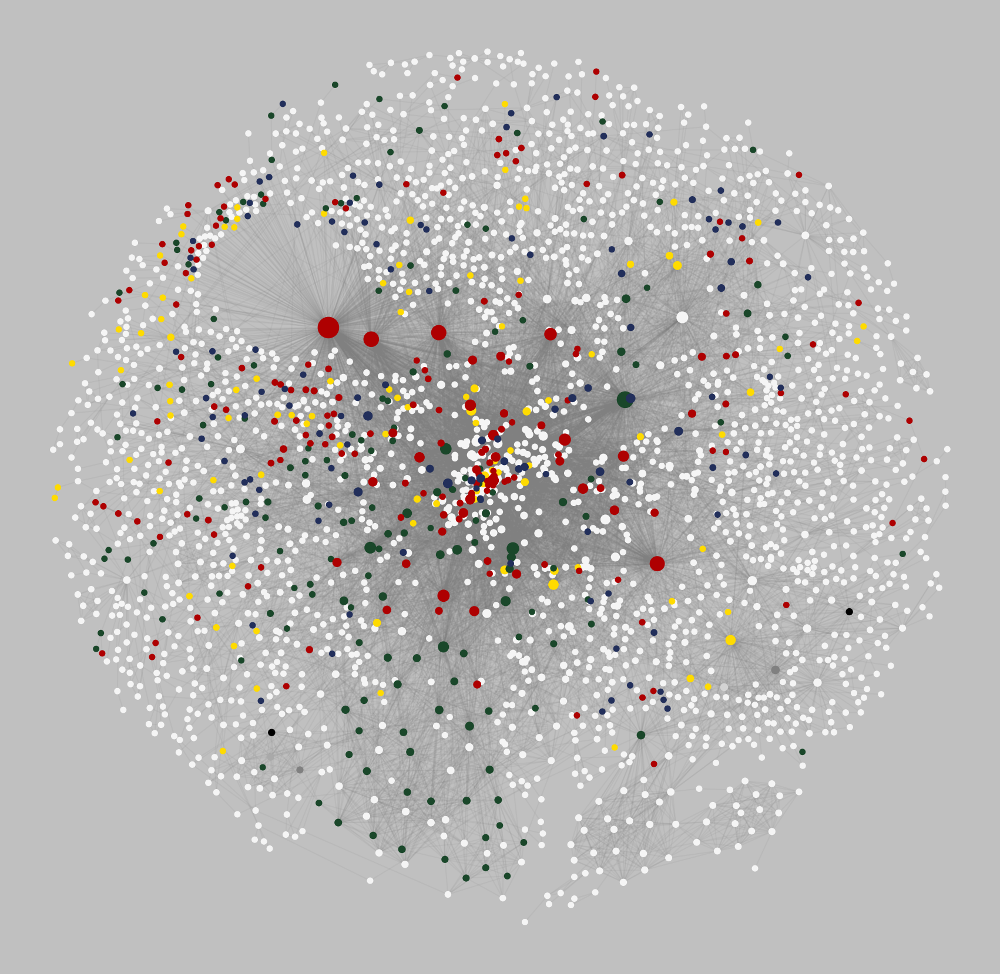

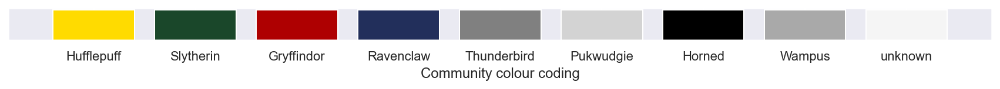

In [107]:
GCC = GCC.to_undirected()

community_key = 'house'
no_communities_house, val_house, mod_house, partition_house, inv_partition_house, colors_house = \
        get_network_communities(community_key, df, GCC)

It can be seen that the modularity is rather low, 0.083, which indcates that this partition does not capture the systematic deviation from the random structure very well. 

##### Partition according to species

The exploratory analysis yielded that there were 96 distinct species when we had processed the data. As the distribution of species for the full network showed there are 3.370 humans. The second largest group of species is <i> unknown </i> with a size of 233 characters. <i>Goblins </i> is the third largest group, and there are 48 goblins in the network. This indicates, that there will be one very large community of all humans, and hereafter there will be many very small communities. This would probably result in a low modularity score even worse than the one found for the previous partition.  

  0%|▏                                                                                | 3/1000 [00:00<00:34, 28.84it/s]

Modularity for the partition on species is 0.032425728378595926



100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:44<00:00, 22.45it/s]


BarnesHut Approximation  took  13.30  seconds
Repulsion forces  took  29.59  seconds
Gravitational forces  took  0.18  seconds
Attraction forces  took  0.17  seconds
AdjustSpeedAndApplyForces step  took  0.65  seconds


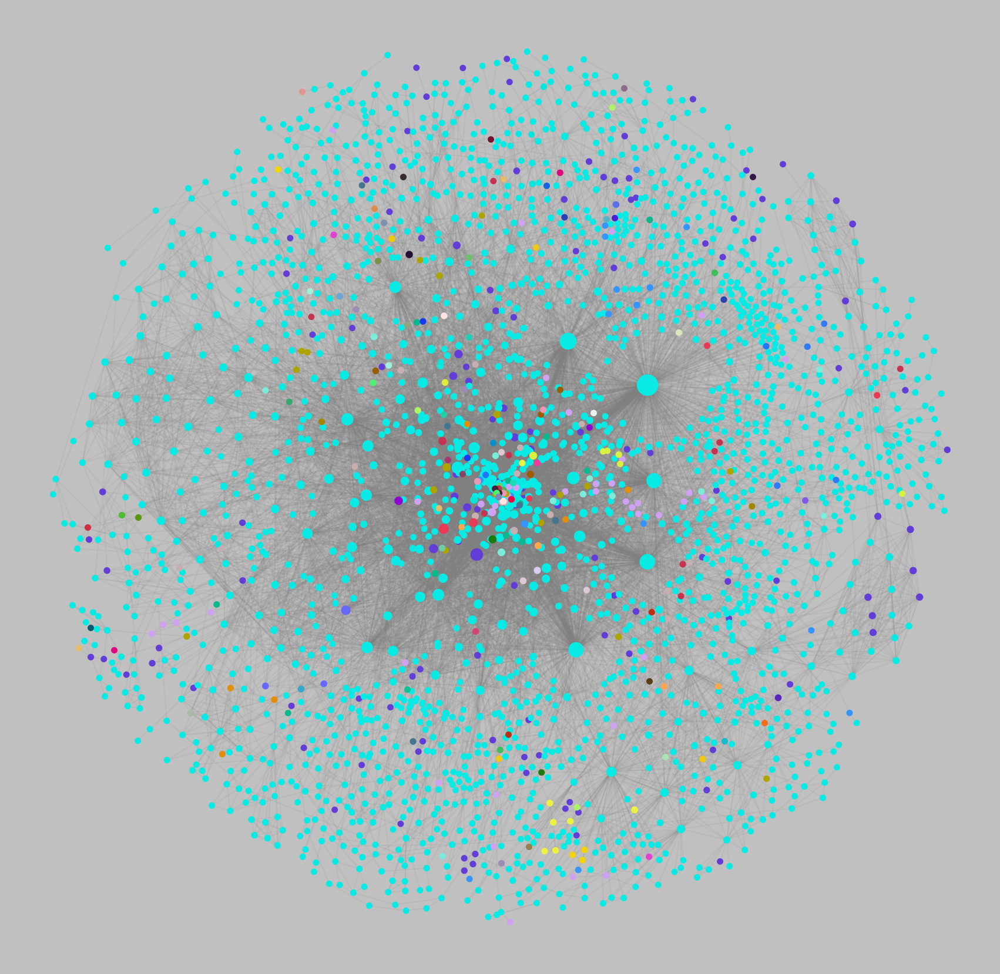

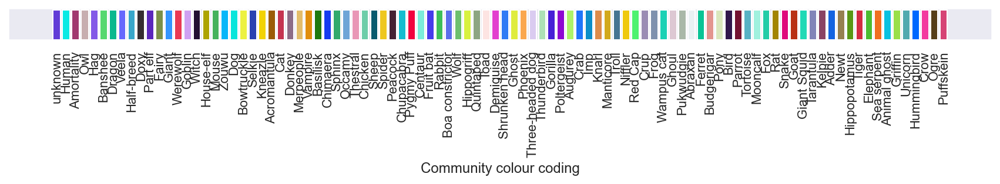

In [108]:
community_key = 'species'
no_communities_species, val_species, mod_species, partition_species, inv_partition_species, colors_species = \
        get_network_communities(community_key, df, GCC)

As expected the modularity score is quite low: 0.032, and the most dominant community is the humans. Thus, this is not a very good partition of the network.

##### Partition according to blood status

Partitioning the Wizarding World according to their blood status might yield better results. After having preprocessed the data, we ended up with only 6 distinct blood statuses. However, 2.839 characters has unknown blood status, making <i>unknown </i> the largest community. <i>Pure-blood</i> and <i>Muggle</i> were quite evenly distributed and will result in two similary communities of size. Lastly, <i>half-blood</i>, <i> muggle-born</i> and <i>squib</i> will all be smaller communities. However, when having such a large community for <i>uknown </i> blood status, the community might not yield that interesting conclusions about the characters, as there are so may other features which can be used to better differentiate between the large group of characters.     

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

Modularity for the partition on blood is 0.10894782794525429



100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:43<00:00, 23.00it/s]


BarnesHut Approximation  took  13.38  seconds
Repulsion forces  took  28.53  seconds
Gravitational forces  took  0.17  seconds
Attraction forces  took  0.15  seconds
AdjustSpeedAndApplyForces step  took  0.67  seconds


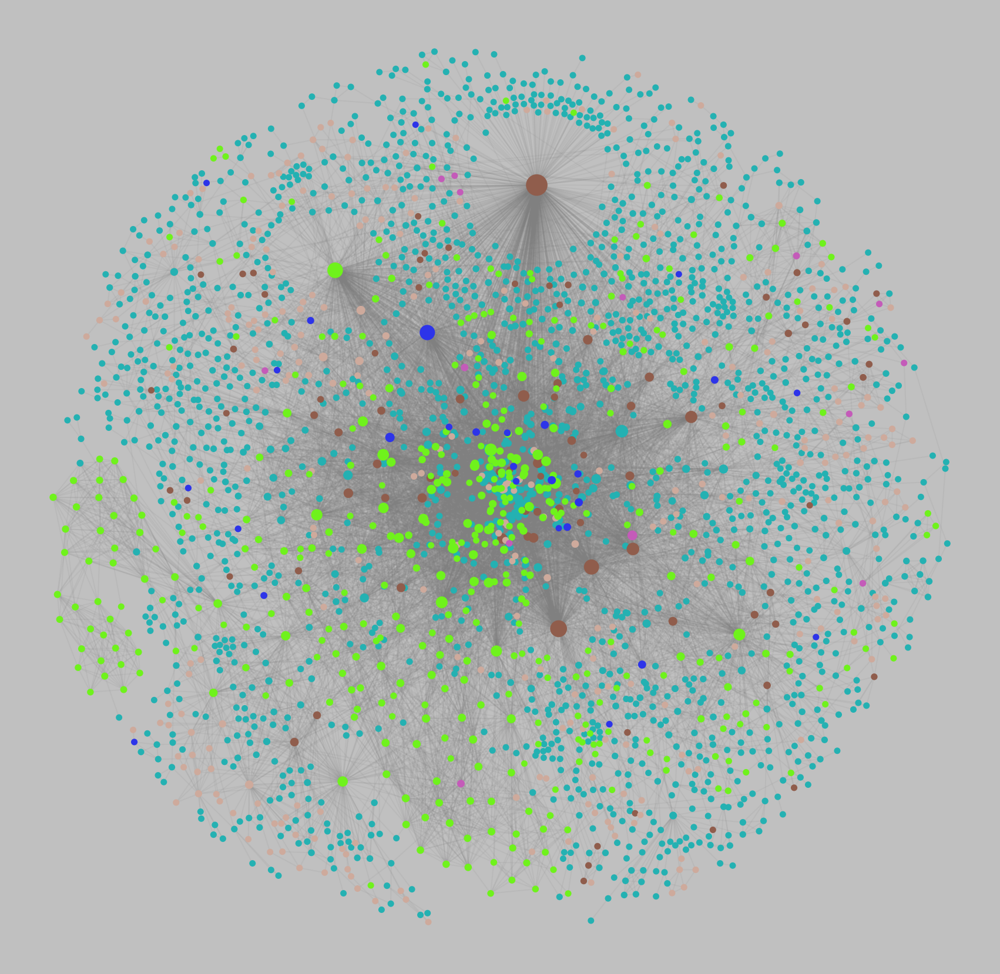

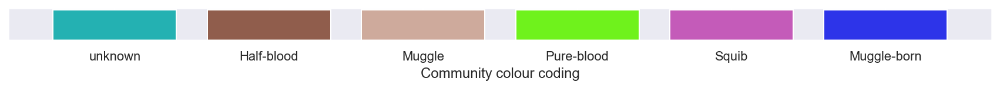

In [109]:
community_key = 'blood'
no_communities_blood, val_blood, mod_blood, partition_blood, inv_partition_blood, colors_blood = \
        get_network_communities(community_key, df, GCC)

As expected the modularity is still quite low: 0.109. Nonetheless, this is the highest modularity obtained so far indicating that currently this partition yields the best results. 

##### Louvian Partition

The Louvain algorithm is an algorithm that finds the partition in a graph, which maximises <i>modularity </i>. The Louvain algorithm assumes that the partition with the highest modularity score, corresponds to the optimal community structure, and thus attempts to optimize this. It is a very efficient algorithm, that allows us to find high-modularity partitions for very large networks, but it is an approximate method that is not guarantied to find the global maximum of modularity. 

The Python function  ```community.best_partition``` computes the partition of the graph giving the highest modularity using the Louvain algorithm and is therefore used in the following. 

NB when running the function, we set ``randomize = False`` to get the same partition every time.  

Modularity for the partition on best is 0.49113303729635777



100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:43<00:00, 23.07it/s]


BarnesHut Approximation  took  13.28  seconds
Repulsion forces  took  28.44  seconds
Gravitational forces  took  0.17  seconds
Attraction forces  took  0.17  seconds
AdjustSpeedAndApplyForces step  took  0.68  seconds


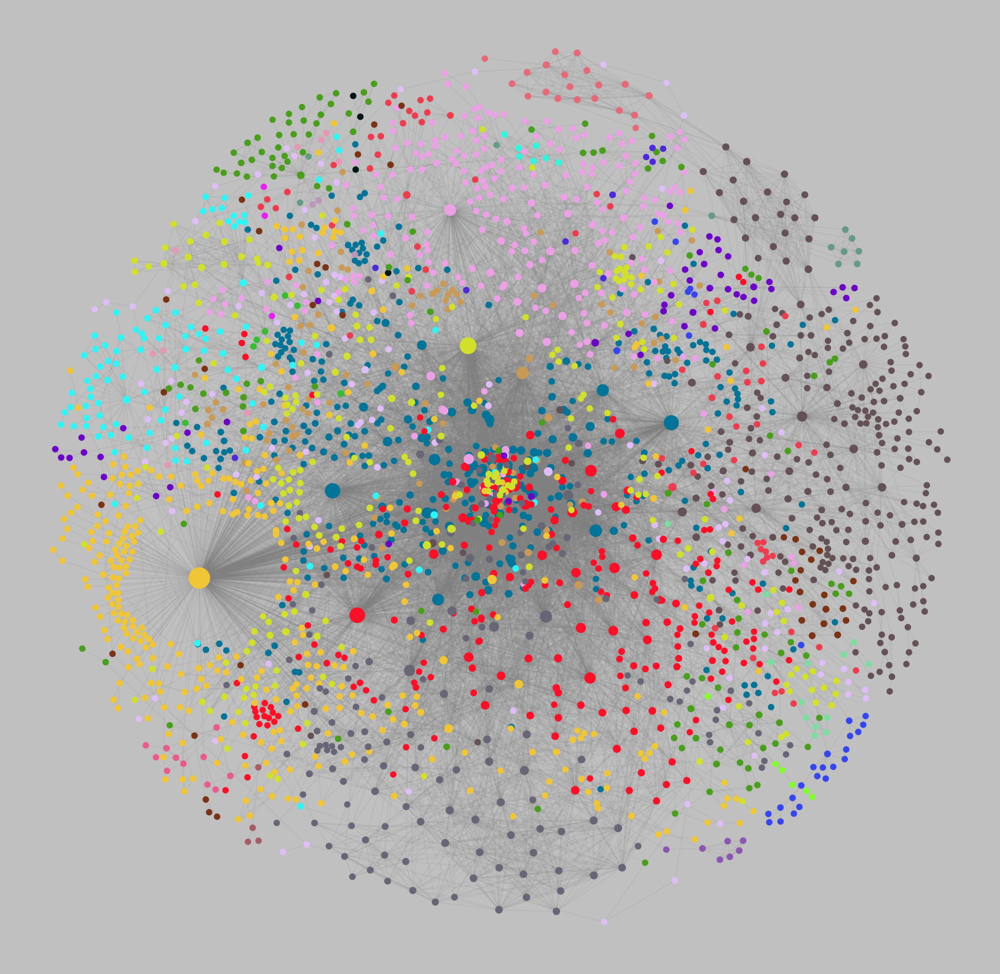

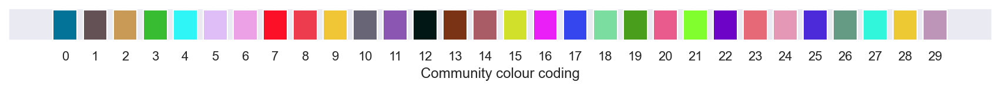

In [110]:
community_key = 'best'
no_communities_best, val_best, mod_best, partition_best, inv_partition_best, colors_best = \
        get_network_communities(community_key, df, GCC)

The Louvian algorithm identifies 30 communities, and this partition gives a modularity score of 0.491. Thus, resulting in the highest modularity score for all the partitions. This shows that even if the features cannot be used to identify meaningful communities in the network, there is a community-like structure in the network for the wizarding world. 

##### Compare the partitions

In [111]:
d = {'Number of communities' : [no_communities_house, no_communities_species, no_communities_blood, no_communities_best], 
     'Size of smallest community' : [np.min(val_house), np.min(val_species), np.min(val_blood), np.min(val_best)],
     'Size of largest community' : [np.max(val_house), np.max(val_species), np.max(val_blood), np.max(val_best)],
     'Modularity' : [mod_house, mod_species, mod_blood, mod_best],
     } 
  
table = pd.DataFrame(d, index=['School Houses', 'Species', 'Blood Status', 'Louvian']) 

table.rename_axis(' ', axis=1, inplace = True)
table

,Number of communities,Size of smallest community,Size of largest community,Modularity
School Houses,9,1,2187,0.082534
Species,96,1,2346,0.032426
Blood Status,6,14,1883,0.108948
Louvian,30,3,439,0.491133


The table shows the properties of the different partitions. Splitting the network into communities based on species is definitely not a good partition. This partition ends up with 96 communities with a range between 1 and up to 2.346 people in a community. The variation in community size is very large. Of the partitions based on node attributes, the best partition is using the blood status, but it only has a slightly higher modularity. However, the sizes of the communities differ from the two previous partitions. The smallest community consists of 14 characters, where the largest contains 1.883 characters. This is still a large spread, but it is an improvement compared to the two previous partitions.   

It is quite clear that the Louvian partition yields the best communities. It has the highest modularity score, with a modularity of almost 0.50. Furthermore, the sizes in communities vary less than the previous partitions, and the largest community only consists of 439 characters compared to e.g. 2.346 characters for the species partition. 

##### Examine best partition further

This subsection of the analysis will focus on examining the best partition of the network a bit further. At first the communities are named according to their top three most connected characters. Then a barplot of the different sizes of the communties will be presented, and lastly the subgraphs of the different communities are shown. 

<b> Name the communities according to most connected characters </b>

In [112]:
def name_communities(G, community_dict):
    '''
    This function names the communities according to their three most connected characters
    Input: networkx graph, dictionary of the communities, with community number as key and list of
           characters in the community as value.
    Output: dictionary with community name (tuple of three most connected characters) as key, and 
            list ofcharacters in the community as value.
    '''
    # get degrees 
    degrees = dict(G.degree)
    degrees.items()
    
    # create empty dict 
    community_dict_w_names = {}
    
    for com in community_dict.keys():
        # list for the degrees for each node
        d_list = []
        # list to hold the top three most connected characters
        top_3_connected = []
        
        # loop over each name in the community
        for n in community_dict[com]:
            d_list.append(degrees[n])
        # find three most connected characters    
        top_3_connected = [name for _,name in sorted(zip(d_list, community_dict[com]), reverse =True)[0:3]] 
        # assign new key value    
        community_dict_w_names[tuple(top_3_connected)] = community_dict[com]
            
    return community_dict_w_names

In [113]:
# Assign community 
nx.set_node_attributes(GCC, inv_partition_best, name = "community")

# name the communities
community_dict_w_names = name_communities(GCC, partition_best)
community_dict_w_names_inv = {l: k for k, v in community_dict_w_names.items() for l in v}
nx.set_node_attributes(GCC, community_dict_w_names_inv, name = "community_names")

# Assign nodal attribute for community colour
colour_communities_character = {k: col for k, v in inv_partition_best.items() \
                                for com, col in colors_best.items() if v == com}

nx.set_node_attributes(GCC, colour_communities_character, name = "color")

Below a barplot of the community sizes can be seen, where the communities are named according to the three most connected characters in the community. 

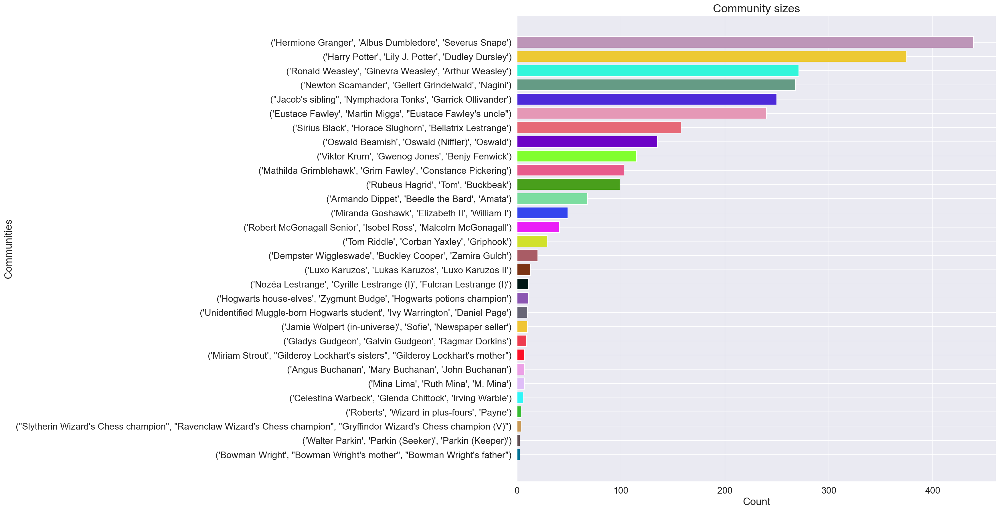

In [114]:
# plot community sizes
bars = pd.DataFrame({'Communities': list(community_dict_w_names.keys()), 'Size': val_best, 
                     'Colours': list(colors_best.values())})

# sort according to size of community
bars.sort_values(by = ['Size'], inplace = True)

plt.figure(figsize=(15,15))
plt.barh(range(no_communities_best), bars["Size"] , color = colors_best.values())
plt.yticks(range(no_communities_best), bars["Communities"], rotation = 0, fontsize = 16)
plt.xticks(fontsize = 16)
plt.xlabel("Count", fontsize = 18)
plt.ylabel("Communities", fontsize = 18)
plt.title('Community sizes', fontsize = 20)
plt.show()

It can be seen that there are two communities with more than 300 characters and 6 communities with more than 200 characters. The sizes of the communities decrease and the majority of the communities have less than 100 characters. The interesting part is that <i> Harry, Ron </i> and <i> Hermione </i> are not in the same community but in three different communities. Hermione is in the same community as Severus Snape and Albus Dumbledore (<i>community 0</i>), Ron is in the same community as his father and sister (and perhaps the remainder of the Weasley family) (<i>community 7</i>), and Harry is in the same community as his mother and cousin (<i>community 9</i>). Below the community subgraphs can be seen, and it is possible to explore the communities more in-depth. 

<b> Interactive graphs for communities: 0, 1, 7 and 9</b>

In [115]:
def normalize(x, min_, max_, a, b):
    return (b-a)*((x-min_)/(max_-min_))+a

# update node-size (otherwise it looks way too big)
a = 20
b = 300

degrees = dict(GCC.degree)
min_ = np.min(list(degrees.values()))
max_ = np.max(list(degrees.values()))
degrees.update((key, normalize(value, min_,max_,a,b)) for key, value in degrees.items())
nx.set_node_attributes(GCC, degrees, 'size')

titles = {}

for name, data in GCC.nodes(data = True):
    title = "<b>" + name + "</b>" +' </br>House: ' + data['house'] +' </br>Gender: ' \
            + data['gender'] + ' </br>Species: ' + data['species'] + ' </br>Bloodstatus: ' \
            + data['blood'] + ' </br>Community: ' + str(data['community'])
    titles[name] = title
nx.set_node_attributes(GCC, titles, 'title')

# Set edge colors 
edge_color = {edge:'lightgrey' for edge in GCC.edges}
nx.set_edge_attributes(GCC, edge_color, "color")

In [116]:
communities = set(partition_best.keys())
for com in communities:
    nodes = [n for n,v in GCC.nodes(data = True) if v['community'] == com]
    globals()['GCC_com_%s' % com] = GCC.subgraph(nodes)
    
    # plot 
    GCC_com_nt = Network(notebook = True,
                         height='600px',
                         width='100%',
                         bgcolor='white',
                         font_color='black',
                         heading='Community {}'.format(com))
    GCC_com_nt.from_nx(globals()['GCC_com_%s' % com])

    GCC_com_nt.force_atlas_2based(overlap = 0,
                         gravity = -111, 
                         central_gravity = 0.02,
                          spring_length =75,
                          spring_strength =0.025, 
                         damping = 1, 
                         )
    GCC_com_nt.toggle_hide_edges_on_drag(True)
    GCC_com_nt.toggle_hide_nodes_on_drag(True)

    GCC_com_nt.set_edge_smooth('curvedCW')

    # save
    GCC_com_nt.save_graph('Data_files/Communities/GCC_com_{}.html'.format(com))

In [117]:
display(IFrame('Data_files/Communities/GCC_com_0.html', 600,650))
display(IFrame('Data_files/Communities/GCC_com_1.html', 600,650))
display(IFrame('Data_files/Communities/GCC_com_7.html', 600,650))
display(IFrame('Data_files/Communities/GCC_com_9.html', 600,650))

It can be seen that <b> Community 0 </b> contains characters such as:
* Hermione Granger, Severus Snape, Albus Dumbledore, Minerva McGonagall, Draco Malfoy, Neville Longbottom

and other Hogwart's characters. 

In <b> Community 1 </b> the largest nodes are:
* Newton Scamander, Gellert Grindewald, Nagini, Credence Barebone and Leta Lestrage. 

All of these characters belong to the <i> Fantastic Beasts universe </i>, with ties to the <i>Harry Potter universe</i>. 

<b> Community 7 </b> consists of:
* The Weasley family (Ron, Ginny, Fred, George, Percy, Molly, Arthur etc.), Alastor Moody, Cornelious Fudge
and other ministry people amongst others. 

Harry Potter is in <b>community 9</b> alongside his mother and cousin. 

It is quite interesting to see that the Louvian partition has indeed found meaningful relations between groups of characters in the network.

In [118]:
sns.reset_orig()

### 3.4 Sentiment analysis <a class="anchor" id="sentiment-analysis"></a>


This section focuses on the sentiment in the Harry Potter books and in the Harry Potter movies. Through the books and movies, we follow Harry Potter and the other students at Hogwarts on their journey from being first-year students to seventh-year students. The characters evolve over time and the story told becomes more elaborate and perhaps even more gloomy as it builds up to the big war in the end. This section is diveded into the two main sections with two subsections each:
* A chapter-based sentiment analysis across the:
    * Eight movies
    * Seven books
* A character-based sentiment analysis across the:
    * Eight movies
    * Seven books

The sentiment analysis will be based on the VADER algorithm. VADER is a lexical and rule-based approach meaning that it has a lexicon (dictionary of sentiment) and rules which is used when assessing the sentiment of words in a sentence. Therefore, VADER is sensitive to both polarity (positive/negative) and intensity (strength). VADER differentiates between negative, neutral and positive sentiments, where these are defined numerically using the compound score. Compound scores for a whole sentence is categorised into:

* Positive sentiment: compound score $\geq 0.05$
* Neutral sentiment: $-0.05 < $compound score $< 0.05$
* Negative sentiment: compound score $\leq -0.05$

(source: https://github.com/cjhutto/vaderSentiment/blob/master/README.rst)

The lexical approach looks at the sentiment score for each word in a sentence and calculates the score of the whole sentence by summing these and normalising.

In [119]:
# define sentiment score analyser
analyzer = SentimentIntensityAnalyzer()

def get_sentiment_score_vader(text):
    '''
    Input: all the sentences said by the character
    Output: average sentiment score for the character
    '''
    # allocate space 
    sentiments = []
    
    # compute the compound score for each sentence said by the character
    for sentence in text:
        word_list = nltk.word_tokenize(sentence)
        lemmatized_output = ' '.join([lemmatizer.lemmatize(w) for w in word_list])
        
        sentiments.append(analyzer.polarity_scores(lemmatized_output)['compound'])
    
    # calculate the average sentiment scores
    return np.mean(sentiments)

#### Load and process the scripts for movies and books

At first the movie dialogue and the books are loaded and saved as a dictionary with dictionaries. The key of the dictionary will be the title of the movie/books, and for the chapter-based approach, the values will be another dictionary with chapter-title as key and list of dialogue/ text as value. For the character-based approach the key in the second dictionary will be the character name. 

##### Movies

In [120]:
# Load data
df_1 = pd.read_csv("Data_files/Data/Movies/HP - Data Kaggle/hp1.csv")
df_2 = pd.read_csv("Data_files/Data/Movies/HP - Data Kaggle/hp2.csv")
df_3 = pd.read_csv("Data_files/Data/Movies/HP - Data Kaggle/hp3.csv")
df_4 = pd.read_csv("Data_files/Data/Movies/HP - Data Kaggle/hp4.csv")
df_5 = pd.read_csv("Data_files/Data/Movies/HP - Data Kaggle/hp5.csv")
df_6 = pd.read_csv("Data_files/Data/Movies/HP - Data Kaggle/hp6.csv")
df_7 = pd.read_csv("Data_files/Data/Movies/HP - Data Kaggle/hp7.csv")
df_8 = pd.read_csv("Data_files/Data/Movies/HP - Data Kaggle/hp8.csv")

# rename Tom Riddle as Voldemort in movie 2
df_2.character.replace("Tom Riddle", "Voldemort", inplace = True)

# display first three rows
display(df_1.head(3))
display(df_2.head(3))
display(df_3.head(3))
display(df_4.head(3))
display(df_5.head(3))
display(df_6.head(3))
display(df_7.head(3))
display(df_8.head(3))

,movie,chapter,character,dialog
0,Harry Potter and the Philosopher's Stone,Doorstep Delivery,Albus Dumbledore,I should have known that you would be here...P...
1,Harry Potter and the Philosopher's Stone,Doorstep Delivery,Minerva McGonagall,"Good evening, Professor Dumbledore. Are the ru..."
2,Harry Potter and the Philosopher's Stone,Doorstep Delivery,Albus Dumbledore,"I'm afraid so, Professor. The good, and the bad."


,movie,chapter,character,dialog
0,Harry Potter and the Chamber of Secrets,In a cage,Harry Potter,"I can't let you out, Hedwig. I'm not allowed t..."
1,Harry Potter and the Chamber of Secrets,In a cage,Vernon Dursley,Harry Potter!
2,Harry Potter and the Chamber of Secrets,In a cage,Harry Potter,Now you've done it.


,movie,chapter,character,dialog
0,Harry Potter and the Prisoner of Azkaban,Under Covers Prologue,Harry Potter,Lumos Maxima. Lumos Maxima. Lumos Maxima. Lumo...
1,Harry Potter and the Prisoner of Azkaban,Aunt Marge's Big Mistake,Petunia Dursley,"Harry! Harry! Harry, open the door! Marge! How..."
2,Harry Potter and the Prisoner of Azkaban,Aunt Marge's Big Mistake,Harry Potter,"Uncle Vernon, I need you to sign this form."


,movie,chapter,character,dialog
0,Harry Potter and the Gobelt of Fire,The Riddle House,Old man,Bloody kids.
1,Harry Potter and the Gobelt of Fire,The Riddle House,Peter Pettigrew,Oh no no no my Lord Voldemort. I only meant......
2,Harry Potter and the Gobelt of Fire,The Riddle House,Voldemort,"NO! The boy is everything, it cannot be done w..."


,movie,chapter,character,dialog
0,Harry Potter and the Order of the Phoenix,Dudley Demented,Dudley Dursley,"Oh, it's you."
1,Harry Potter and the Order of the Phoenix,Dudley Demented,Gang thug,"What should we do with him, Big D?"
2,Harry Potter and the Order of the Phoenix,Dudley Demented,Harry Potter,"Big D? Cool name, but to me, you'll always be ..."


,movie,chapter,character,dialog
0,Harry Potter and the Half-Blood Prince,Snape's Visitors,Bellatrix Lestrange,Narcissa!
1,Harry Potter and the Half-Blood Prince,Snape's Visitors,Bellatrix Lestrange,Cissy! You mustn't do this. He can't be trusted.
2,Harry Potter and the Half-Blood Prince,Snape's Visitors,Narcissa Malfoy,The Dark Lord trusts him.


,movie,chapter,character,dialog
0,Harry Potter and the Deathly Hallows Part 1,Dark Times,Rufus Scrimgeour,"These are dark times, there is no denying. Ou..."
1,Harry Potter and the Deathly Hallows Part 1,Dark Times,Mrs. Granger,"Hermione. Your tea is ready, dear."
2,Harry Potter and the Deathly Hallows Part 1,Dark Times,Hermione Granger,"Coming, Mum."


,movie,chapter,character,dialog
0,Harry Potter and the Deathly Hallows Part 2,Shell Cottage,Luna Lovegood,It's beautiful here.
1,Harry Potter and the Deathly Hallows Part 2,Shell Cottage,Bill Weasley,It was our Aunt's. We used to come here as kid...
2,Harry Potter and the Deathly Hallows Part 2,Shell Cottage,Luna Lovegood,Muggles think these keep evil away. But they'r...


In [121]:
# get dialogue per movie per chapter
dataframes = [df_1, df_2, df_3, df_4, df_5, df_6, df_7, df_8]

# create one dataframe for all movies
df_all = pd.concat(dataframes)
df_all.reset_index(drop = True, inplace = True)

# get list of movie names
movie_names = df_all.movie.unique()

In [122]:
# add movie number
def get_movie_number(x):
    if x == "Harry Potter and the Philosopher's Stone":
        return 1
    elif x == "Harry Potter and the Chamber of Secrets":
        return 2
    elif x == "Harry Potter and the Prisoner of Azkaban":
        return 3
    elif x == "Harry Potter and the Gobelt of Fire":
        return 4
    elif x == "Harry Potter and the Order of the Phoenix":
        return 5
    elif x == "Harry Potter and the Half-Blood Prince":
        return 6
    elif x == "Harry Potter and the Deathly Hallows Part 1":
        return 7
    else:
        return 8

df_all['movie_number'] = df_all['movie'].apply(lambda x: get_movie_number(x))

In [123]:
def remove_nan_from_list(list_):
    '''
    Input: list of dialogue
    Output: list without nan
    '''
    return [v for v in list_ if str(v) != 'nan']
    
# save dialogue for movies 
for movie, data in enumerate(dataframes):
    temp = {chapter: list(data[data['chapter'] == chapter]['dialog']) for chapter in data.chapter.unique()}
    globals()[f"dialogue_chapter_movie{movie+1}"] = {k: remove_nan_from_list(v) for k, v in temp.items()}

# convert to dict of dicts
dialogue_chapters_all = {movie_names[0]: dialogue_chapter_movie1,
     movie_names[1]: dialogue_chapter_movie2,
     movie_names[2]: dialogue_chapter_movie3,
     movie_names[3]: dialogue_chapter_movie4,
     movie_names[4]: dialogue_chapter_movie5, 
     movie_names[5]: dialogue_chapter_movie6, 
     movie_names[6]: dialogue_chapter_movie7, 
     movie_names[7]: dialogue_chapter_movie8}

##### Books

In [124]:
# define path to books
books = ["Data_files/Data/Books/HP-books/Rowling, J.K. - HP 1 - Harry Potter and the Philosopher's Stone.txt",
         "Data_files/Data/Books/HP-books/Rowling, J.K. - HP 2 - Harry Potter and the Chamber of Secrets.txt",
         "Data_files/Data/Books/HP-books/Rowling, J.K. - HP 3 - Harry Potter and the Prisoner of Azkaban.txt",
         "Data_files/Data/Books/HP-books/Rowling, J.K. - HP 4 - Harry Potter and the Goblet of Fire.txt",
         "Data_files/Data/Books/HP-books/Rowling, J.K. - HP 5 - Harry Potter and the Order of the Phoenix.txt",
         "Data_files/Data/Books/HP-books/Rowling, J.K. - HP 6 - Harry Potter and the Half-Blood Prince.txt",
         "Data_files/Data/Books/HP-books/Rowling, J.K. - HP 7 - Harry Potter and the Deathly Hallows.txt"]

<b> Extract text from Harry Potter books using Regex patterns: </b>

For the books the function `data_extract_text_books` is used to extract all the text in each chapter. A regex pattern for finding the chapters in the text is defined:

`pattern = r"(?:Chapter\s+\d+)\n(\b[A-Za-z\.\,\’\'\-]+(?:\s+[A-Za-z\.\,\’\'\-]+)*\b\s*)\n((.|\n)*?)(?=(?:Chapter\s+\d+)|(?:Epilogue\s+)|(?:ENDOFSTORY))"`

If we split it into smaller parts then:

* `(?:Chapter\s+\d+)`: The first capture group finds the places in the text where there written: <i> Chapter </i> one or more spaces (`\s+`) and one or more digits (`\d+`). The start `?:` signifies finding the pattern, but not returning it as part of the result.
* `\n`: There should be a new line in the text
* `(\b[A-Za-z\.\,\’\'\-]+(?:\s+[A-Za-z\.\,\’\'\-]+)*\b\s*)`: The second capture group finds and returns the title of the chapter. `\b` asserts the position at a word boundary. Hereafter, the group `[A-Za-z\.\,\’\'\-]+` illustrates that it is matching a single character in the group one or more times (as there is a + in the end) - thus finding one word. As a title can consist of more than one word, a second group is added `(?:\s+[A-Za-z\.\,\’\'\-]+)*` this group is matched 0 or more times. `?:` is added as we are returning the large capture group (the whole title), and do not want to return the subparts of the title. The last part, `\b\s*`, marks the end of the word boundary and the zero or more spaces might occur in the end. 
* `\n`: There should be a new line in the text
* `((.|\n)*?)`: The third capture group indicate the text within the chapter. This text is matched and returned, as this is the part with the story. 
* `(?=(?:Chapter\s+\d+)|(?:Epilogue\s+)|(?:ENDOFSTORY))`: The last capture group is not returned. This is a look-ahead, indicated by `?=`, as we want to extract all the text from the end of the chapter title until the beginning of the next chapter. Therefore, this pattern looks ahead in the text to find matches of *Chapter xx* or *Epilogue* or *ENDOFSTORY*. *ENDOFSTORY* is written in all of the txt files to indicate that the book stops here.

With this regex pattern it is possible to extract all text in a book and save it chapter wise. Hereafter, the text is set to lower case, punctuations (except the ones which are important for VADER) are remove and lastly the text is tokenised. 

In [127]:
# clean the text 
# find chapters  

pattern = r"(?:Chapter\s+\d+)\n(\b[A-Za-z\.\,\’\'\-]+(?:\s+[A-Za-z\.\,\’\'\-]+)*\b\s*)\n((.|\n)*?)(?=(?:Chapter\s+\d+)|(?:Epilogue\s+)|(?:ENDOFSTORY))"

books_all = defaultdict(dict)

def data_extract_text_books(pattern, books):
    tk = WordPunctTokenizer()

    for book in books:
        # save the title of the book
        title = book[54:-4]
        
        # read the book
        with open(book, 'rb') as f:
            text = f.read().decode('utf-8')
        
        # replace epilogue in book 7 with chapter title
        text = text.replace('Epilogue', 'Chapter 37')
        
        # find all matches
        chapters = re.findall(pattern, text)
        chap = 0

        # loop over all chapters and save the text
        for chapter in chapters:
            chap += 1
            # save the chapter title
            chapter_title = chapter[0]
            chapter_title = chapter_title.replace('\n', ' ')
            
            # save the chapter text
            chapter_text = chapter[1]
            chapter_text = chapter_text.replace('\n', ' ')
            
            # remove phrase from title and add to text
            phrase = ' HE-WHO-MUST-NOT-BE-NAMED RETURNS'
            if phrase in chapter_title:
                chapter_title = chapter_title.replace(phrase, '')
                chapter_text = phrase[1:] + ' I' + chapter_text
            
            # lowercase
            chapter_text = chapter_text.lower()
            
            # remove punctuations (except ? ! which are used by VADER)
            chapter_text = re.sub(r'\n|\t|\.|\,|\;|\:|\’|\“|\”', '', chapter_text)

            # tokenize 
            tokens = tk.tokenize(chapter_text)

            books_all[title][chapter_title] = tokens
    
    return dict(books_all)

In [128]:
# extract text from the books
books_all = data_extract_text_books(pattern, books)

Now the text has been extracted and it is possible to compute the sentiment scores

#### Chapter-based sentiment scores

The chapter-based sentiment scores are found for both movies and books. 

##### Get a sentiment score for all chapters in all movies

In [129]:
# get the sentiment scores for all chapters/ scenes in the movies
sentiment_all_chapters_movies = {}

for idx, movie in enumerate(dialogue_chapters_all.keys()):
    sentiment_all_chapters_movies[movie]  = {chapter: get_sentiment_score_vader(dialogue) for chapter, 
                                                       dialogue in dialogue_chapters_all[movie].items()}

##### Define functions used for plotting sentiment scores (chapter-wise)

In order to visualise the results, some functions needs to be defined. We need to define a function for:
* Getting the indices of the chapters/ scenes (for the x-axis)
* Plotting the average sentiment score across movies/ books
* Plotting a boxplot of the average sentiment scores for the eight movies/ seven books

These can be seen below:

In [130]:
def get_indices(hp_series, sentiment):
    '''
    This function finds the indices for the chapters in the books/movies. This is used for the x-axis in 
    the plots. 
    Input: all scripts for movies/books and the sentiment score 
    Output: indices for each movie/ book (indices based on chapters)
    '''
    indices = {}
    idx = 0

    # Find the extreme cases of sentiment scores
    min_val = []
    min_val_pos = []
    chap_min = []

    max_val = []
    max_val_pos = []
    chap_max = []

    for serie in hp_series:
        start = idx
        # get the chapter with min/max sentiment score
        chap_w_min_sentiment = min(sentiment[serie], key=sentiment[serie].get)
        chap_w_max_sentiment = max(sentiment[serie], key=sentiment[serie].get)
        # save the chapter title and sentiment score
        chap_min.append(chap_w_min_sentiment)
        chap_max.append(chap_w_max_sentiment)
        min_val.append(sentiment[serie][chap_w_min_sentiment])
        max_val.append(sentiment[serie][chap_w_max_sentiment])
        
        # save the position (x-axis) of min/max chapter
        for chapter in hp_series[serie]:
            idx += 1
            if chapter == chap_w_min_sentiment:
                min_val_pos.append(idx)
            elif chapter == chap_w_max_sentiment:
                max_val_pos.append(idx)
        # save indices
        indices[serie] = (start, idx)

    return indices, min_val, min_val_pos, max_val, max_val_pos, chap_min, chap_max

# function for calculating moving average
def movingaverage(interval, window_size):
    '''
    This function calculates the moving average
    Input: all sentiment scores across all movies/books (flattened list),
           window size moving average should be calculated on
    Output: moving average
    '''
    window = np.ones(int(window_size))/float(window_size)
    return np.convolve(interval, window, 'same')

In [131]:
# plot sentiment scores acroos movies/ books
def chapter_sentiment_plot(hp_series, sentiment, indices, min_val, min_val_pos, max_val, max_val_pos, chap_min, chap_max, _type):
    '''
    This function plots the chapter-based sentiment scores with a moving average
    Input: all scripts for movies/books, sentiment scores, indices and min/max scores and positions for these
    Output: plot of sentiment score across all chapters in movies/books with a moving average
    '''
    length = sum([len(hp_series[serie]) for serie in hp_series])
    x = np.linspace(0, length - 1, num = length)

    # save plots
    if _type == 'Movies':
        name = 'Data_files/Pictures/chap_sentiment_movies.png'
        legend_place = 'lower right'
    else:
        name = 'Data_files/Pictures/chap_sentiment_books.png'
        legend_place = 'lower left'

    # flatten list of sentiment scores (use for moving average)    
    flatten_sentiment_all_chapters = []
    for key in sentiment.keys():
        flatten_sentiment_all_chapters += list(sentiment[key].values())
            
    plt.figure(figsize=(20, 20))

    # plot chapter-based sentiment scores for each movie/ book
    for idx, serie in enumerate(indices):
        # position of annotations of min/max chapters
        if _type == 'Movies':
            if idx == 2:
                shift = 0.1
            elif idx == 3:
                shift = 0.04
            elif idx == 4:
                shift = 0.01
            else:
                shift = 0.02

            shift_s = -15
        else:
            shift = 0.0005
            shift_s = -11
        # plot sentiment for movie/book 
        plt.plot(x[indices[serie][0]: indices[serie][1]],
                 list(sentiment[serie].values()),
                 label=serie, linewidth = 2.5)
        
        # annotate chapters
        plt.text(min_val_pos[idx]+shift_s, min_val[idx]-shift, chap_min[idx], fontsize=18)
        # shift anotation for last chapter in movie 8/book 7
        if idx == len(indices)-1:
            plt.text(max_val_pos[idx]+shift_s-8, max_val[idx]+shift, chap_max[idx], fontsize=18)
        else:
            plt.text(max_val_pos[idx]+shift_s, max_val[idx]+shift, chap_max[idx], fontsize=18)
    # plot moving average
    plt.plot(movingaverage(flatten_sentiment_all_chapters, 10), color='k', linewidth=3, linestyle=':', label = 'Moving Average')
    # add x-axis
    plt.axhline(y=0, xmin=0, xmax=length, alpha=.25, color='r', linestyle='--', linewidth=3)
    # add legend, title, xlabel, ylabel
    plt.legend(loc=legend_place, fontsize = 18)
    plt.title('Chapter Sentiment of the Harry Potter {}'.format(_type), fontsize=26)
    plt.xlabel(_type, fontsize = 22)
    plt.xticks(fontsize = 20)
    plt.ylabel('Average Sentiment', fontsize = 22)
    plt.yticks(fontsize = 20)
    
    # plot vertical lines marking the books/ movies
    for serie in indices:
        plt.axvline(x = indices[serie][0], color = 'darkgrey', linewidth = 1, linestyle=':')
    plt.axvline(x = indices[serie][1]-1, color = 'darkgrey', linewidth = 1, linestyle=':')

    # change xticks to movie/book title
    plt.xticks([(indices[serie][0] + indices[serie][1])/2 for serie in indices],
           list(hp_series), rotation=-75, fontsize=20, ha='left')
    
    plt.tight_layout()
    
    plt.savefig(name, bbox_inches = 'tight')
        
    plt.show()

In [132]:
def plot_boxplot(sentiment, _type):
    '''
    This function plots a boxplot for the sentiment scores for the seven books/ eight movies
    Input: sentiment scores
    Output: boxplot of scores chapter-based sentiment 
    '''
    # save plots
    if _type == 'Movies':
        name = "Data_files/Pictures/boxplot_sentiment_movies.png"
    else:
        name = "Data_files/Pictures/boxplot_sentiment_books.png"

    fig, ax = plt.subplots(figsize = (15, 13))
    # make boxplot of sentiment scores 
    bplot = ax.boxplot(sentiment.values(), vert=True, patch_artist=True)
    
    # set title, labels etc. 
    ax.set_title('Box plot of sentiments for the Harry Potter {}'.format(_type), fontsize = 26)
    ax.set_xlabel(_type, fontsize = 22)
    ax.set_ylabel('Average sentiment', fontsize = 22)
    ax.yaxis.set_tick_params(labelsize = 20)
    ax.set_xticklabels(sentiment.keys(), rotation = -75, fontsize = 20)

    # define colors
    if _type == "Movies":
        colors = ['plum', 'purple', 'violet', 'lightblue', 'skyblue', 'teal', 'seagreen', 'forestgreen']
    else:
        colors = ['plum', 'purple', 'violet', 'lightblue', 'skyblue', 'teal', 'seagreen']
    # fill with colors
    for patch, color in zip(bplot['boxes'], colors):
        patch.set_facecolor(color)

    plt.tight_layout()
    
    # save the figure
    plt.savefig(name, bbox_inches = 'tight')

    plt.show()

##### Plot the development in sentiment score across the movies (chapter-wise)

The temporal development in sentiment scores across the movies can be seen below.

In [133]:
# get movie indices and scenes with max/min sentiment score
movie_indices, min_val_m, min_val_pos_m, max_val_m, max_val_pos_m, chap_min_m, chap_max_m = \
                                                    get_indices(dialogue_chapters_all, sentiment_all_chapters_movies)
movie_indices

{"Harry Potter and the Philosopher's Stone": (0, 34),
 'Harry Potter and the Chamber of Secrets': (34, 74),
 'Harry Potter and the Prisoner of Azkaban': (74, 107),
 'Harry Potter and the Gobelt of Fire': (107, 135),
 'Harry Potter and the Order of the Phoenix': (135, 162),
 'Harry Potter and the Half-Blood Prince': (162, 188),
 'Harry Potter and the Deathly Hallows Part 1': (188, 213),
 'Harry Potter and the Deathly Hallows Part 2': (213, 239)}

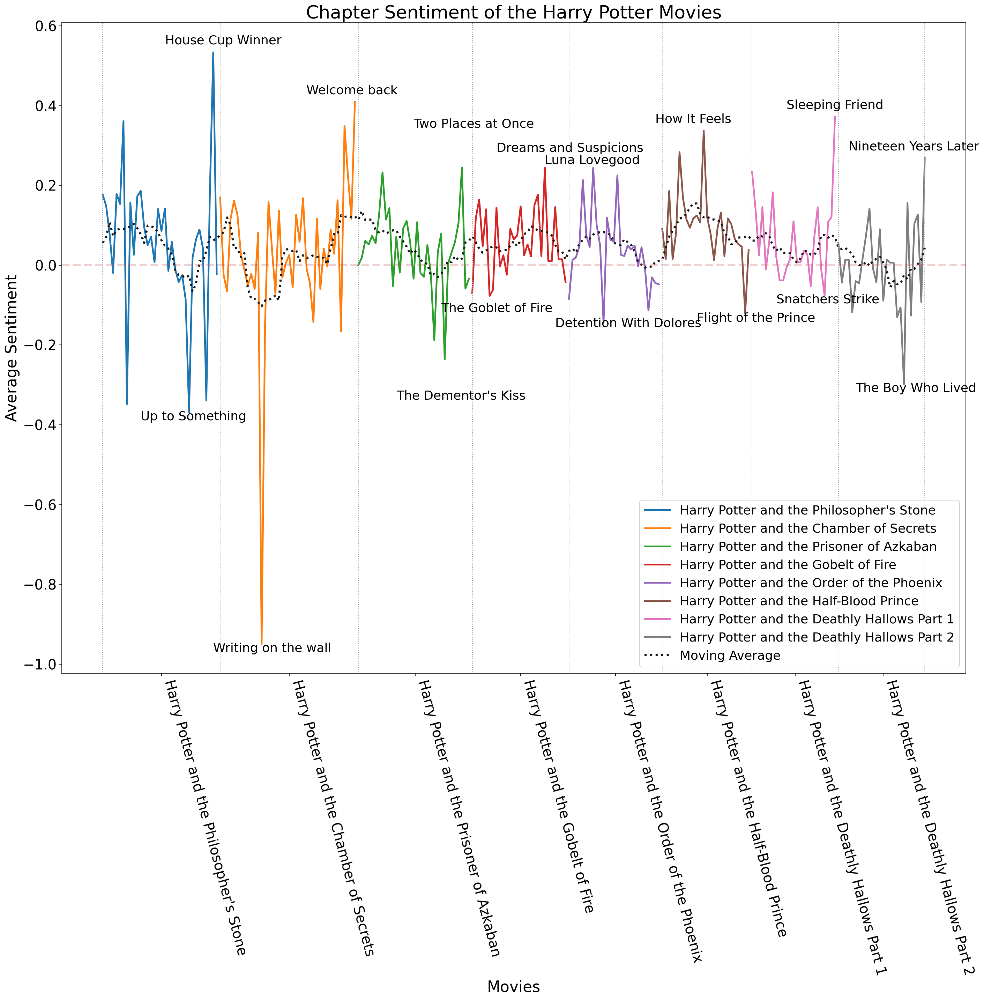

In [134]:
# plot sentiment scores
chapter_sentiment_plot(dialogue_chapters_all, sentiment_all_chapters_movies, movie_indices, min_val_m, min_val_pos_m, max_val_m, max_val_pos_m, chap_min_m, chap_max_m, "Movies")

A sentiment score has been found for all scenes in the eight movies. The y-axis is in the range from -1 to 0,6 (on a scale from -1 to 1), which indicates that there are powerful emotions in the movies. The most negative scene is the <i>Writting on the Wall</i> in movie 2. When examining the scene it can be found that it only includes the basilisk saying: <b>"Kill!"</b> and the sentiment score is therefore very negative. The most positive scene is in movie 1, where Gryffindor wins the house cup. The sentiment score for this scene is almost 0,6. Besides the very extreme cases just described, the sentiment scores across the movies are in a range from -0,4 to 0,4, with fluctuations across the movies. 

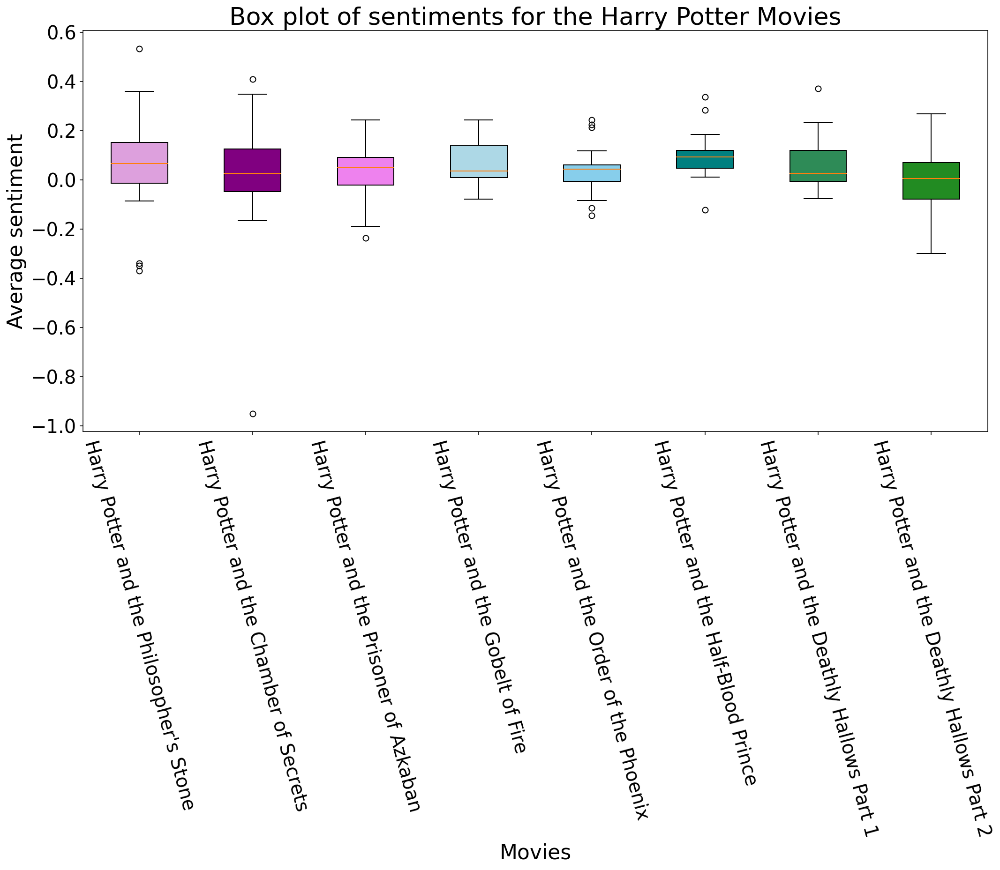

In [135]:
# get boxplot
sentiment_movies = {movie: list(sentiment_all_chapters_movies[movie].values()) for movie in sentiment_all_chapters_movies.keys()}
plot_boxplot(sentiment_movies, "Movies")

The boxplots show the chapter based average sentiment score for the movies. With this visualisation it is possible to observe more outliers (chapters with an average sentiment score outside the upper and lower fence). This is especially the case for the 1st, 5th and 6th movie. This could indicate that Hollywood increase the level of sadness/ happiness when producing the movies as big emotions are what the viewers want. Movies also have to fit a certain length and each scene has to move the plot forward, which could explain why some of the scenes in the movie have a quite extreme sentiment. 

##### Get a sentiment score for all chapters in all books

In [136]:
# get the sentiment scores for all chapters/ scenes in the books
sentiment_all_chapters_books = {}

for book in books_all.keys():
    sentiment_all_chapters_books[book]  = {chapter: get_sentiment_score_vader(dialogue) \
                                           for chapter, dialogue in books_all[book].items()}

##### Plot the development in sentiment score across the books (chapter-wise)

The temporal development in sentiment scores across the books can be seen below.

In [137]:
# get book indices and chapter with max/min sentiment score
book_indices, min_val_b, min_val_pos_b, max_val_b, max_val_pos_b, chap_min_b, chap_max_b = \
                                                    get_indices(books_all, sentiment_all_chapters_books)
book_indices

{"Harry Potter and the Philosopher's Stone": (0, 17),
 'Harry Potter and the Chamber of Secrets': (17, 35),
 'Harry Potter and the Prisoner of Azkaban': (35, 57),
 'Harry Potter and the Goblet of Fire': (57, 94),
 'Harry Potter and the Order of the Phoenix': (94, 132),
 'Harry Potter and the Half-Blood Prince': (132, 162),
 'Harry Potter and the Deathly Hallows': (162, 199)}

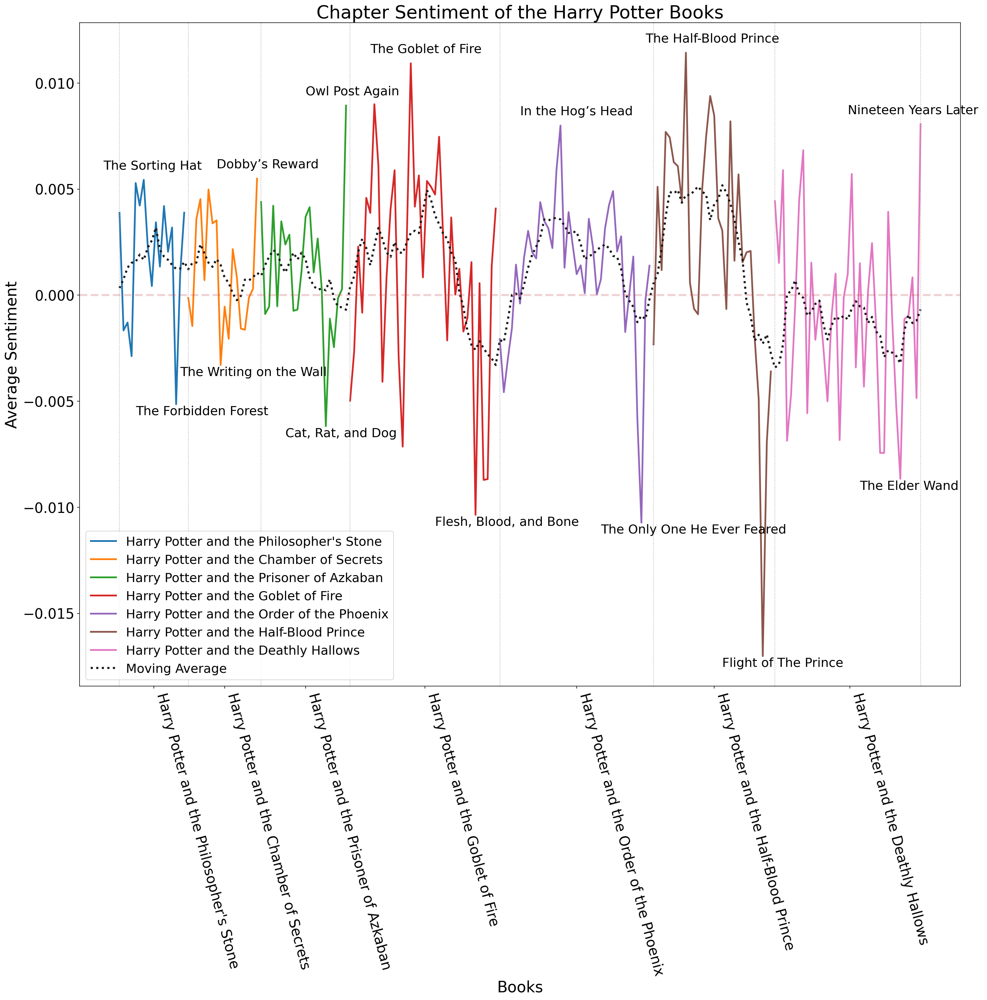

In [138]:
# plot sentiment scores
chapter_sentiment_plot(books_all, sentiment_all_chapters_books, book_indices, min_val_b, 
                       min_val_pos_b, max_val_b, max_val_pos_b, chap_min_b, chap_max_b, 'Books')

When examining the plot above it can be seen that the most negative chapter is the chapter with Dumbledore's death and the flight of the Half-Blood prince (Severus Snape) and the Death Eaters. When looking at the development in sentiment scores, it can be seen that the first books (book 1, 2, 3 and 4) all have a more "happy ending", where Harry and his friends overcome the obstacle and something good happens to them in the end. However, books 5 and 6 do not have the same "happy ending", and they end on a more gloomy note. Furthermore, it can be seen that there are larger fluctuations in the chapters' sentiment scores from book 4 and onwards. This could be due to the fact that the obstacles are more difficult, Voldemort returns and the characters are older. Thus, there are more ups and downs, friendship and relationship drama etc. in the later stories.

When comparing the plot above for the books to the same plot for the movies, it can be seen that the y-axis is much smaller for the books, indicating that the sentiment scores across the books are less "extreme" than for the movies. 

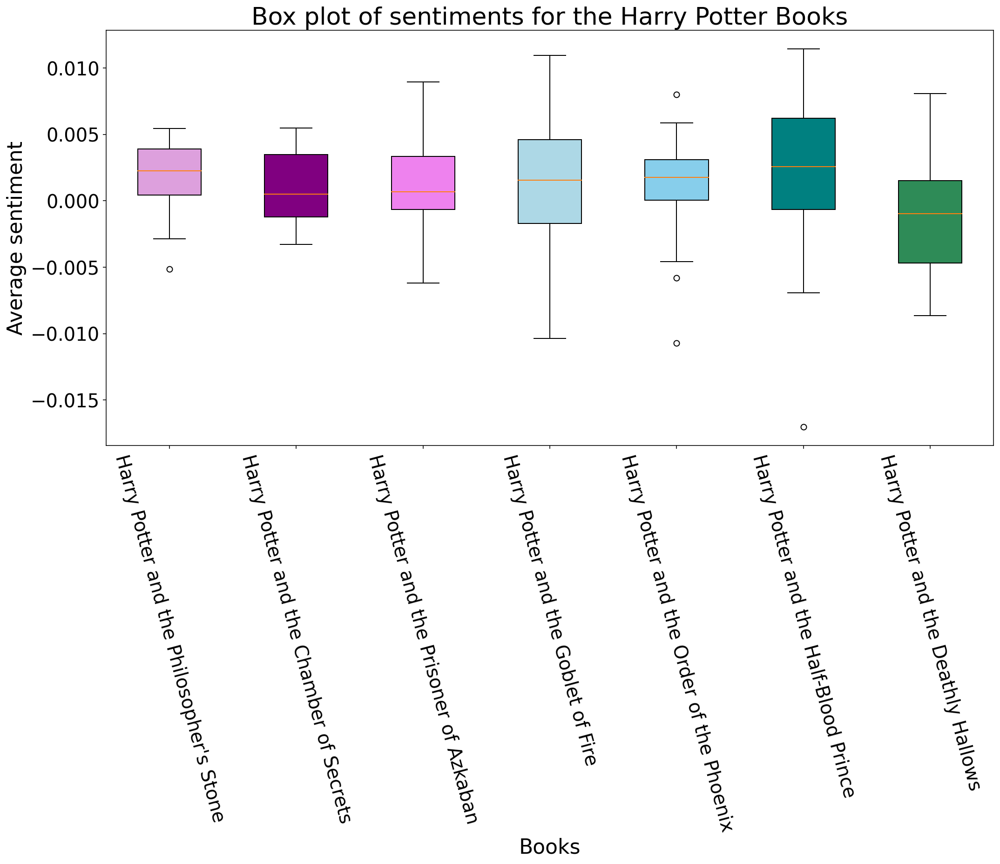

In [139]:
# get boxplot
sentiment_books = {book: list(sentiment_all_chapters_books[book].values()) for book in sentiment_all_chapters_books.keys()}
plot_boxplot(sentiment_books, "Books")

The boxplots show the chapter based average sentiment score for the books. It can be seen that there are less outliers than for the movies. Above it can be seen, that there are only outliers present for the 1st and 5th book, with only 1 and 3 chapters as outliers respectivly. Each observation for the books is based on more tokens than for the movies and it is more likely that an entire book-chapter will have both happy and sad passages thus balancing the sentiment score more and resulting in fewer outliers.

#### Character-based sentiment scores

The character-based sentiment scores are found for both movies and books. As the <i>Harry Potter universe </i> consists of many characters, we have decided to examining the sentiment scores for the top 10 most connected characters across the movies and books. 

The top ten most connected characters are:

<i>Harry Potter, Voldemort, Ron Weasley, Hermione Granger, Draco Malfoy, Sirius Black, Rubeus Hagrid, Severus Snape, Albus Dumbledore, Minerva McGonagall</i>

Firstly, the dialogue for these 10 characters for each movie/ book are extracted, then the sentiment score is computed and visualised. 

In [140]:
# get dialogue for all the characters for the movies
for movie, data in enumerate(dataframes):
    temp = {name: list(data[data['character'] == name]['dialog']) for name in np.unique(data.character)}
    globals()[f"dialogue_movie{movie+1}"] = {k: remove_nan_from_list(v) for k, v in temp.items()}

dialogues_all_movies = {movie_names[0]: dialogue_movie1,
     movie_names[1]: dialogue_movie2,
     movie_names[2]: dialogue_movie3,
     movie_names[3]: dialogue_movie4,
     movie_names[4]: dialogue_movie5, 
     movie_names[5]: dialogue_movie6, 
     movie_names[6]: dialogue_movie7, 
     movie_names[7]: dialogue_movie8}

The text used to calculate the sentiment scores for the characters are found using the function `get_text_characters`. In the function the text is found by extracting the $n$ words surrounding a character's name and saving it in a dictionary. In order to find the $n$ words on each side of one of the 10 characters' name the `nltk.ngrams` function is used where each ngram has a length of $2 \cdot n+1$. This is the case as we want $n$ words on each side of the name $(2 \cdot n$) excluding the name itselv ($2 \cdot n + 1$). We define which names and nicknames should be the $n$th word, and we might therefore have missed some names. If one of the 10 character names is mentioned in the book with less than $n$ words to the end of the book, this part of the text will not be included.

The text used is a flattened version of the dictionary *books_all* previously extracted. The dictionary is flattend such that each key (book) only has one value, namely a list of words in the book instead of a dictionary for each chapter with a list of words in each chapter as previously defined.

In [141]:
# get dialogue for all the characters for the books
def get_text_characters(text, n):
    '''
    This function finds and extract the n words surrounding a character's name and save it in a dict
    Input: tokens in book, number of words to exract in each side of character's name
    Output: text for top 10 characters
    '''
    # allocate space
    text_dict = defaultdict(list)

    # find ngrams of length n on each side of the character name
    for ngram in nltk.ngrams(text, 2*n+1):
        # harry potter
        if ((ngram[n] == "harry") | 
            ((ngram[n] == "mr") & (ngram[n+1] == "potter")) | 
            (ngram[n] == "potter")):
            # save the ngram
            text_dict['Harry Potter'] += [word for word in list(ngram) if word not in ['harry', 'potter']]
        # ron weasley
        elif ((ngram[n] == "ron") | 
              (ngram[n] == "ronald")):
            # save the ngram
            text_dict['Ron Weasley'] += [word for word in list(ngram) if word not in ['ron', 'ronald']]
        # voldemort
        elif (((ngram[n] == "tom") & (ngram[n+1] == "riddle")) |
              (ngram[n] == "voldemort")|
              ((ngram[n] == "dark") & (ngram[n+1] == "lord")) |
              ((ngram[n] == "he") & (ngram[n+1] == "-") & (ngram[n+2] == "who") & (ngram[n+3] == "-") &
              (ngram[n+4] == "must") & (ngram[n+5] == "-") & (ngram[n+6] == "not") & (ngram[n+7] == "-") &
              (ngram[n+8] == "be") & (ngram[n+9] == "-") & (ngram[n+10] == "named"))|
              ((ngram[n] == "you") & (ngram[n+1] == "-") & (ngram[n+2] == "know") & 
              (ngram[n+3] == "-") & (ngram[n+4] == "who"))):
            # save the ngram
            text_dict['Voldemort'] += [word for word in list(ngram) if word not in ['voldemort', 'riddle']]
        # hermione granger
        elif ((ngram[n] == "hermione") | 
              ((ngram[n] == "miss") & (ngram[n+1] == "granger"))):
            # save the ngram
            text_dict['Hermione Granger'] += [word for word in list(ngram) if word not in ['hermione', 'granger']]
        # sirius black
        elif ((ngram[n] == "sirius") | 
            ((ngram[n] == "mr") & (ngram[n+1] == "black")) | 
            #(ngram[n] == "black") |
             (ngram[n] == "padfoot")):
            # save the ngram
            text_dict['Sirius Black'] += [word for word in list(ngram) if word not in ['sirius', 'black']]
        # hagrid
        elif ((ngram[n] == "rubeus") | 
            (ngram[n] == "hagrid")):
            # save the ngram
            text_dict['Rubeus Hagrid'] += [word for word in list(ngram) if word not in ['rubeus', 'hagrid']]
        # snape
        elif ((ngram[n] == "severus") | 
            (ngram[n] == "snape")):
            # save the ngram
            text_dict['Severus Snape'] += [word for word in list(ngram) if word not in ['severus', 'snape']]
        # dumbledore
        elif ((ngram[n] == "albus") | 
            (ngram[n] == "dumbledore")):
            # save the ngram
            text_dict['Albus Dumbledore'] += [word for word in list(ngram) if word not in ['albus', 'dumbledore']]
        # maccgonagall
        elif ((ngram[n] == "minerva") | 
            (ngram[n] == "mcgonagall")):
            # save the ngram
            text_dict['Minerva McGonagall'] += [word for word in list(ngram) if word not in ['minerva', 'mcgonagall']]
        # draco malfoy
        elif ((ngram[n] == "draco") | 
            (ngram[n] == "malfoy")):
            # save the ngram
            text_dict['Draco Malfoy'] += [word for word in list(ngram) if word not in ['draco', 'malfoy']]
    
    return dict(text_dict)

In [142]:
# get text for top 10 most connected characters
all_books_top_10_char = {}
for book in books_all.keys():
    tokens_book = list(itertools.chain(*books_all[book].values()))
    all_books_top_10_char[book] = get_text_characters(tokens_book, 50)

##### Get a sentiment score for all characters in all movies

The dialogues have been extracted and it is now possible to compute the sentiment score using the `get_sentiment_score_vader` function defined previously. 

In [143]:
# get the sentiment scores for the characters for each movie
sentiment_characters_movies = {}

for idx, movie in enumerate(dialogues_all_movies.keys()):
    sentiment_characters_movies[movie]  = {name: get_sentiment_score_vader(dialogue) for name, 
                                                       dialogue in dialogues_all_movies[movie].items()}

# define top 10 most connected characters
top_10_char = ['Harry Potter', 'Voldemort', 'Ron Weasley', 'Hermione Granger', 'Draco Malfoy', 'Sirius Black', 
               'Rubeus Hagrid', 'Severus Snape', 'Albus Dumbledore', 'Minerva McGonagall']

# only look at top 10 most connected characters
sentiment_top_10_characters_movies = defaultdict(dict)

# get sentiment score for top 10 most connected characters
for movie in sentiment_characters_movies.keys():
    for character in sentiment_characters_movies[movie]:
        if character in top_10_char:
            sentiment_top_10_characters_movies[movie][character] = sentiment_characters_movies[movie][character]
    
    # if character in top_10_char has no dialogue in the movie then assign np.nan value 
    for character in top_10_char:
        if character not in list(sentiment_top_10_characters_movies[movie].keys()):
            sentiment_top_10_characters_movies[movie][character] = np.nan
            
sentiment_top_10_characters_movies = dict(sentiment_top_10_characters_movies)

##### Define functions used for plotting sentiment scores (character-wise)

In order to visualise the results we define a function for plotting the average sentiment score across movies/ books for the 10 characters.

In [144]:
# create plot for sentiment score for top 10 characters over the movies
def character_sentiment_plot(hp_series, top_10_char, sentiment, indices, _type): 
    '''
    This function plots the character-based sentiment scores 
    Input: all scripts for movies/books, top 10 character, sentiment scores, indices 
    Output: plot of sentiment score across movies/books for top 10 most connected characters
    '''
    
    length = sum([len(hp_series)])
    x = np.linspace(1, length, num = length)
    titles = list(hp_series.keys())
    
    # save plots
    if _type == 'Movies':
        name = 'Data_files/Pictures/char_sentiment_movies.png'
    else:
        name = 'Data_files/Pictures/char_sentiment_books.png'
        
    plt.figure(figsize=(20, 20))
    # plot character-based sentiment scores for each movie/ book
    for character in top_10_char:
        # flatten sentiment score for all characters
        flatten_sentiment_all = []
        for serie in indices:
            flatten_sentiment_all.append(sentiment[serie][character])
        # plot sentiment score for all movies for character
        plt.plot(x,flatten_sentiment_all, label=character, linewidth = 2.5, alpha = 0.8)
    # add x-axis
    plt.axhline(y=0, xmin=0, xmax=length, alpha=.25, color='r', linestyle='--', linewidth=3)
    # add legend, title, xlabel, xticks
    plt.legend(loc='lower left', fontsize = 20)
    plt.title('Character Sentiment of the Harry Potter {} for top 10 characters'.format(_type), fontsize=26)
    plt.xlabel(_type, fontsize = 22)
    plt.xticks(x, titles, fontsize = 20, rotation = -75)
    
    # Plot vertical lines marking the movie/books
    for book in x:
        plt.axvline(x = book, color='darkgrey', linewidth=1, linestyle=':')
    # add ylabel
    plt.ylabel('Average Sentiment', fontsize = 22)
    plt.yticks(fontsize = 20)
    
    plt.tight_layout()
    
    plt.savefig(name, bbox_inches = 'tight')
        
    plt.show()

##### Plot the development in sentiment score across the movies (character-wise)

The temporal development in the characters' average sentiment scores across the movies can be seen below.

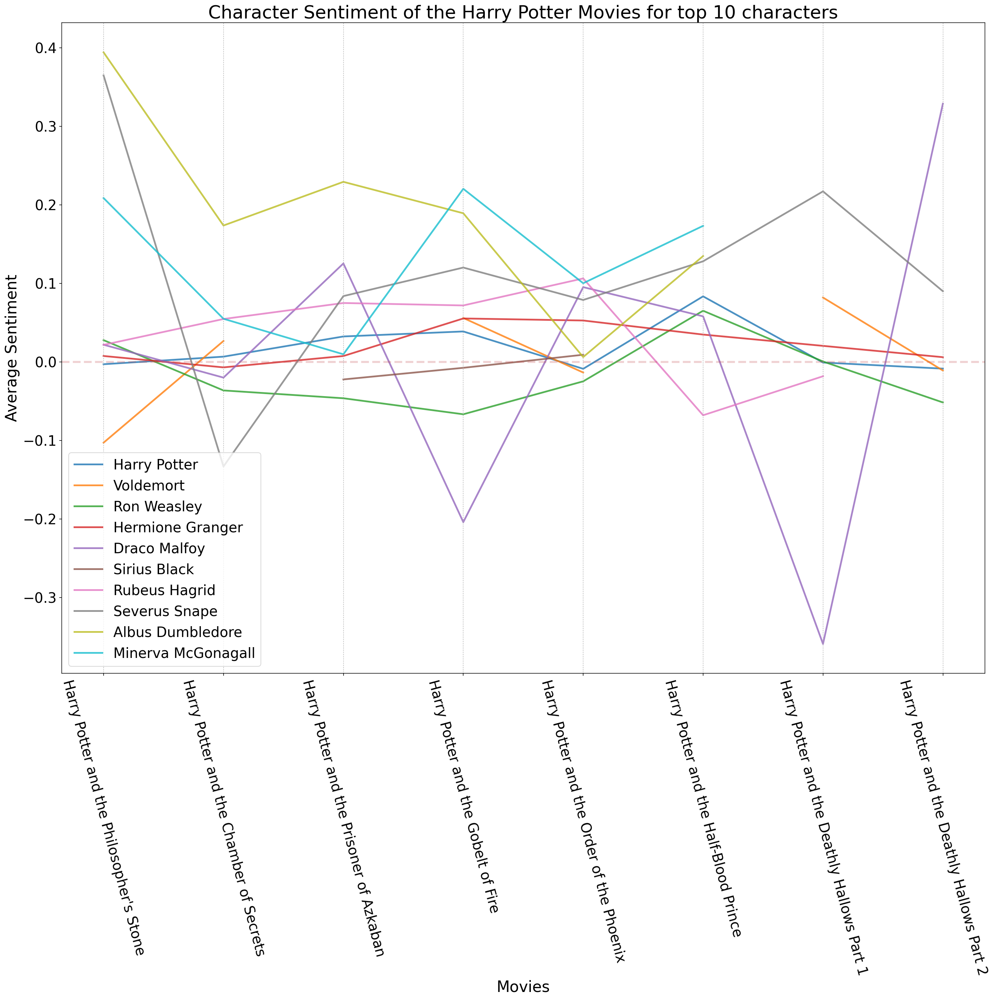

In [145]:
character_sentiment_plot(dialogue_chapters_all, top_10_char, sentiment_top_10_characters_movies, movie_indices, 'Movies')

The plot above shows the average sentiment score for each of the top 10 most connected characters in the <i> Harry Potter universe</i> for the eight movies. It can be seen that there are some gaps for e.g. Sirius Black and Voldemort. This is because the characters do not have any dialogue in the given movie. Draco Malfoy has quite a low sentiment score in <i>Harry Potter and the Dealthly Hallows Part 1</i>, which indicates that he is very unhappy. This is consistent with the plot of the movie, as the Malfoy family is being punished by Lord Voldemort, and Draco Malfoy expresses much fear, sadness and anger in the movie. 

##### Get a sentiment score for all characters in all books

The dialogues have been extracted and it is now possible to compute the sentiment score using the `get_sentiment_score_vader` function defined previously. 

In [146]:
# get the sentiment scores for the characters for each book
sentiment_10_characters_books = {}

# get sentiment score for top 10 most connected characters
for book in all_books_top_10_char.keys():
    sentiment_10_characters_books[book]  = {name: get_sentiment_score_vader(dialogue) \
                                           for name, dialogue in all_books_top_10_char[book].items()}
    # if character in top_10_char has no dialogue in the movie then assign np.nan value 
    for name in top_10_char:
        if name not in list(sentiment_10_characters_books[book].keys()):
            sentiment_10_characters_books[book][name] = np.nan

##### Plot the development in sentiment score across the books (character-wise)

The temporal development in the characters' average sentiment scores across the books can be seen below.

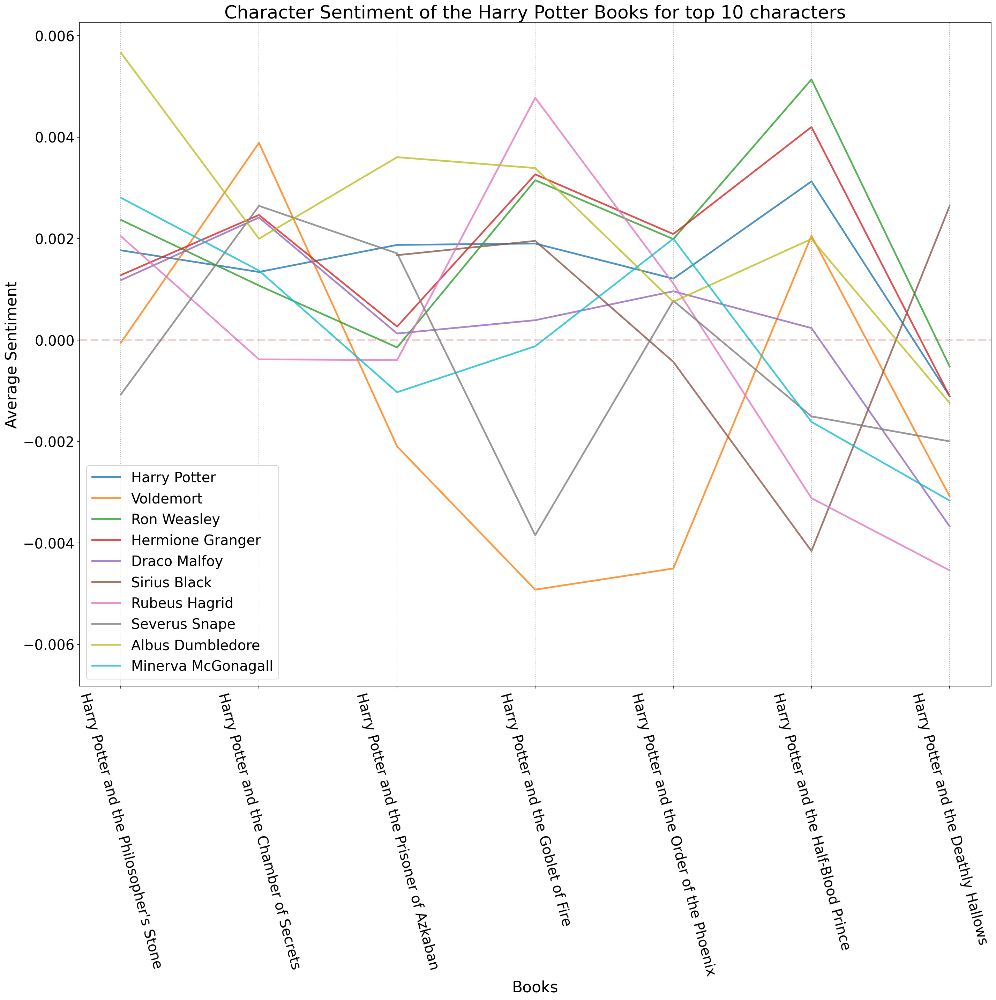

In [147]:
character_sentiment_plot(all_books_top_10_char, top_10_char, sentiment_10_characters_books, book_indices, 'Books')

The plot above shows the average sentiment score for each of the top 10 most connected characters in the <i> Harry Potter universe</i> for the seven books. It can be seen that there is a gap for Sirius Black for book 1 and book 2. This is because Sirius Black has not yet been introduced to the reader. 
In <i>Harry Potter and the Half-Blood Prince</i> both Harry and Ron have their personally highest average sentiment score. This might have something to do with their crushes and relationships with Ginny and Lavender (and secretively Hermione).

The insights gained from this sentiment analysis are quite fun and accurate. The plot shows that Rubeus Hagrid has the highest sentiment score in <i> Harry Potter and the Goblet of Fire</i>, which makes sense as this is the book where Hagrid falls in love with Madame Maxime. Furthermore, one of the challenges in the Triwizard Tournament includeds dragons, which are one of Hagrid favorite magical creatures.  

#### Comparison of the books vs. movies

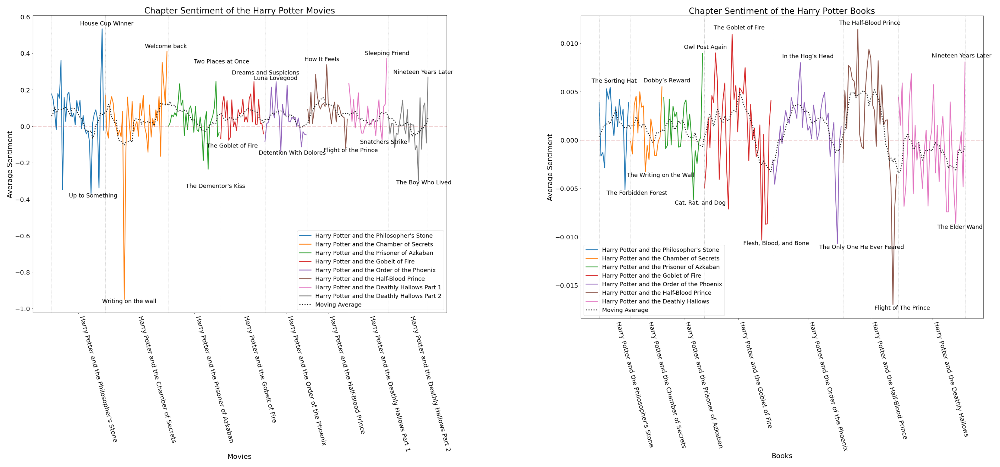

In [148]:
from pylab import imshow
import matplotlib.image as mpimg

fig, ax = plt.subplots(1,2,figsize = (25, 20))

ax[0].imshow(mpimg.imread('Data_files/Pictures/chap_sentiment_movies.png'))
ax[0].axis('off')
ax[1].imshow(mpimg.imread('Data_files/Pictures/chap_sentiment_books.png'))
ax[1].axis('off')       

plt.show()

Both the sentiment analysis for the movies and the books yielded interesting and informative results. From the analysis it was clear that the sentiment fluctuated across the whole series and it was possible to identify peaks in the stories. When examining the titles of the chapters/ scenes for these peaks it corresponded accurately to the saddest and happiest events in the story. However, some of these events differed from the books to the movies and other corresponded to the same subplots. 

When examining the range of the y-axis, it can be seen that the average sentiment score for the movies have a wider range, from -1 to 0.6 , where the average sentiment score for the books are in a much smaller range from -0.015 to 0.010. The sentiment analysis for the movies is performed on the dialogue, which is much more concentrated in sentiment and emotions as the describtion of the surroundings and thoughts are not included. The sentiment scores for the books are calculated on whole chapters in which there is a lot of text describing the settings as well as dialgoue and thoughts. This can have an impact on the large difference in scale of the sentiment scores between the movies and the books. 

However, Hollywood does love to use big outburst of emotions to keep the viewers' interest.  

### 3.5 Topic modelling <a class="anchor" id="topic-modelling"></a>

Each book/ movie in the Harry Potter series has its own main topic such as the Triwizard Tournament in <i>Harry Potter and the Goblet of Fire</i>. Furthermore, the whole Harry Potter series have a general topic, namely the inevitable return of Voldemort and the war against evil. But at the same time the series contain scenes of love and friendship. It is therefore interesting to examine if any meaningful topics can be found from the movie scripts and the books. To find the topics in the story a Latent Dirichlet Allocation (LDA) model is used. 

This section is divided into two subsections:
* Topic modelling for the movies
* Topic modelling for the books

At first the text is cleaned by setting everything to lowercase, removing punctuation, tokenising and lemmatising. Then the bigrams and trigrams are found, and a list of tokens in each movie/ book is created. From this it is possible to create a dictionary and a term document frequency. These are all used as input into the LDA model. 

#### Define functions used for getting the number of topics, LDA and plotting topcis in movies/books

The LDA model is a generative probabilistic model of a corpus, where documents are represented over latent topics, and a topic is defined by a distribution over words. The documents represented over the latent topics, will be random mixtures. The LDA model is a probabilistic model which tries to estimate probability distributions for topics in documents and words in topics. 

The dimensionality of the Dirichlet distribution $n$, and thereby the number of latent topics, is assumed to be known, thus the LDA model takes as input the number of topics. This is an important parameter as it affects the final result. Therefore, it is examined which $n$ (number of topics) results in a LDA model with the highest coherence score. The coherence score is asserting the quality of the topics. The coherence is the sum of pairwise scores on the words in a topic, which is averaged for all topics. The higher the coherence score, the better the quality of the topics.  

Source: (https://www.jmlr.org/papers/volume3/blei03a/blei03a.pdf)

At first the function `text_cleaning` is defined for preprocessing the data. The function cleans the data by tokenising, removing punctuation, stop words and character names, and lemmatising the words. The data needs to be cleaned in order for the LDA to give the best results.  

In [149]:
def text_cleaning(scripts, names_lower):
    '''
    This function cleans the data by tokenising, removing punctuation, stop words and character names and
    lemmatising the words
    Input: the text to clean and a list of characters in the text
    Output: a list of processed words
    '''
    
    tokenizer = RegexpTokenizer(r'\w+')
    stop_words = stopwords.words('english')
    
    # tokenise and set to lowercase
    for idx in scripts.keys():
        scripts[idx] = scripts[idx].lower() 
        scripts[idx] = tokenizer.tokenize(scripts[idx])  
    
    # remove numbers
    text = [[token for token in doc if not token.isdigit()] for doc in scripts.values()]
    
    # remove punctuation and stopwords 
    text = [[t for t in doc if t not in stop_words if t.isalpha()] for doc in text]

    # remove words that are less than 3 characters
    text = [[token for token in doc if len(token) > 3] for doc in text]
      
    # lemmatise
    lemmatizer = WordNetLemmatizer()
    text = [[lemmatizer.lemmatize(token) for token in doc] for doc in text]

    # remove character names
    text = [[t for t in doc if t not in names_lower] for doc in text]
    
    return text

In order to find and visualise the optimal LDA model some functions are defined. Below we have defined functions for:
* Plotting the coherence score for the different number of topics $n$
* Removing the most frequent words (this is done for the dataset for the movies as it resulted in more meaningful topics)
* Getting corpus and dictionary to use in the LDA model
* Getting the optimal number of topics $n$ to use in the final LDA model
* Plotting a heatmap to visualise which topics appear in which movies/ book and how large a percentage of the book/ movie is made up of this topic. 
* Plotting a graph to visualise the connections between topcis and movies/ books, where the weight of the edge between a topic and book/movie corresponds to the topic importance. 

In [150]:
def plot_coherence_scores(no_topics, coherences):
    '''
    This function plots the coherence score for different number of topics
    Input: range of number of topics, coherences scores
    Output: plot showing coherence score for number of topics
    '''
    plt.figure(figsize = (7,7))
    plt.plot(no_topics, coherences)
    plt.xlabel('Number of topics')
    plt.ylabel('Coherence')
    plt.show()

In [151]:
# select top k words for each movie
def remove_most_common_words(k, clean_scripts):
    '''
    This function remove the k most common words in the mocie scripts
    Input: k (numer of words to remove), script
    Output: script without the k most common words 
    '''
    all_words = list(itertools.chain(*clean_scripts))
    fdist = FreqDist(all_words)
    top_k_words, _ = zip(*fdist.most_common(k))
    
    new_scripts = [[word for word in script if word not in list(top_k_words)] \
                for script in clean_scripts]
    return new_scripts

In [152]:
# get dictionary and corpus
def get_dictionary_n_corpus_books(scripts):
    '''
    This function finds bi- and trigrams in the Harry Potter scripts and adds these to the list of words
    in the documents. Next it creates a dictionary representaiton of the documents and lastly a corpus with
    term document frequency. 
    
    Input: clean movie/ book scripts (a list of lists) where each movie/book has a list of words
    Output: the scripts with added bigram and trigrams, corpus and dictionary used in the LDA model
    '''
    # Add bigrams and trigrams to the text
    bigram = Phrases(scripts, min_count = 5)
    trigram = Phrases(bigram[scripts])

    for idx in range(len(scripts)):
        for token in bigram[scripts[idx]]:
            if '_' in token:
                # Token is a bigram, add to document.
                scripts[idx].append(token)
        for token in trigram[scripts[idx]]:
            if '_' in token:
                # Token is a trigram, add to document.
                scripts[idx].append(token)
    
    # dictionary
    dictionary = Dictionary(scripts)
    # filter 
    dictionary.filter_extremes(no_below = 2, no_above = 0.95)
    # corpus
    corpus = [dictionary.doc2bow(doc) for doc in scripts]
    
    return scripts, dictionary, corpus

In [153]:
# find the optimal number of topics based on coherence score 
def get_lda(scripts, id2word, corpus, no_topics, alpha = 'asymmetric', eta = 'auto'):
    '''
    This function finds the number of topics which gives the highest coherence score.  
    Input: scripts, dictionary, corpus, range of number of topics to test, alpha, eta
    Output: optimal number of topics, list of words in documents, id2word, corpus
    '''
    # get the number of topics with the best coherence score
    coherences = []
    for n in no_topics:
        # LDA model with n topics
        lda = gensim.models.LdaModel(corpus = corpus, 
                                     id2word = id2word, 
                                     num_topics = n,
                                     random_state = 100,
                                     chunksize = 100,
                                     passes = 10,
                                     alpha = alpha, 
                                     eta = eta)
        # get the coherence score
        cm = CoherenceModel(model = lda, 
                            texts = scripts,
                            corpus = corpus, 
                            dictionary = id2word, 
                            coherence='c_v') 
        coherence = cm.get_coherence()

        coherences.append(coherence)
        
    # plot coherence score for the different number of topics
    plot_coherence_scores(no_topics, coherences)
    
    # find the largest coherence score and the number of topics which gives this value
    max_coherence = np.max(coherences)
    idx = np.where(coherences == max_coherence)
    n_topic = no_topics[idx][0]

    print('There should be {} topics and this gives a coherence score for the model of {}'
            .format(n_topic, max_coherence))
    
    return n_topic

In [154]:
def get_doc_topics(lda, corpus, n, _type):
    doc_topics = {(i+1): dict(list(lda.get_document_topics(corpus))[i]) \
              for i in range(0, len(list(lda.get_document_topics(corpus)))) }
    
    # create dataframe
    d = pd.DataFrame(doc_topics)
    d.sort_index(axis = 0, inplace = True)
    d = d.reindex(range(0, n))
    d = d.drop([1]).rename({0: 1}, axis='index')
    
    # plot heatmap
    plt.figure(figsize = (10, 7))
    sns.heatmap(d, cmap="YlGnBu")
    plt.ylabel("Topic", fontsize = 20)
    plt.xlabel(_type, fontsize = 20)
    plt.title("Percentage of topics in {}".format(_type), fontsize = 26)
    plt.show()
    
    return doc_topics

#### LDA for the Harry Potter movies

At first the movie scripts are cleaned as described above. Then the dictionary, corpus and the optimal number of topics are found. When these are known it is possible to define the LDA model.

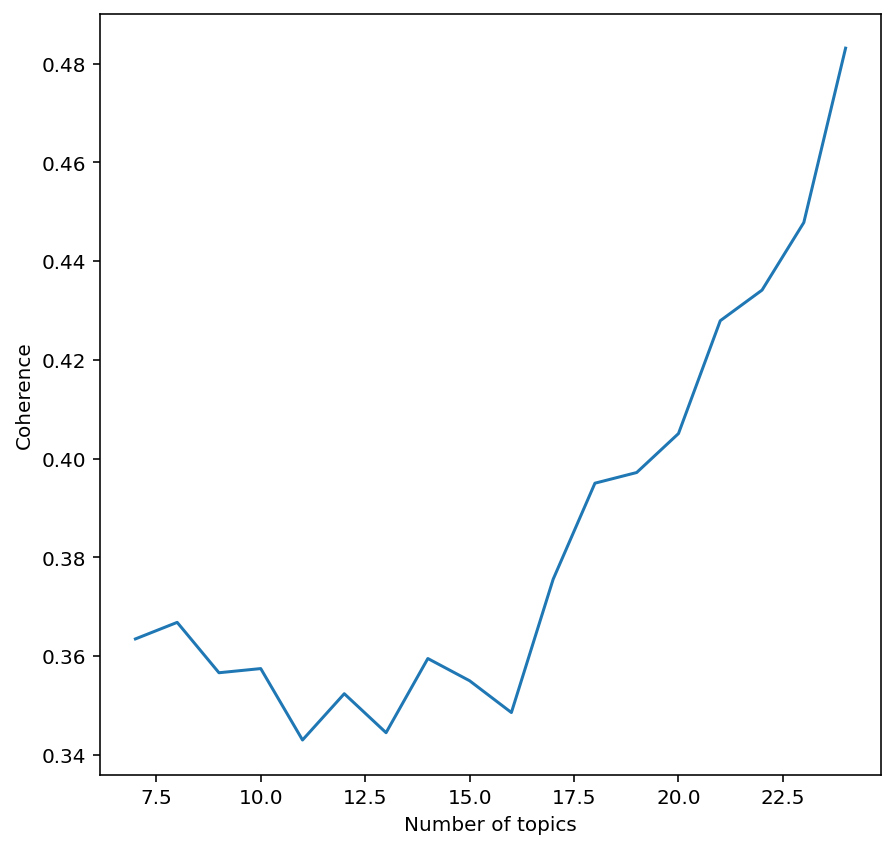

There should be 24 topics and this gives a coherence score for the model of 0.48313909325658316


In [155]:
# agg. movie dialogue
dialogue_per_movie = df_all.dropna(subset=['dialog']).groupby(['movie_number'], as_index = False).agg({'dialog': ' '.join})
# convert to dict
movie_scripts = dict(zip(dialogue_per_movie.movie_number, dialogue_per_movie.dialog))

# clean movie scripts
k = 1000
clean_movie_scripts = text_cleaning(movie_scripts, names_lower)
clean_movie_scripts = remove_most_common_words(k, clean_movie_scripts)

# dictionary
id2word_movies = Dictionary(clean_movie_scripts)

# corpus
corpus_movies = [id2word_movies.doc2bow(doc) for doc in clean_movie_scripts]
    
# define the number of topics range
no_topics = np.arange(7, 25)

# get optimal number of topics and values for lda
n_topic_movies = get_lda(clean_movie_scripts, id2word_movies, corpus_movies, no_topics, alpha = 8)

It can be seen that the optimal number of topics is 24, which gives a coherence score of 0.48. This is not a too bad score, of course it still suggests that there are some topics and patterns in the text which the model cannot distinguish between.

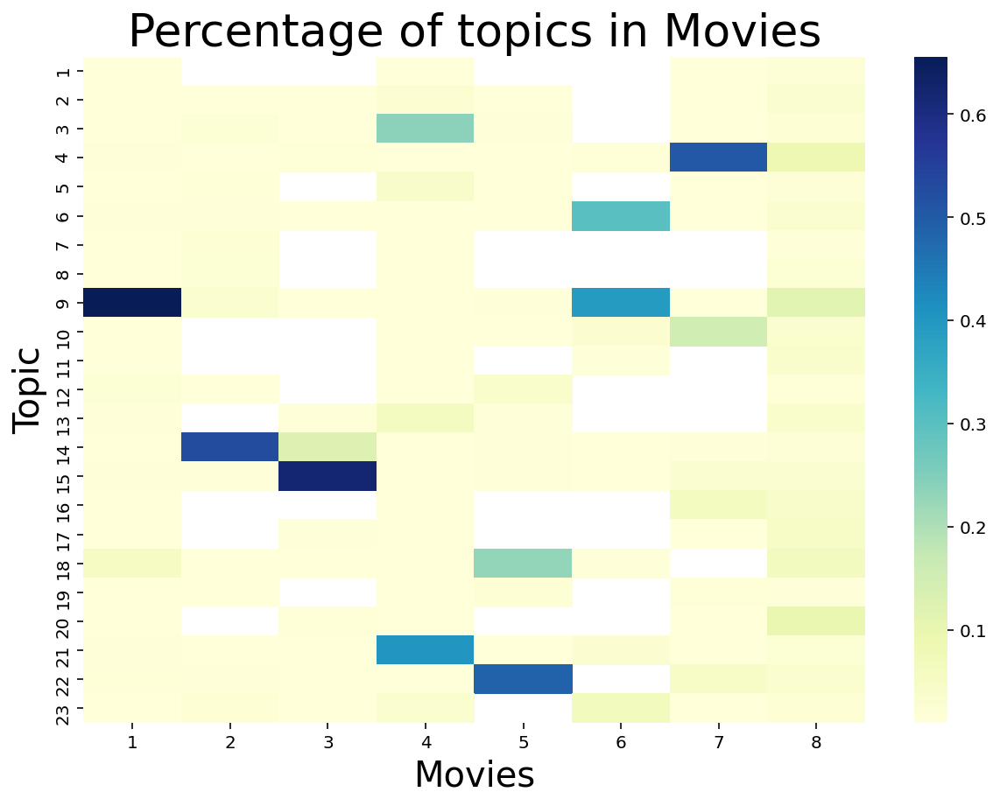

In [156]:
# define lda
lda_opt_movies = gensim.models.LdaModel(corpus_movies, 
                                 id2word = id2word_movies, 
                                 alpha = 8,
                                 eta = 'auto',
                                 num_topics = n_topic_movies, 
                                 chunksize = 100, 
                                 passes = 20)

# plot the percentage of topic #n in document #m
doc_topics_movies = get_doc_topics(lda_opt_movies, corpus_movies, n_topic_movies, "Movies")

The heatmap above shows that each movie consists of at least one topic. For the movies with multiple topics it can be seen that there is still is one major topic which is more important than the others, and then minor side topics. This could indicate that the model finds the main topic in the movie (Harry Potters main quest), but also identifies the smaller sidestories in the movies.  

In [157]:
# interactive visualisation of topics 
vis = pyLDAvis.gensim_models.prepare(lda_opt_movies, corpus_movies, id2word_movies)
# pyvis does not display LDA if offline we therefore use python iFrame to display the LDA
#vis

In [158]:
# save as html (has already been saved) 
#pyLDAvis.save_html(vis, 'Data_files/Topic modelling/lda_movies.html')

#display
display(IFrame('Data_files/Topic modelling/lda_movies.html', 900,1000))

In the plot above each bubble represents a topic. The larger the bubble, the higher percentage of the number of documents in the corpus is about that topic. Exploring topic 7, the words: thestral, defend, protego, headquarters etc. can be seen. These words are all very characteristic of the movie <i>Harry Potter and the Order of the Phoenix</i>. 

The further the bubbles are away from each other, the more different they are, which indicates that there are some topics which are very different, but there are also some topics which overlap and are quite similar. As some of the same themes are appearing in all movies, it is not expected that topics would not overlap.  

OBS: The pyLDAvis interactive plot enumerates the topics according to size, and the topic name in the heatmap and graph below are according to topic number given by the LDA model. 

#### Create network

A graph is created connecting topics and movies/ books. The functions used for doing this are defined below. 

In [159]:
# get node and edge colours
def get_colours(G):
    '''
    This function colours the nodes according to whether it is a movie/book or a topic
    Input: networkx graph
    Output: dictionaries with node colour
    '''
    node_att = {}
    # define node colour
    for u in list(G.nodes()):
        if ("Movie" in u) | ("Book" in u): 
            node_col = "plum"
        else:
            node_col = 'teal'
        
        node_att[u] = {'color': node_col}  
    
    # Set edge colors
    edge_color = {edge:'lightgrey' for edge in G.edges}

    return node_att, edge_color

In [160]:
def get_network_topic_documents(lda, n, doc_topics, _type, script_names):
    '''
    This function creates the links between topics and movies/book and assignes node and edge attributes
    Input: LDA, number of topics, dataframe percentage of topic #n in document #m, movie/book titles
    Output: network graph G with books/movies and topics as nodes and connections as edges
            edge weight shows the importance of topic #n for document #m 
    '''
    # create network of topic and words
    topics_att = {}
    for idx, topic in lda.show_topics(n, formatted=False, num_words= 10):
        #topics_att[f"Topic {idx+1}"] = {'Words': ", ".join([w[0] for w in topic])}
        topics_att[f"Topic {idx+1}"] = ", ".join([w[0] for w in topic])
        
    # get edges
    if _type == 'movie':
        node_name = 'Movie'
    else:
        node_name = 'Book'
    lda_topics_links = {f"{node_name} {k}": [f"Topic {topic+1}" for topic in v.keys()] for k, v in doc_topics.items() } 
    # get edge attributes
    lda_topics_att = {(f"{node_name} {k}", f"Topic {topic+1}"): weight*10 for k, v in doc_topics.items() \
                           for topic, weight in v.items()} 

    # get node attribute
    names_att = {f"{node_name} {k}": script_names[k-1] for k in doc_topics.keys()}
    
    # add nodes and edges from dictionary 
    G = nx.Graph(lda_topics_links)

    # add node attributes
    nx.set_node_attributes(G, topics_att, 'words')

    # add node attributes
    nx.set_node_attributes(G, names_att, _type)

    # add edge attribute
    nx.set_edge_attributes(G, lda_topics_att, "width")
    
    # set edge and node colours
    node_att, edge_color = get_colours(G)
    nx.set_node_attributes(G, node_att)
    nx.set_edge_attributes(G, edge_color, "color")
    
    # set title for hovering
    titles = {}

    for name, data in G.nodes(data = True):
        if "Topic" in name:
            title = '<b>Words: </b>' + data['words'][0:int(np.round(len(data['words'])/2))] + \
                    '</br> ' + data['words'][int(np.round(len(data['words'])/2)):]
            titles[name] = title
        else:
            title = '<b>Title: </b>' + data[_type]
            titles[name] = title
    nx.set_node_attributes(G, titles, 'title')
    
    return G

In [161]:
def plot_graph_topics(G, _type):
    '''
    This function displays the network as an interactive graph
    Input: networkx graph
    Output: interactive plot 
    '''

    nt = Network(notebook = True,
            height='600px',
            width='100%', 
            bgcolor='white',     
            font_color='black',
            heading='Topics for the Harry Potter {}'.format(_type)
            )
    # assign networkx graph G to the nt object
    nt.from_nx(G)
    nt.force_atlas_2based(overlap = 0.5,
                         gravity = -100, 
                         central_gravity = 0.01,
                         damping = 1)
    
    return nt

In [162]:
# create and plot network
G = get_network_topic_documents(lda_opt_movies, n_topic_movies, doc_topics_movies, 'movie', movie_names)

nt = plot_graph_topics(G, "Movies")
# pyvis does not display graphs if offline we therefore use python iFrame to display the graph
#nt.show('G.html')

In [163]:
# save (has already been saved)
#nt.save_graph('Data_files/Topic modelling/G_topic_movies.html')

In [164]:
# display
display(IFrame('Data_files/Topic modelling/G_topic_movies.html', 600,650))

Each topic and each movie is a node. The pink nodes are the movies, and the teal nodes are the topics. There is an edge between a topic and a movie if the topic is in the movie. The width of the edge is dependent on how important the topic is for the given movie. As it is an interactive graph it is possible to hover the curser over the topic nodes to see the 10 most important words in the topic. 

It can be seen that topic 15 is very important for movie 6. Topic 21 contains: <i>confringo, fighting</i> and <i>passage</i>. <i>Confringo</i> is the blasting curse, which is used in movie 6, and <i>fighting, passage </i> refers to the end of the movie where a fight occurs at Hogwarts and the Death Eaters have found a secret passage into the castle. 

The most important topic for movie 5 is topic 10. When hovering the curser over the topic 10, it can be seen that the most meaningful words are <i>inquistor, army, furious</i> and <i>hated</i>. These are all important words for the 5. Harry Potter movie and they are keywords in some of the sidestories in the movie. 

#### LDA for the Harry Potter books 

At first the books are cleaned using the `text_cleaning` function. Then the dictionary, corpus and the optimal number of topics are found by applying the function `get_dictionary_n_corpus_books`. This function is applied as it will add bigrams and trigrams to the corpus. It is hereafter possible to use the LDA model to find the topics in the text.

C:\Users\Johan\anaconda3\lib\site-packages\gensim\models\phrases.py:494: UserWarning:

For a faster implementation, use the gensim.models.phrases.Phraser class



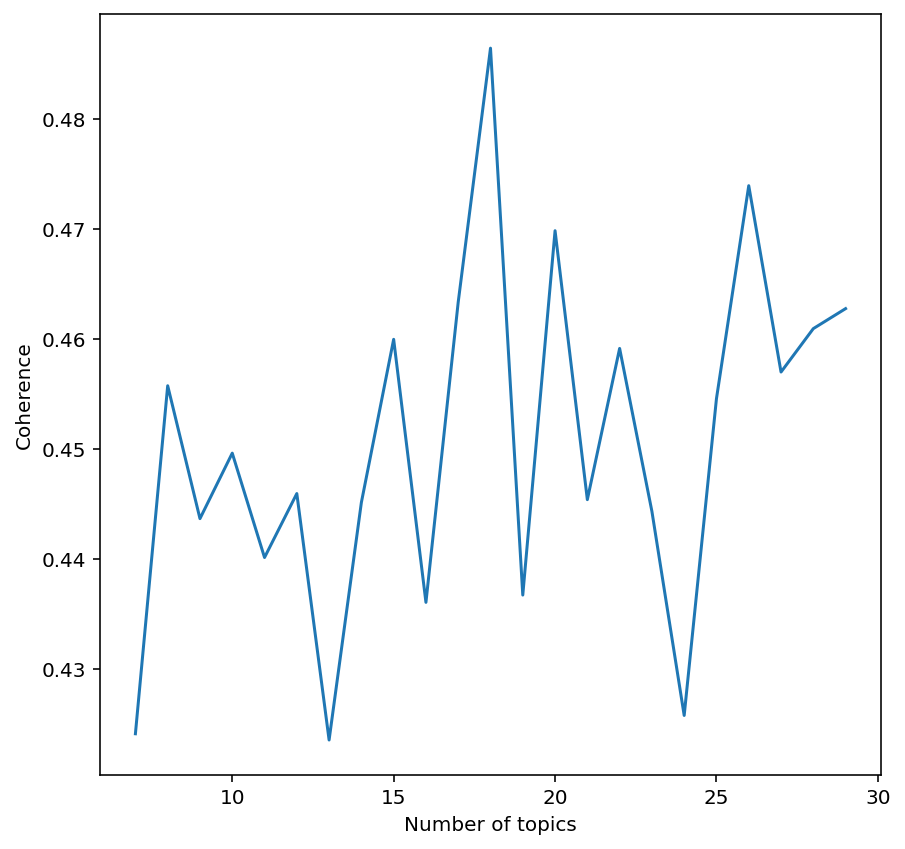

There should be 18 topics and this gives a coherence score for the model of 0.4864072983828287


In [174]:
# agg. book text
book_scripts = {book: " ".join(list(itertools.chain(*script.values()))) for book, script in books_all.items()}

# clean scripts
clean_scripts_books = text_cleaning(book_scripts, names_lower)

# get the script with bi- and trigrams, dictionary and corpus
clean_scripts_books, id2word_books, corpus_books = get_dictionary_n_corpus_books(clean_scripts_books)

# define the number of topics range
no_topics = np.arange(7, 30)

# get optimal number of topics and values for lda
n_topic_books = get_lda(clean_scripts_books, id2word_books, corpus_books, no_topics, alpha = 8)

It can be seen that the optimal number of topics is 18, which gives a coherence score of 0.48. This suggests that the model finds fairly okay quality topics. However, it still suggests that there are some topics which the model does not detect. This might suggest that some hyperparameter should be tuned. We began tuning the numer of topics, alpha and eta, but due to the size of the corpus this would take approximately 9 hours, and we therefore terminated the experiment. 

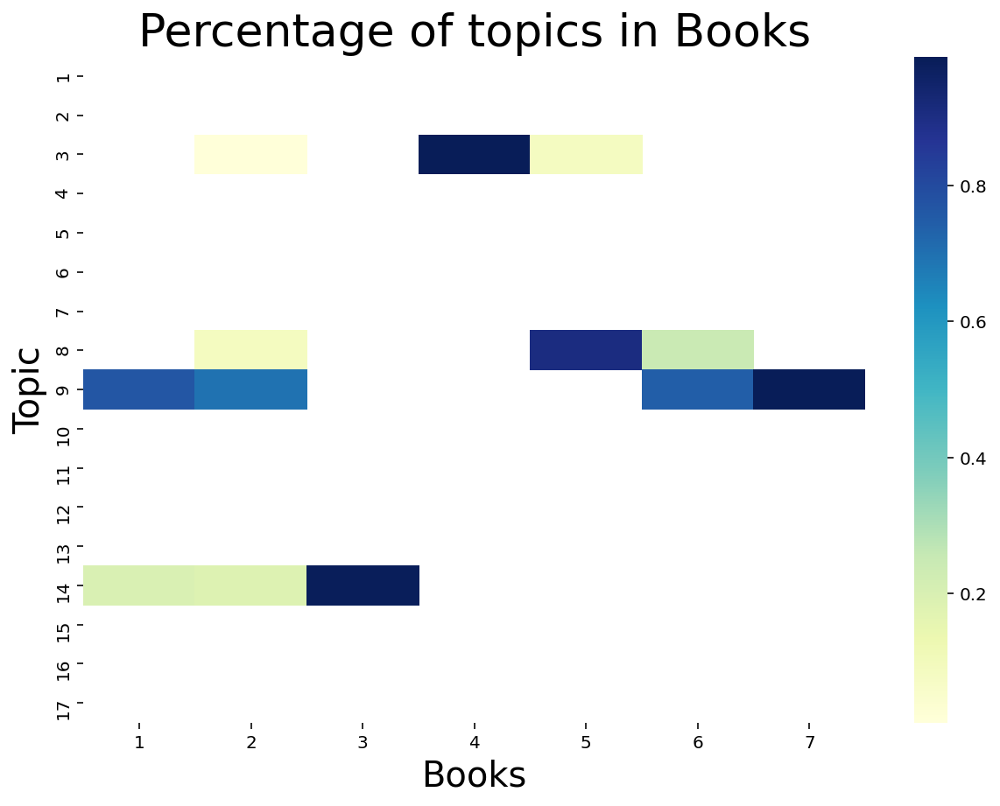

In [175]:
# define LDA
lda_opt_books = gensim.models.LdaModel(corpus_books, 
                                 id2word = id2word_books, 
                                 alpha = 8,
                                 eta = 'auto',
                                 num_topics = n_topic_books, 
                                 chunksize = 100, 
                                 passes = 20)

# plot the percentage of topic #n in document #m
doc_topics_books = get_doc_topics(lda_opt_books, corpus_books, n_topic_books, "Books") 

The heatmap above shows that each book consists of mainly one topic. It can be seen that the books are made up of fewer topics than the the movies were. The books mainly consist of one major topic and only three books have a smaller sidestory. There are quite a few topics which are not in any books, which is undesirable. 

In [176]:
# interactive visualisation of topics 
vis = pyLDAvis.gensim_models.prepare(lda_opt_books, corpus_books, id2word_books)
#vis

In [181]:
# save as html (has already been saved)
#pyLDAvis.save_html(vis, 'Data_files/Topic modelling/lda_books.html')

#display
display(IFrame('Data_files/Topic modelling/lda_books.html', 1000, 1000))

When examining the plot above it can be seen that there are 5 larger topics and the rest of the topics are small and clustered on top of each other, which indicates that they are not very insightful. However, when examining the larger topics they are quite meaningful and contain words such as:
* godrics_hollow
* horcrux
* locket 
* tent
* grimmauld_place
* killing_curse

which are characteristics for the book <i> Harry Potter and the Deathly Hallows </i>. 

In [178]:
# create and plot network
G = get_network_topic_documents(lda_opt_books, n_topic_books, doc_topics_books, 'book', list(books_all.keys()))

nt = plot_graph_topics(G, "Books")
# pyvis does not display graphs if offline we therefore use python iFrame to display the graph
# nt.show('G.html')

In [179]:
# save(has already been saved)
#nt.save_graph('Data_files/Topic modelling/G_topic_books.html')

In [180]:
# display
display(IFrame('Data_files/Topic modelling/G_topic_books.html', 600,650))

Each topic is a teal node and each book is a pink node. As for the movies, there is an edge if a topic is in a book, and the width of the edge is dependent on how important the topic is for the given book. 
It can be seen that topic 10 is shared by book 1, 2, 6 and 7, however this topic is more important for book 7 than for the others (indicated by the thinner edge). The topic includes words such as <i> horcrux, Godricks hollow, locket </i> which mainly refers to book 7 along with words such as: <i>room-requirement</i> and <i>half-blood</i> which can refer to other books as well. 

#### Comparison of topics found for the movies vs. the books

The topic modelling for the movies yielded some interesting topics which were quite descriptive of the movies. The model identified 24 topics, which were all represented in one of more movies. Some topics were mainly represented in one movie as the movie's main story, where other topics treated smaller sidestories and were therefore present in many movies.  

On the contrary, the topic modelling for the books ended up finding topics which were not represented in any of the seven books. When visualising the heatmap and the graph, it could be seen that only 4 out of the 18 topics were connected to the books. However, the few topics were very informative, but it would have been preferred that there was at least one topic per books. This could perhaps have been achieved by tuning the hyperparameters $\alpha$ and $\eta$ and not just the number of topics $n$.     

## 4. Discussion <a class="anchor" id="discussion"></a>

**Issues/ limitations**

When working with the text extracted from the Harry Potter fandom wiki we encountered some issues when conducting our text analysis. As we initially wanted to examine the Whole Wizarding world, we had extracted text for all characters (both in the Harry Potter universe, the Fantastic Beast universe as well as the Harry Potter games). However, as there are few pages for characters with an American school house, the TC-IDF would enhance words in these pages as well as give a higher weight to words that appear often in the relation to the Hogwart's houses, but seldomly appear in relation to the American houses. For instance the word *year* is metioned quite often for the Hogwart's houses as they are reffering to *first year, second year etc.*, however this word does not appear much for the American houses, and *year* would therefore become a large word in the wordclouds. It could have been a possibility to create seperate corpora for Hogwart's and American houses.  

Some limitations and issues were met when conducting the sentiment analysis. The dialogue found for the eight movies contained most of the dialogue for the movies, however it was discovered that for the last movie (<i> Harry Potter and the Deathly Hallows Part 2</i>) there were missing dialogue for Minerva McGonagall, Albus Dumbledore, Rubeus Hagrid as well as other missing dialogues for some of the other characters. This has an impact on the calculated sentiment scores both chapter-based as well as character-based, and the sentiment analysis for the movies is therefore not 100% representative. However, the missing dialogue makes up a small proportion of the total data, and the sentiment analysis for the movies can therefore still give a reasonably accurate representation of the sentiment in the movies. This also became clear from the analysis as it yielded interesting results. 

The character-based sentiment analysis was limited to the top 10 most connected characters in the Wizarding World. This was done as the process of extracting all text concerning a character involved a lot of manual work as the search had to include all known names and nicknames for a character. It could be argued that a sentiment score could be calculated for all characters if only using their first and lastname as search keys. 

**What went well?**

Despite the above mentioned issues and limitations the project still yielded interesting results. The wordclouds captured some very meaningful words for escpecially the houses and species. The Slytherin wordcloud displayed words such as *mudblood* and *bloodline* supporting the stereotypical image of Slytherins, that they are indeed prejudiced and arrogant. Furthermore, the wordclouds for species for instance *human* and *goblin* also display distinct characterstics such as *wand* and *charm* for humans and *sword* and *bank* for goblins.

Furthermore, we acieved some interesting results from the sentiment analysis. Through the sentiment analysis we were able to clearly distinguish between high and lows in the movies/ books, and the peaks corresponded accurately to happy/ sad moments in the story. We were also able to learn that the first four books all ended on a happy note where Harry potter and his friends had overcome the obstacle which they were facing, whereas the later books have a more gloomy ending, and it is clear that the scene is being set for the big war.  

We discovered the dataset for the Harry Potter books after we had handed in Project A, and this allowed us to expand our analysis to include an analysis of the books and a comparison of the books vs. the movies. As Harry Potter fans it was quite interesting to compare the results of the books to those of the movies, as it is quite clear that Hollywood took the liberty of adjusting some scenes and amplifying the emotional impact. 

**What could be improved?**

The initial idea was to analyse the whole wizarding world universe, including the side stories and movies outside the Harry Potter universe. However, due to the popularity of the Harry Potter books and movies, the data was easier available and of better quality for these books and movies. It was not possible to e.g. obtain datasets for the fantastic beasts books or movie-dialogue like Harry Potter, so this limited what analysis could be done. It was therefore not as easy to compare the different stories as the amount and level of detail for the data was very different.  

## 5. Contributions <a class="anchor" id="contributions"></a>

The project was created in collaboration and all three group members have contributed to the project. A table of the main responsible person/persons for all parts of the project can be seen below. Some parts were done together such as scrapping the data from the wikipage and cleaning it to ensure that everyone had the correct data to work with for the other parts of the project. 

|        |  Cecilia  |  Johan  |  Siv | 
|--------|------------|------------|------------|
| **Scrapping data** | x  |  x   |  x | 
| **Data cleaning** |    x |   x  |   x   |  
| **Basics statistics** |    |  x  |   x  |
| **Network statistics** |   |    |  x   | 
| **Network analysis** |      | x   |    | 
| **Community detection** |   x   |    | x  | 
| **Collecting and cleaning text data** | x   | x   | x     | 
| **Sentiment analysis** | x     |   |   | 
| **Topic modelling** | x     |  x   |    | 
| **Explainer notebook** | x  | x   | x  | 
| **Explainer notebook layout** | x  |   | x  | 
| **Website set-up** | x   | x  | x  | 